# Exploratory Data Analysis on Russian Election 2024 Dataset & Prediction with Machine Learning

Dataset Description:

This dataset comprises the results of a nationwide presidential election poll conducted on March 4, 2024. The data offers various insights but does not align with the official election results. You are encouraged to create your notebooks and delve into the data for further exploration.

Objectives:
1. Understanding the Type and Structure Data
2. Exploratory Data Analysis (EDA)
3. Machine Learning Model Building, Training and Evaluation

Workflow:

The Workflow followed in this project is as follows:

1. Import Libraries: Required Libraries for Exploratory Data Analysis and Machine Learning are included.
2. Loading of Data: To perform this, firstly, the Dataset is uploaded and printed. Also, the top 10 records, the last 10 records and a random sample of 10 records have also been printed, just to check the consistency of the dataset.
3. Data Preprocessing: Check for Null values and Duplicated Values in the dataset and drop the Duplicated Values.
4. Statistical Summary of the Dataset: A statistical overview which displays the Column names; Data Types; Number of Entries; Memory Usage; Count, Maximum, Minimum Values of the Dataset; Mean, Median, First Quartile, Third Quartile and Standard Deviation of the Dataset, etc..
5. Data Visualization: Both Univariate and Bivariate Analysis have been done. Bar Graphs, Line Charts, Heatmaps, Catplot, Scatter Plots, Histograms, Distribution Plots, Pie Charts, Horizontal Bar Plots, are some of the Plot Types that has been used in this project for visualizing the required data.
6. Data Encoding: Data has been encoded for the Categorical Columns as well as correctly labelled for the Numerical Columns, so as to prepare the data for Machine Learning Model Training, Building and Evaluation purposes.
8. Machine Learning: The Data has been split into Train and Test Sets and then Machine Learning Models have been built, trained and evaluated. In this project, 9 types of ML Models have been built, namely - Random Forest Classifier, Logistic Regression, Linear Regression, Decision Tree Classifier, AdaBoost Classifier, Gradient Boosting Classifier, XGBoost Classifier, K Nearest Neighbor (KNN), Support Vector Classifier (SVC) and Gaussian Naive Bayes.
9. Comparison of Machine Learning Models: The ML Models have been compared with a statistical perspective so as to select the best model. Hyperparameter Tuning has also been done to increase the efficiency of the models. Finally, 2 ML Models have been trained (1 selected from the comparative analysis and the another one is an Ensemble Model).
10. Feature Importance: Finally, this step has been performed so as to learn about the most important feature of the dataset, affecting the result.


# Import Libraries

In [144]:
# Import Libraries

# Libraries for Data Analysis
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Libraries for Machine Learning
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
import xgboost as xgb
from sklearn.ensemble import AdaBoostClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import VotingClassifier
from sklearn.inspection import permutation_importance
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import classification_report

# Library to maintain Clear Outputs
import warnings
warnings. filterwarnings ("ignore")

Cell 1 - Insights:
1. This cell imports various libraries for data manipulation, visualization, and machine learning model building.
2. Warnings library is also imported so as to suppress any warnings and maintain a clear output.

# Loading of Data

In [26]:
# Load the Dataset
df = pd.read_csv("election2024.csv")

# Print the Dataset
df

,id,sex,age,federal_district,type_of_city,knows_election_date,will_vote,candidate,television_usage,internet_usage,education,income,employment,job_type,company_type,weight1
0,07169ed8148ce047,male,18.0,north caucasian,village,named correct date,not sure,Putin,several times a week,over 4 hours a day,incomplete school education,very high,entrepreneur,NaN,farming,1.445172
1,0716a4f3354cecdd,male,23.0,north caucasian,village,named correct date,not sure,Putin,once half a year,over 4 hours a day,college,very high,work for hire,commercial organization,trade,1.445172
2,0716889b304ce79c,male,20.0,volga,city with population of less than 50k,named correct date,definitely yes,Putin,several times a week,over 4 hours a day,college,very high,work for hire,law enforcement agency,law enforcement agency,1.301691
3,07168e28b5cce563,male,22.0,northwestern,city with population of 1 million and higher,not sure or no answer,not sure,Davankov,several times a week,over 4 hours a day,college,very high,unemployed,NaN,NaN,1.538628
4,0716a563914ce549,male,21.0,southern,city with population of 1 million and higher,named correct date,definitely yes,Putin,does not watch,over 4 hours a day,bachelor degree,very high,employed student,commercial organization,"tech, programming, communications",1.967015
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1595,0716b23c2c0cee3a,male,61.0,central,settlement,named correct date,definitely no,will not take part,over 4 hours a day,less than 4 hours a day,bachelor degree,hard to say,unemployed pensioner,NaN,NaN,1.270761
1596,07168254d14ceb55,female,80.0,volga,village,named correct date,likely yes,struggle to answer,several times a week,does not use internet,college,hard to say,unemployed pensioner,NaN,NaN,0.921724
1597,071690f34d4ce164,female,76.0,northwestern,city with population of 50-100k,named correct date,definitely yes,Putin,does not watch,over 4 hours a day,bachelor degree,hard to say,unemployed pensioner,NaN,NaN,1.396691
1598,0716bfa9c48ce79a,female,74.0,central,city with population of less than 50k,not sure or no answer,definitely yes,Putin,over 4 hours a day,over 4 hours a day,academic degree,hard to say,employed pensioner,commercial organization,"industry, manufacturing",0.995849


Cell 2 - Insights:
1. The entire dataset is successfully loaded into a Pandas DataFrame and printed.
2. It is useful to visualize the structure and content of the dataset to understand its columns and values.

In [27]:
# Printing the 1st 10 Entries of the Dataset
df.head(10)

,id,sex,age,federal_district,type_of_city,knows_election_date,will_vote,candidate,television_usage,internet_usage,education,income,employment,job_type,company_type,weight1
0,07169ed8148ce047,male,18.0,north caucasian,village,named correct date,not sure,Putin,several times a week,over 4 hours a day,incomplete school education,very high,entrepreneur,NaN,farming,1.445172
1,0716a4f3354cecdd,male,23.0,north caucasian,village,named correct date,not sure,Putin,once half a year,over 4 hours a day,college,very high,work for hire,commercial organization,trade,1.445172
2,0716889b304ce79c,male,20.0,volga,city with population of less than 50k,named correct date,definitely yes,Putin,several times a week,over 4 hours a day,college,very high,work for hire,law enforcement agency,law enforcement agency,1.301691
3,07168e28b5cce563,male,22.0,northwestern,city with population of 1 million and higher,not sure or no answer,not sure,Davankov,several times a week,over 4 hours a day,college,very high,unemployed,NaN,NaN,1.538628
4,0716a563914ce549,male,21.0,southern,city with population of 1 million and higher,named correct date,definitely yes,Putin,does not watch,over 4 hours a day,bachelor degree,very high,employed student,commercial organization,"tech, programming, communications",1.967015
5,0716aac995cce5ae,male,27.0,southern,city with population of 1 million and higher,named correct date,not sure,Putin,does not watch,less than 4 hours a day,incomplete school education,very high,work for hire,commercial organization,refused to answer,1.127558
6,07169cf9604cee1c,male,37.0,northwestern,city with population of less than 50k,named correct date,definitely yes,Putin,once half a year,several times a week,school,very high,work for hire,commercial organization,"industry, manufacturing",0.579384
7,07168daf680ceff8,male,43.0,southern,city with population of 50-100k,named correct date,definitely yes,Putin,does not watch,less than 4 hours a day,college,very high,self-employed,NaN,other,0.662259
8,0716aa97fe4ce46d,male,39.0,northwestern,city with population of 100-500k,wrong answer,definitely yes,Putin,does not watch,over 4 hours a day,college,very high,unemployed pensioner,NaN,NaN,0.468226
9,0716921d124ce8cd,male,36.0,central,city with population of 1 million and higher,not sure or no answer,likely no,Putin,less than 4 hours a day,over 4 hours a day,bachelor degree,very high,entrepreneur,NaN,housing and communal services,1.111258


Cell 3 - Insights:
1. The output displays the first 10 rows of the dataset.
2. Provides a quick overview of the initial entries in the dataset.
3. Useful to check the beginning part of the dataset for any anomalies or inconsistencies.

In [28]:
# Printing the Last 10 Entries of the Dataset
df.tail(10)

,id,sex,age,federal_district,type_of_city,knows_election_date,will_vote,candidate,television_usage,internet_usage,education,income,employment,job_type,company_type,weight1
1590,071690e53c4cee54,female,48.0,central,city with population of 1 million and higher,named correct date,likely yes,Putin,does not watch,less than 4 hours a day,bachelor degree,hard to say,work for hire,commercial organization,"industry, manufacturing",1.530761
1591,0716844ebb8ceafc,male,51.0,volga,city with population of 500-950k,named correct date,definitely yes,Putin,does not watch,does not use internet,college,hard to say,unemployed pensioner,NaN,NaN,0.601133
1592,07165e998d0cee20,female,28.0,siberian,city with population of 1 million and higher,named correct date,definitely yes,struggle to answer,over 4 hours a day,over 4 hours a day,college,hard to say,parental leave,NaN,NaN,1.484671
1593,07166682350ce1b0,female,57.0,siberian,village,named correct date,not sure,Putin,less than 4 hours a day,does not use internet,incomplete school education,hard to say,unemployed,NaN,NaN,1.150001
1594,0716b6e9840ceeec,male,51.0,north caucasian,city with population of 500-950k,named correct date,likely yes,Putin,several times a week,several times a week,bachelor degree,hard to say,unemployed,NaN,NaN,0.928472
1595,0716b23c2c0cee3a,male,61.0,central,settlement,named correct date,definitely no,will not take part,over 4 hours a day,less than 4 hours a day,bachelor degree,hard to say,unemployed pensioner,NaN,NaN,1.270761
1596,07168254d14ceb55,female,80.0,volga,village,named correct date,likely yes,struggle to answer,several times a week,does not use internet,college,hard to say,unemployed pensioner,NaN,NaN,0.921724
1597,071690f34d4ce164,female,76.0,northwestern,city with population of 50-100k,named correct date,definitely yes,Putin,does not watch,over 4 hours a day,bachelor degree,hard to say,unemployed pensioner,NaN,NaN,1.396691
1598,0716bfa9c48ce79a,female,74.0,central,city with population of less than 50k,not sure or no answer,definitely yes,Putin,over 4 hours a day,over 4 hours a day,academic degree,hard to say,employed pensioner,commercial organization,"industry, manufacturing",0.995849
1599,07168088318cef88,female,76.0,ural,village,named correct date,definitely yes,Putin,over 4 hours a day,over 4 hours a day,school,hard to say,unemployed pensioner,NaN,NaN,0.860836


Cell 4 - Insights:
1. The last 10 rows of the dataset is shown as an output.
2. Offers a look at the end of the dataset, ensuring it is loaded correctly and consistently.

In [29]:
# Printing any random 10 Entries of the Dataset
df.sample(10)

,id,sex,age,federal_district,type_of_city,knows_election_date,will_vote,candidate,television_usage,internet_usage,education,income,employment,job_type,company_type,weight1
941,0716867385cce96b,female,55.0,north caucasian,city with population of 100-500k,named correct date,definitely yes,Putin,over 4 hours a day,less than 4 hours a day,college,medium,self-employed,NaN,"catering, restaurants",0.768610
362,07166884320ce830,female,43.0,siberian,city with population of 100-500k,named correct date,definitely yes,Putin,less than 4 hours a day,less than 4 hours a day,bachelor degree,high,work for hire,government agency,healthcare,0.964813
610,0716a834a74ceab2,female,50.0,north caucasian,village,named correct date,definitely yes,Putin,less than 4 hours a day,less than 4 hours a day,bachelor degree,medium,unemployed,NaN,NaN,1.734387
1076,0716a27ca30ceeae,female,58.0,volga,city with population of less than 50k,named correct date,definitely yes,Putin,several times a week,several times a week,college,medium,work for hire,law enforcement agency,law enforcement agency,0.980791
945,0716839d3c0cefd0,female,73.0,volga,city with population of 100-500k,named correct date,definitely yes,Putin,does not watch,does not use internet,college,medium,unemployed pensioner,NaN,NaN,0.650607
1297,071676ae554ce957,female,65.0,ural,city with population of 100-500k,named correct date,likely yes,Kharitonov,less than 4 hours a day,less than 4 hours a day,college,medium,unemployed pensioner,NaN,NaN,0.607629
487,0716ba68810ced5e,male,25.0,north caucasian,city with population of 100-500k,named correct date,likely yes,Putin,several times a month,less than 4 hours a day,bachelor degree,medium,self-employed,NaN,"tech, programming, communications",1.366413
66,07168e69c38ce8ae,male,19.0,volga,city with population of 500-950k,not sure or no answer,likely no,Kharitonov,several times a week,over 4 hours a day,college,high,unemployed student,NaN,NaN,0.951607
881,0716a9148c4ce8f9,male,54.0,southern,city with population of 500-950k,not sure or no answer,definitely yes,Putin,less than 4 hours a day,less than 4 hours a day,college,medium,work for hire,government agency,housing and communal services,0.559132
71,0716b2fe3a8ce251,male,19.0,central,city with population of 1 million and higher,wrong answer,not sure,Slutskiy,does not watch,over 4 hours a day,incomplete school education,high,employed student,commercial organization,"catering, restaurants",1.380143


Cell 5 - Insights:
1. The output displays 10 random rows from the dataset.
2. Helps to get a random sample from the dataset to understand its variety and to spot-check data consistency.

# Data Preprocessing

In [30]:
# Shape of the Dataset
def dataset_shape(data):
    return data.shape

print(f"Shape of the dataset: {dataset_shape(df)}")

Shape of the dataset: (1600, 16)


Cell 6 - Insights:
1. The output shows the configuration of the given dataset, in the form of number of rows and number of columns present in the dataset.
2. Helpful for knowing the total number of entries in the dataset.

In [31]:
# Columns of the Dataset classified into Numerical Columns and Categorical Columns
def column_types(data):
    categorical_cols = data.select_dtypes(include=['object', 'category']).columns.tolist()
    numerical_cols = data.select_dtypes(include=['number']).columns.tolist()
    return categorical_cols, numerical_cols

categorical_cols, numerical_cols = column_types(df)
print(f"Categorical Columns:\n{categorical_cols}")
print(f"\nNumerical Columns:\n{numerical_cols}")

Categorical Columns:
['id', 'sex', 'federal_district', 'type_of_city', 'knows_election_date', 'will_vote', 'candidate', 'television_usage', 'internet_usage', 'education', 'income', 'employment', 'job_type', 'company_type']

Numerical Columns:
['age', 'weight1']


Cell 7 - Insights:
1. The output shows the names of columns present in the given dataset.
2. Provides a quick overview of the number of columns and data types of each column.

In [32]:
# Information about Dataset
def dataset_info(data):
    info = data.info()
    return info

info = dataset_info(df)
print(info)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1600 entries, 0 to 1599
Data columns (total 16 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   id                   1600 non-null   object 
 1   sex                  1600 non-null   object 
 2   age                  1600 non-null   float64
 3   federal_district     1600 non-null   object 
 4   type_of_city         1600 non-null   object 
 5   knows_election_date  1600 non-null   object 
 6   will_vote            1600 non-null   object 
 7   candidate            1600 non-null   object 
 8   television_usage     1600 non-null   object 
 9   internet_usage       1600 non-null   object 
 10  education            1600 non-null   object 
 11  income               1600 non-null   object 
 12  employment           1600 non-null   object 
 13  job_type             692 non-null    object 
 14  company_type         879 non-null    object 
 15  weight1              1600 non-null   f

Cell 8 - Insights:
1. The output shows information about the given dataset.
2. The information includes - the total number of entries, total number of columns, memory usage, column names and their corresponding data types and non-null count and also the total number of columns for each data type.
3. Such an analysis is really helpful for a quick overview of the dataset, before performing EDA.

In [33]:
# Description of the Dataset
def dataset_description(data):
    description = data.describe(include='all')
    return description

description = dataset_description(df)
description

,id,sex,age,federal_district,type_of_city,knows_election_date,will_vote,candidate,television_usage,internet_usage,education,income,employment,job_type,company_type,weight1
count,1600,1600,1600.000000,1600,1600,1600,1600,1600,1600,1600,1600,1600,1600,692,879,1600.000000
unique,1600,2,NaN,8,7,4,6,7,6,6,6,6,11,6,21,NaN
top,07169ed8148ce047,female,NaN,central,city with population of 100-500k,named correct date,definitely yes,Putin,less than 4 hours a day,less than 4 hours a day,college,medium,work for hire,commercial organization,"industry, manufacturing",NaN
freq,1,843,NaN,425,391,1361,1062,1128,490,613,690,949,535,445,138,NaN
mean,NaN,NaN,49.936250,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000
std,NaN,NaN,16.901797,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.327084
min,NaN,NaN,18.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.468226
25%,NaN,NaN,37.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.772224
50%,NaN,NaN,49.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.921724
75%,NaN,NaN,64.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.158913


Cell 9 - Insights:
1. Provides a statistical description of the dataset.
2. The statistical description of the dataset includes - Count, Mean Value, Standard Deviation, 1st Qaurtile (25%), Median Value (50%), 3rd Quartile (75%) and Maximum Value.
3. This statistical description is provided only for the Numerical Columns of the Dataset and not for the Categorical Columns.
4. Really helpful for understanding the dataset.

In [34]:
# Transposing the above Output
description.T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
id,1600,1600,07169ed8148ce047,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
sex,1600,2,female,843,NaN,NaN,NaN,NaN,NaN,NaN,NaN
age,1600.0,NaN,NaN,NaN,49.93625,16.901797,18.0,37.0,49.0,64.0,90.0
federal_district,1600,8,central,425,NaN,NaN,NaN,NaN,NaN,NaN,NaN
type_of_city,1600,7,city with population of 100-500k,391,NaN,NaN,NaN,NaN,NaN,NaN,NaN
knows_election_date,1600,4,named correct date,1361,NaN,NaN,NaN,NaN,NaN,NaN,NaN
will_vote,1600,6,definitely yes,1062,NaN,NaN,NaN,NaN,NaN,NaN,NaN
candidate,1600,7,Putin,1128,NaN,NaN,NaN,NaN,NaN,NaN,NaN
television_usage,1600,6,less than 4 hours a day,490,NaN,NaN,NaN,NaN,NaN,NaN,NaN
internet_usage,1600,6,less than 4 hours a day,613,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Cell 10 - Insights:
1. The statistical analysis has been displayed in a Transposed manner, as compared to the previous output, just to provide a clear and concise view.
2. Basically, there is no difference between the outputs of Cell 9 and Cell 10.

In [35]:
# Checking the Data Types of every Columns of the Dataset
df.dtypes

id                      object
sex                     object
age                    float64
federal_district        object
type_of_city            object
knows_election_date     object
will_vote               object
candidate               object
television_usage        object
internet_usage          object
education               object
income                  object
employment              object
job_type                object
company_type            object
weight1                float64
dtype: object

Cell 12 - Insights:
1. The output shows the data type for each column, present in the dataset.
2. Useful for quick overview of the data types and the knowing which data types are required for data encoding for ML purpose.
3. Provides a concise result, as compared to the output of Cell 8.

In [36]:
# Check for Duplicate Values and Treat Them
def remove_duplicates(data):
    initial_rows = data.shape[0]
    data = data.drop_duplicates()
    final_rows = data.shape[0]
    duplicates_removed = initial_rows - final_rows
    return data, duplicates_removed

df, duplicates_removed = remove_duplicates(df)
print(f"Number of duplicates removed: {duplicates_removed}")

Number of duplicates removed: 0


Cell 13 - Insights:
1. Check for Duplicate Values in the Dataset and drop them, so that the dataset is devoid of redundancy.
2. The code has been executed successfully.

In [37]:
# Check for Missing Values and Treat Them
def handle_missing_values(data):
    missing_values = data.isnull().sum()
    
    # Separate numerical and categorical columns
    numerical_cols = data.select_dtypes(include=['int64', 'float64']).columns
    categorical_cols = data.select_dtypes(exclude=['int64', 'float64']).columns
    
    # Fill numerical missing values with median
    data[numerical_cols] = data[numerical_cols].fillna(data[numerical_cols].median())
    
    # Fill categorical missing values with mode
    data[categorical_cols] = data[categorical_cols].fillna(data[categorical_cols].mode().iloc[0])
    
    return data, missing_values

df, missing_values = handle_missing_values(df)
print("Missing values per column:")
print(missing_values)

Missing values per column:
id                       0
sex                      0
age                      0
federal_district         0
type_of_city             0
knows_election_date      0
will_vote                0
candidate                0
television_usage         0
internet_usage           0
education                0
income                   0
employment               0
job_type               908
company_type           721
weight1                  0
dtype: int64


Cell 14 - Insights:
1. The code has run successfully.
2. Most of the columns are devoid of any null values.
3. Only 'job_type' and 'company_type' columns have a considerable number of null values - 908 and 721, respectively and that too when the number of records are 1600 in easch column.
4. So, it is better to drop them, as they will add redundancy to the dataset as well as the model.

In [38]:
# Dropping the Columns with Null Values after Missing Value Treatment
df = df.drop(columns=['job_type', 'company_type', 'id'])

Cell 15 - Insights:
1. The code has run successfully.
2. Both the required columns with considerable null values have been dropped successfully.
3. Moreover, the id column has also been dropped, as it will not be very much helpful in EDA and Model Building operations.

In [60]:
# Print the DataFrame
df

,sex,age,federal_district,type_of_city,knows_election_date,will_vote,candidate,television_usage,internet_usage,education,income,employment,weight1
0,male,18.0,north caucasian,village,named correct date,not sure,Putin,several times a week,over 4 hours a day,incomplete school education,very high,entrepreneur,1.445172
1,male,23.0,north caucasian,village,named correct date,not sure,Putin,once half a year,over 4 hours a day,college,very high,work for hire,1.445172
2,male,20.0,volga,city with population of less than 50k,named correct date,definitely yes,Putin,several times a week,over 4 hours a day,college,very high,work for hire,1.301691
3,male,22.0,northwestern,city with population of 1 million and higher,not sure or no answer,not sure,Davankov,several times a week,over 4 hours a day,college,very high,unemployed,1.538628
4,male,21.0,southern,city with population of 1 million and higher,named correct date,definitely yes,Putin,does not watch,over 4 hours a day,bachelor degree,very high,employed student,1.967015
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1595,male,61.0,central,settlement,named correct date,definitely no,will not take part,over 4 hours a day,less than 4 hours a day,bachelor degree,hard to say,unemployed pensioner,1.270761
1596,female,80.0,volga,village,named correct date,likely yes,struggle to answer,several times a week,does not use internet,college,hard to say,unemployed pensioner,0.921724
1597,female,76.0,northwestern,city with population of 50-100k,named correct date,definitely yes,Putin,does not watch,over 4 hours a day,bachelor degree,hard to say,unemployed pensioner,1.396691
1598,female,74.0,central,city with population of less than 50k,not sure or no answer,definitely yes,Putin,over 4 hours a day,over 4 hours a day,academic degree,hard to say,employed pensioner,0.995849


Cell 16 - Insights:
1. The DataFrame has been successfully printed after treating and dropping the null values and duplicate values.

In [61]:
# Shape of the Dataset
def dataset_shape(data):
    return data.shape

print(f"Shape of the dataset: {dataset_shape(df)}")

Shape of the dataset: (1600, 13)


Cell 17 - Insights:
1. The shape of the Dataset has been printed.
2. This output is similar to the output of Cell 6.
3. The shape of the Dataset is (1600, 13), representing that the treatment and dropping of duplicate and null values has been successful.

In [62]:
# Description of the Dataset
def dataset_description(data):
    description = data.describe(include='all')
    return description

description = dataset_description(df)
description

,sex,age,federal_district,type_of_city,knows_election_date,will_vote,candidate,television_usage,internet_usage,education,income,employment,weight1
count,1600,1600.000000,1600,1600,1600,1600,1600,1600,1600,1600,1600,1600,1600.000000
unique,2,NaN,8,7,4,6,7,6,6,6,6,11,NaN
top,female,NaN,central,city with population of 100-500k,named correct date,definitely yes,Putin,less than 4 hours a day,less than 4 hours a day,college,medium,work for hire,NaN
freq,843,NaN,425,391,1361,1062,1128,490,613,690,949,535,NaN
mean,NaN,49.936250,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.000000
std,NaN,16.901797,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.327084
min,NaN,18.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.468226
25%,NaN,37.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.772224
50%,NaN,49.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.921724
75%,NaN,64.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.158913


Cell 18 - Insights:
1. The description of the dataset has been visualized successfully.
2. Similar to the output of Cell 9.

In [63]:
# Transposing the above Output
description.T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
sex,1600,2,female,843,NaN,NaN,NaN,NaN,NaN,NaN,NaN
age,1600.0,NaN,NaN,NaN,49.93625,16.901797,18.0,37.0,49.0,64.0,90.0
federal_district,1600,8,central,425,NaN,NaN,NaN,NaN,NaN,NaN,NaN
type_of_city,1600,7,city with population of 100-500k,391,NaN,NaN,NaN,NaN,NaN,NaN,NaN
knows_election_date,1600,4,named correct date,1361,NaN,NaN,NaN,NaN,NaN,NaN,NaN
will_vote,1600,6,definitely yes,1062,NaN,NaN,NaN,NaN,NaN,NaN,NaN
candidate,1600,7,Putin,1128,NaN,NaN,NaN,NaN,NaN,NaN,NaN
television_usage,1600,6,less than 4 hours a day,490,NaN,NaN,NaN,NaN,NaN,NaN,NaN
internet_usage,1600,6,less than 4 hours a day,613,NaN,NaN,NaN,NaN,NaN,NaN,NaN
education,1600,6,college,690,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Cell 19 - Insights:
1. The statistical analysis has been displayed in a Transposed manner, as compared to the previous output, just to provide a clear and concise view.
2. Basically, there is no difference between the outputs of Cell 18 and Cell 19.
3. Similar to the output of Cell 10.

In [64]:
# Unique Value
def unique_values(data):
    unique_values = {col: data[col].unique() for col in data.columns}
    return unique_values

unique_values = unique_values(df)
unique_values

{'sex': array(['male', 'female'], dtype=object),
 'age': array([18., 23., 20., 22., 21., 27., 37., 43., 39., 36., 49., 60., 44.,
        61., 67., 29., 47., 32., 45., 35., 53., 71., 54., 55., 48., 66.,
        56., 68., 69., 33., 76., 77., 70., 86., 90., 75., 80., 24., 19.,
        25., 28., 31., 26., 30., 38., 40., 41., 52., 50., 51., 46., 63.,
        34., 42., 65., 73., 74., 72., 59., 57., 58., 78., 79., 62., 64.,
        82., 84., 85., 87., 83., 81.]),
 'federal_district': array(['north caucasian', 'volga', 'northwestern', 'southern', 'central',
        'ural', 'siberian', 'far eastern'], dtype=object),
 'type_of_city': array(['village', 'city with population of less than 50k',
        'city with population of 1 million and higher',
        'city with population of 50-100k',
        'city with population of 100-500k', 'settlement',
        'city with population of 500-950k'], dtype=object),
 'knows_election_date': array(['named correct date', 'not sure or no answer', 'wrong answer'

Cell 26 - Insights:
1. The unique values present in each column of the dataset is displayed as output, after data cleaning.

In [65]:
# Value Counts
def value_counts(data):
    value_counts = {col: data[col].value_counts() for col in data.columns}
    return value_counts

value_counts = value_counts(df)
value_counts

{'sex': sex
 female    843
 male      757
 Name: count, dtype: int64,
 'age': age
 40.0    46
 37.0    46
 45.0    45
 38.0    44
 39.0    39
         ..
 86.0     4
 85.0     4
 87.0     3
 81.0     3
 90.0     1
 Name: count, Length: 71, dtype: int64,
 'federal_district': federal_district
 central            425
 volga              324
 siberian           188
 southern           182
 northwestern       151
 ural               134
 north caucasian    107
 far eastern         89
 Name: count, dtype: int64,
 'type_of_city': type_of_city
 city with population of 100-500k                391
 village                                         366
 city with population of 1 million and higher    307
 city with population of less than 50k           179
 city with population of 500-950k                170
 city with population of 50-100k                 106
 settlement                                       81
 Name: count, dtype: int64,
 'knows_election_date': knows_election_date
 named correct 

Cell 21 - Insights:
1. Value Counts, i.e., frequency of each data with respect to each column of the dataset, after data cleaning, has been displayed.

# Data Visualization (Part - 1)

<Figure size 1200x800 with 0 Axes>

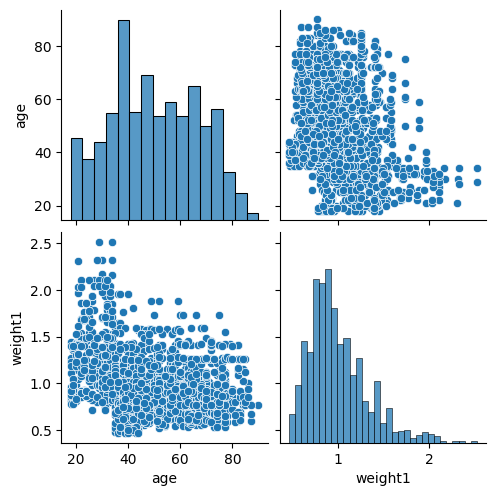

In [53]:
# Data Visualization - 1

# Visualize the Dataset using Pairplot for Numerical Data
plt.figure(figsize=(12,8))
sns.pairplot(df)

# Displaying the Plot
plt.show()

Cell 22 - Insights:
1. Diagonal Plots: The diagonal plots show the distribution of each variable, which can help identify skewness, outliers, or other distribution-related issues.
2. Off-Diagonal Plots: The off-diagonal plots show the relationship between two variables. Look for patterns such as correlations, non-linear relationships, or outliers.
3. Correlation: If the points in an off-diagonal plot are densely packed and follow a clear trend, it may indicate a strong correlation between the two variables.
4. Non-Linear Relationships: If the points in an off-diagonal plot show a non-linear pattern, it may indicate a more complex relationship between the two variables.

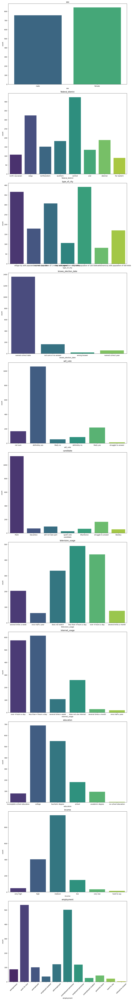

In [68]:
# Data Visualization - 2

# Visualize the Dataset using CountPlot for Categorical Data

# Get categorical columns
categorical_cols = df.select_dtypes(include=['object']).columns

# Create a figure with multiple subplots
fig, axes = plt.subplots(nrows=len(categorical_cols), ncols=1, figsize=(12, 8*len(categorical_cols)))

# Iterate over categorical columns and create a countplot for each
for i, col in enumerate(categorical_cols):
    sns.countplot(x=col, data=df, ax=axes[i], hue=col, palette='viridis')
    axes[i].set_title(col)

# Layout so plots do not overlap
fig.tight_layout()

# Rotate the x-label so that they do not overlap
plt.xticks(rotation=45)

# Display the plot
plt.show()

Cell 23 - Insights:
1. The code has been executed successfully.
2. All the required Countplots have been generated for Categorical Data.
3. From the Countplot of 'sex' column, it is evident that Females are in majority in the given dataset.
4. From the data of Federal District, it can be concluded that the highest population resides in Central, followed by Volga, while the least reside in Far Eastern.
5. The highest share of the population of this dataset, reside in Cities with population ranging between 100k to 500k.
6. Most of the voters knows the correct election date.
7. Most of them are going to vote definitely.
8. Most of them are going to vote for Putin.
9. The television usage ranges for less than 4 hours a day, for most of them.
10. Most of them have received college education, while only a miniscule population have never gone to school.
11. The population with medium income forms the majority.
12. Work for Hire is the most populated group, when the population is classified on the basis of employment.

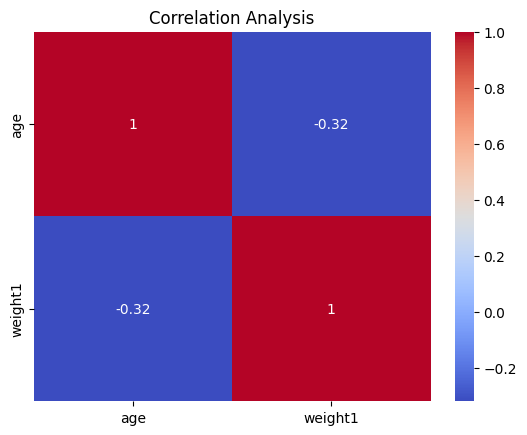

In [69]:
# Data Visualization - 3

# Visualization showing Correlation within Numerical Columns: Heatmap
def correlation_analysis(data, numerical_cols):
    correlation_matrix = data[numerical_cols].corr()
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
    plt.title("Correlation Analysis")
    plt.show()

correlation_analysis(df, numerical_cols)

Cell 24 - Insights:
1. The code has run successfully.
2. The required plot has been generated.
3. From the generated plot, it is evident that a negative correlation is being observed among the Numerical Columns, which suggests that they are not at all related.

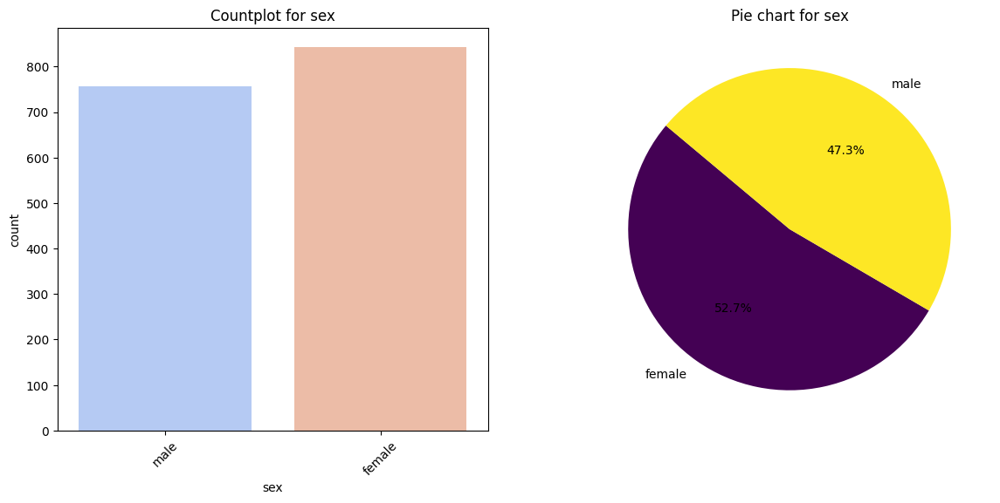

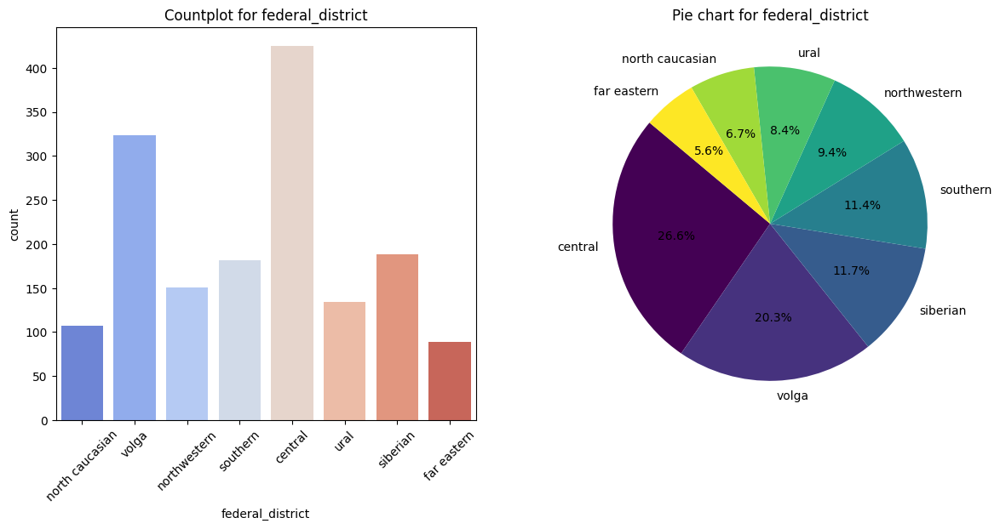

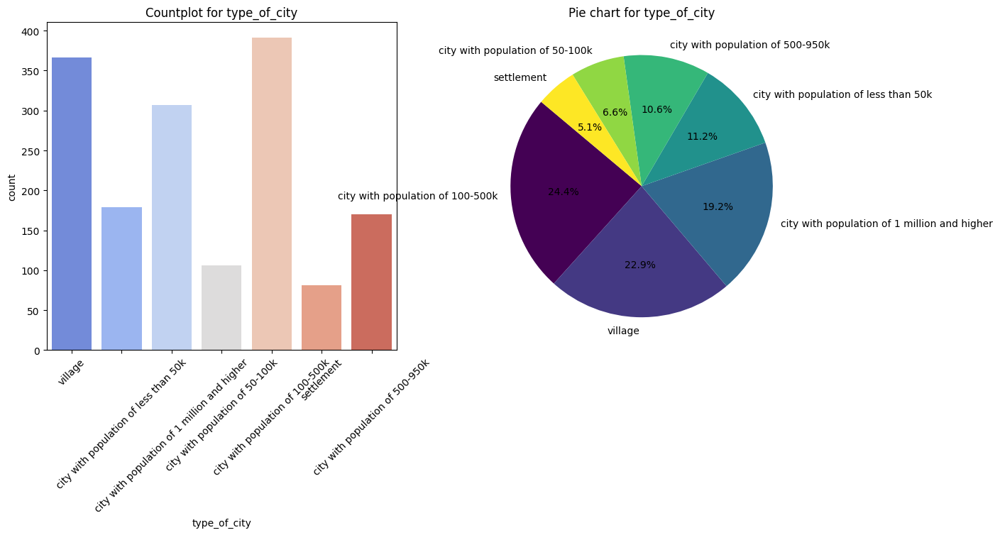

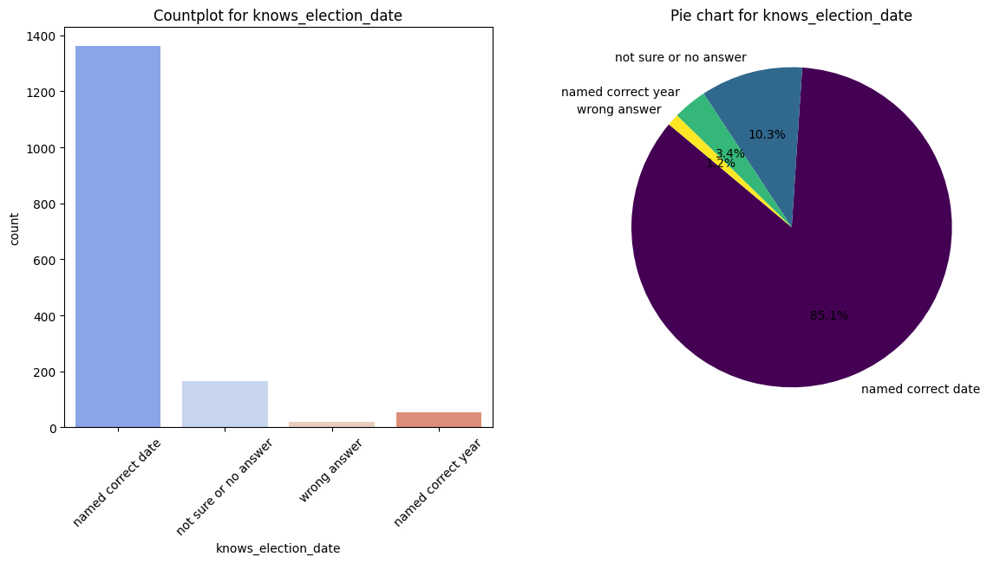

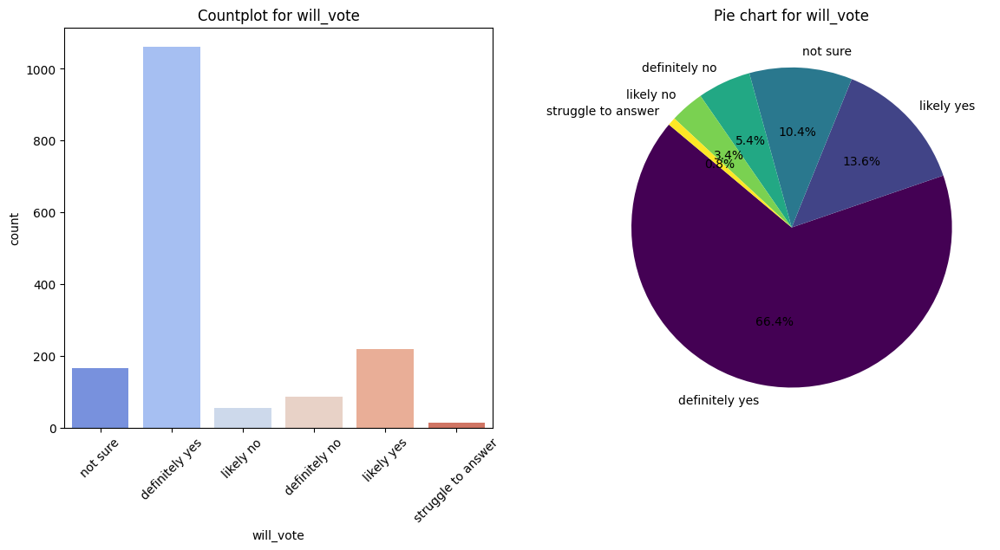

...

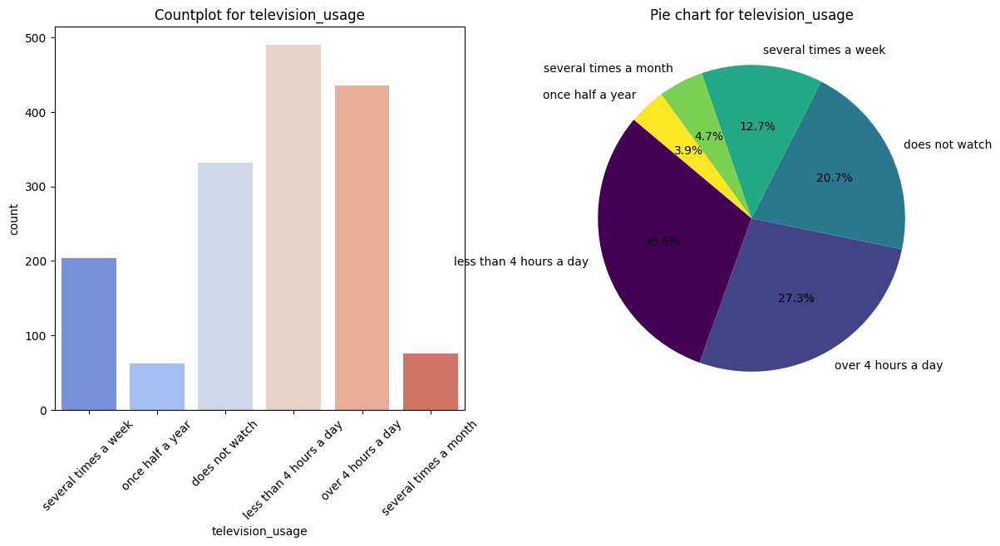

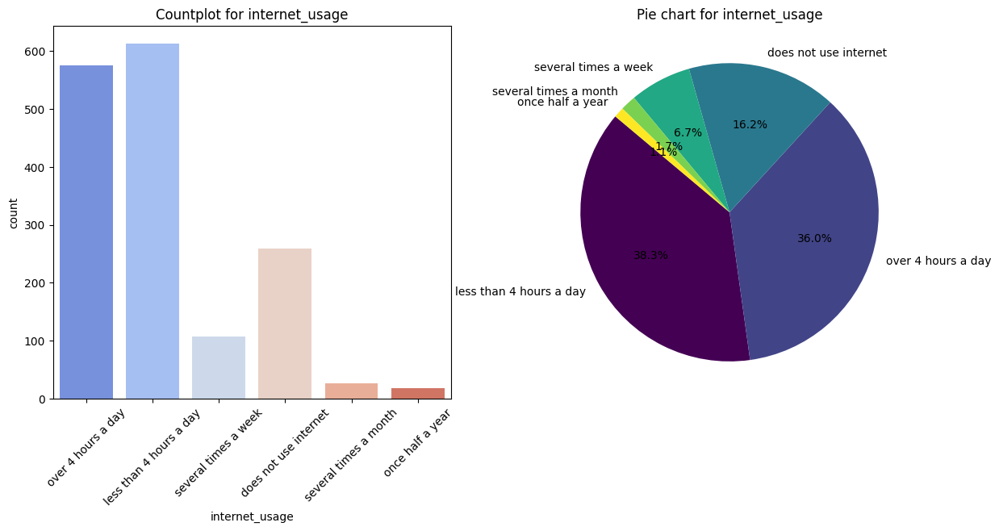

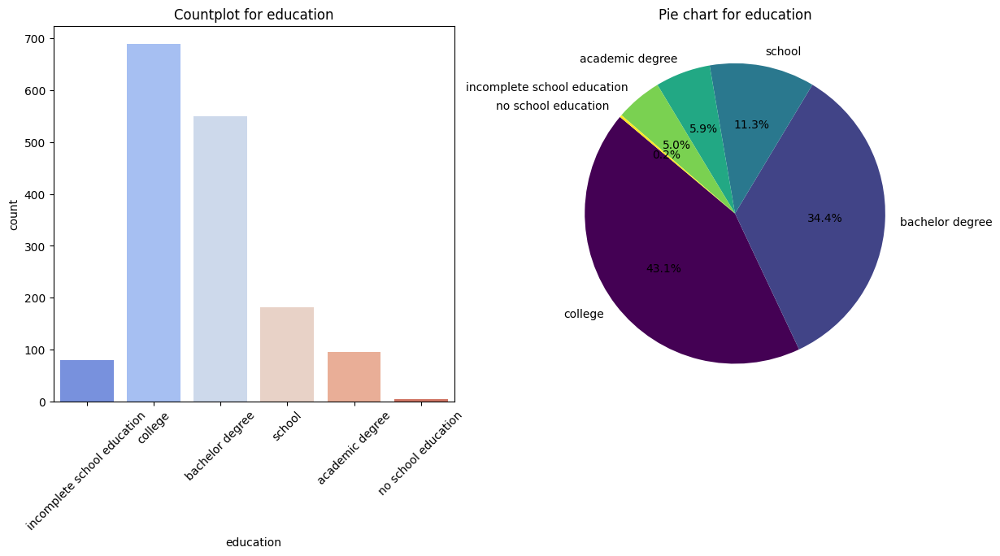

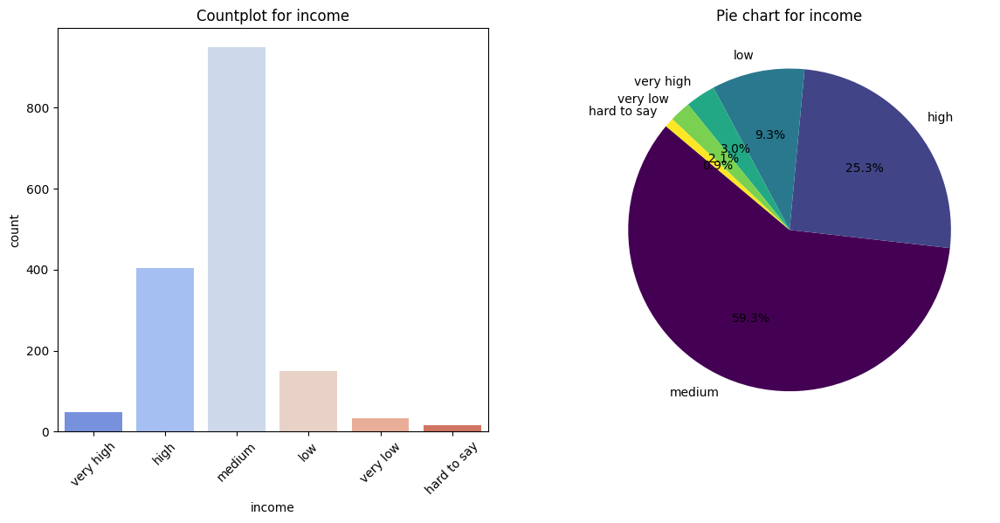

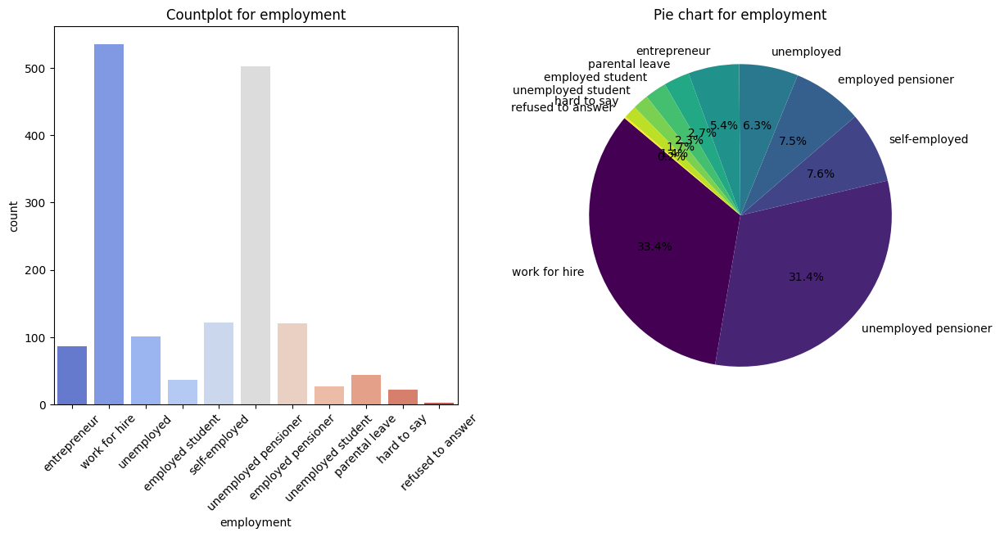

In [71]:
# Data Visualization - 4

# Univariate Analysis
# Collective Display of Coutnplots and Pie Charts for Categorical Columns

def univariate_categorical_analysis(data, categorical_cols):
    for col in categorical_cols:
        plt.figure(figsize=(14, 6))
        plt.subplot(1, 2, 1)
        sns.countplot(x=col, data=data, hue=col, palette='coolwarm')
        plt.xticks(rotation=45)
        plt.title(f'Countplot for {col}')

        plt.subplot(1, 2, 2)
        data[col].value_counts().plot.pie(autopct='%1.1f%%', startangle=140, cmap='viridis')
        plt.title(f'Pie chart for {col}')
        plt.ylabel('')
        plt.show()

univariate_categorical_analysis(df, categorical_cols)

Cell 25 - Insights:
1. The code has been executed successfully.
2. All the required Countplots as well as the Pie Charts have been generated for Categorical Data.
3. From the Visual Representation of 'sex' column, it is evident that Females are in majority (52.7%) in the given dataset, while Males form (47.3%), which is a considerable minority.
4. From the data of Federal District, it can be concluded that the highest population resides in Central (26.6%), followed by Volga (20.3%), while the least reside in Far Eastern (5.6%).
5. The highest share of the population of this dataset, reside in Cities with population ranging between 100k to 500k (24.4%), followed by Village (22.9%).
6. Most of the voters (85.1%) knows the correct election date.
7. Most of them (66.4%) are going to vote definitely.
8. Most of them (70.5%) are going to vote for Putin.
9. The television usage ranges for less than 4 hours a day, for most of them (30.6%).
10. Most of them (43.1%) have received college education, while only a miniscule population have never gone to school.
11. The population with medium income forms the majority (59.3%).
12. Work for Hire is the most populated group (33.4%), when the population is classified on the basis of employment.

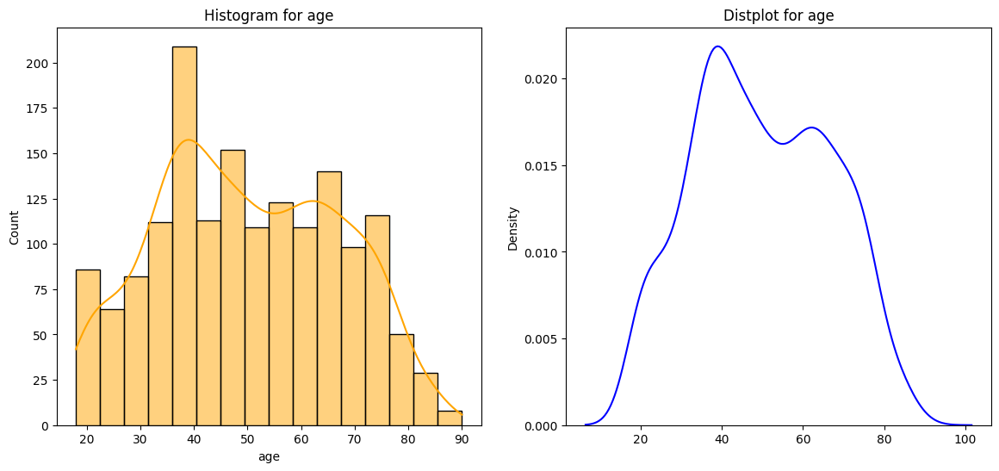

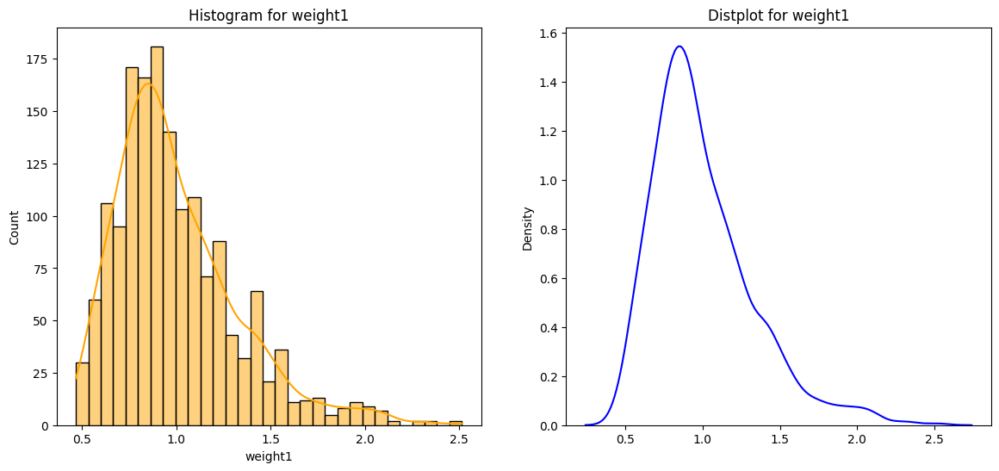

In [78]:
# Data Visualization - 5

# Univariate Analysis
# Collective Display of Histograms and Distplots for Numerical Columns

def univariate_numerical_analysis(data, numerical_cols):
    for col in numerical_cols:
        plt.figure(figsize=(14, 6))
        plt.subplot(1, 2, 1)
        sns.histplot(data[col], kde=True, color="orange")
        plt.title(f'Histogram for {col}')

        plt.subplot(1, 2, 2)
        sns.distplot(x=data[col], hist=False, color="blue")
        plt.title(f'Distplot for {col}')
        plt.show()

univariate_numerical_analysis(df, numerical_cols)

Cell 26 - Insights:
1. The code has run successfully.
2. The required Histograms and DistPlots have been generated successfully.
3. From the graphs of Age, it is evident that most of the population belong to the medium age group and it almost follows a normal distribution pattern, except for a minor variation, post medium age group.
4. From the graphs of Weight1, it is evident that most of the population belong around the 1.0 mark and the distribution graph is right-skewed.

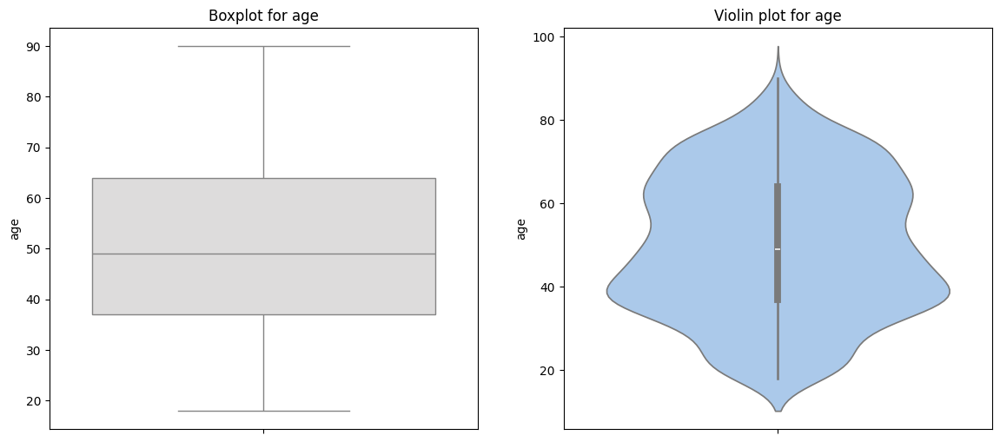

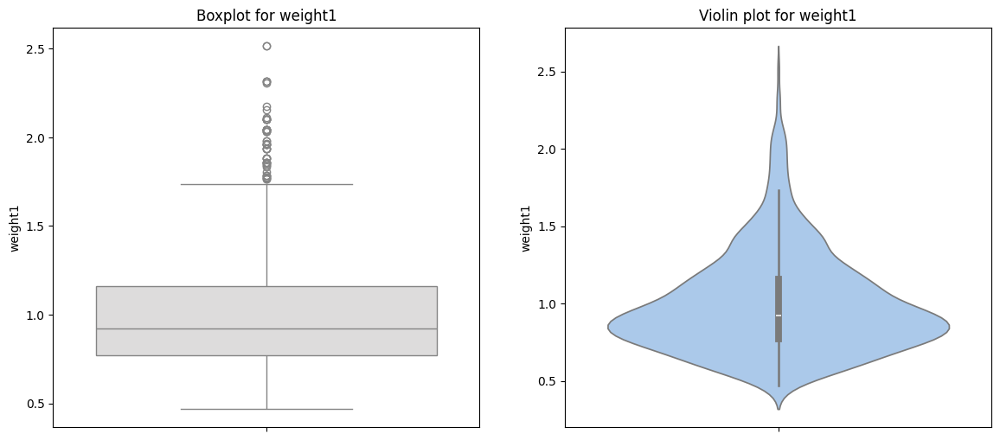

In [81]:
# Data Visualization - 6

# Univariate Analysis
# Checking for Outliers
# Box Plot and Violin Plot

def check_outliers(data, numerical_cols):
    for col in numerical_cols:
        plt.figure(figsize=(14, 6))
        plt.subplot(1, 2, 1)
        sns.boxplot(y=data[col], palette="coolwarm")
        plt.title(f'Boxplot for {col}')

        plt.subplot(1, 2, 2)
        sns.violinplot(y=data[col], palette="pastel")
        plt.title(f'Violin plot for {col}')
        plt.show()

check_outliers(df, numerical_cols)

Cell 27 - Insights:
1. The code has run successfully.
2. The required graphs have been generated successfully.
3. The 'age' data seems to be fairly evenly distributed without significant outliers.
4. The interquartile range (IQR) is relatively wide, indicating moderate variability in age and the median age appears to be around the center of the data distribution, suggesting a symmetric distribution.
5. The violin plot shows that the distribution of ages is relatively smooth, with a slight concentration around the median.
6. The distribution tails are fairly balanced, indicating that there is not a significant skew in the data.
7. The shape suggests a possible bimodal distribution, with two peaks.

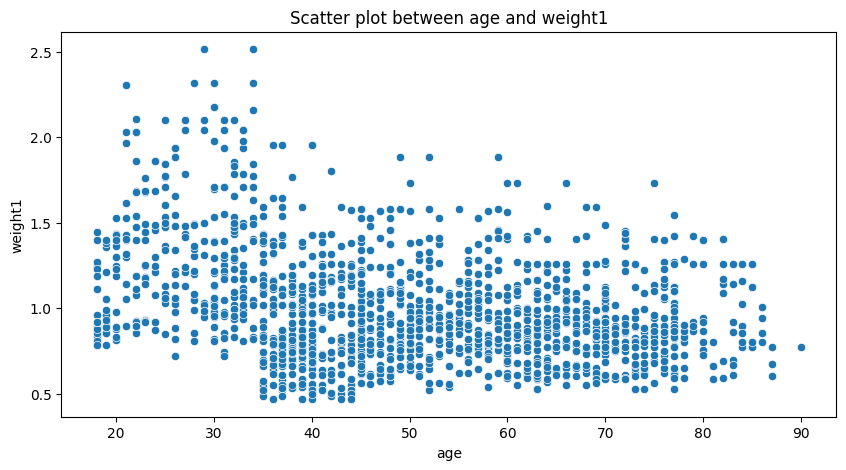

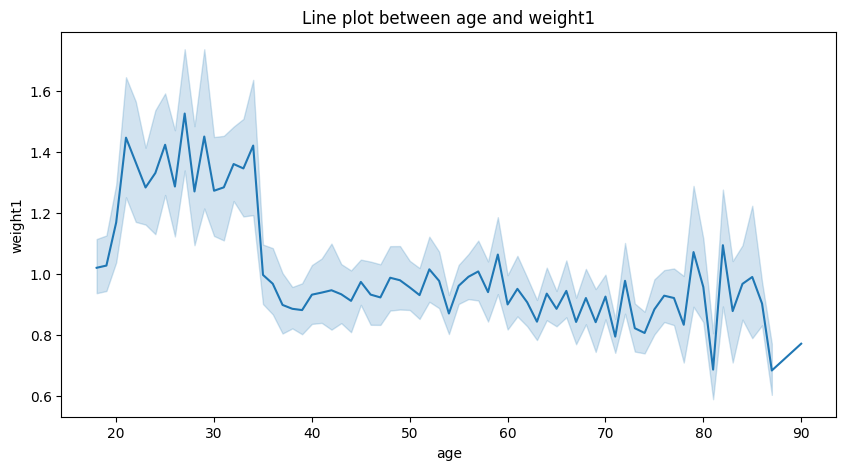

In [85]:
# Data Visualization - 7:

# Multivariate Analysis
# Visualizing Numerical - Numerical Data
# Scatter Plot and Line Plot

def multivariate_numerical_numerical(data, numerical_cols):
    for i in range(len(numerical_cols)):
        for j in range(i + 1, len(numerical_cols)):
            plt.figure(figsize=(10, 5))
            sns.scatterplot(x=data[numerical_cols[i]], y=data[numerical_cols[j]])
            plt.title(f'Scatter plot between {numerical_cols[i]} and {numerical_cols[j]}')
            plt.show()

            plt.figure(figsize=(10, 5))
            sns.lineplot(x=data[numerical_cols[i]], y=data[numerical_cols[j]])
            plt.title(f'Line plot between {numerical_cols[i]} and {numerical_cols[j]}')
            plt.show()

multivariate_numerical_numerical(df, numerical_cols)

Cell 28 - Insights:
1. The code has run successfully.
2. The required graphs have been generated.
3. The Scatter Plot shows the Age vs Weight1 Relationship. There's a wide range of 'weight1' values for younger age groups (20-30 years), indicating more variability in weight and as age increases, the variability in 'weight1' decreases, especially after the age of 40, when the data points become more concentrated, suggesting that older age groups have more consistent weight values.
4. The Line Plot shows trend and variability. The 'weight1' values are highest in the 20-30 age range and show a decreasing trend as age increases. This trend continues relatively smoothly, with a few fluctuations around age 50 and 70. The confidence interval is wider at younger ages (20-30 years), indicating more variability in weight. This variability decreases as age increases, as the confidence interval narrows.

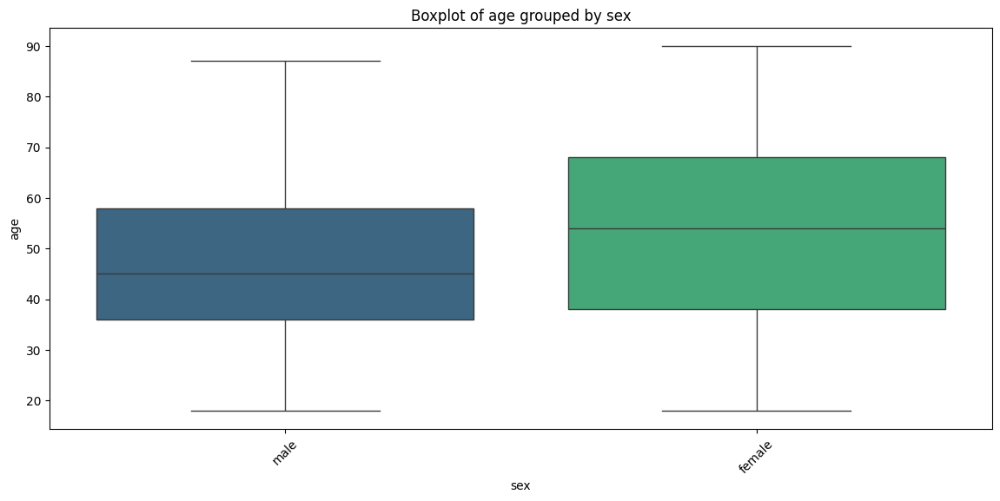

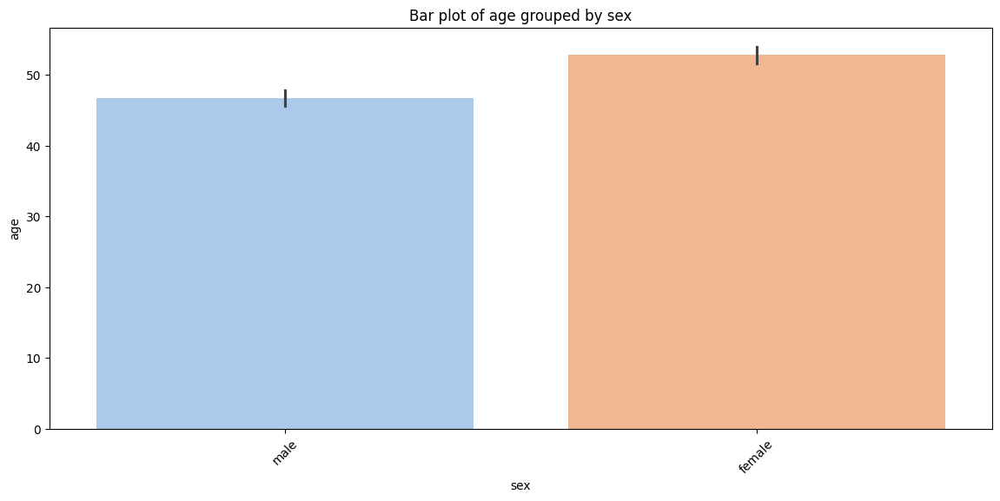

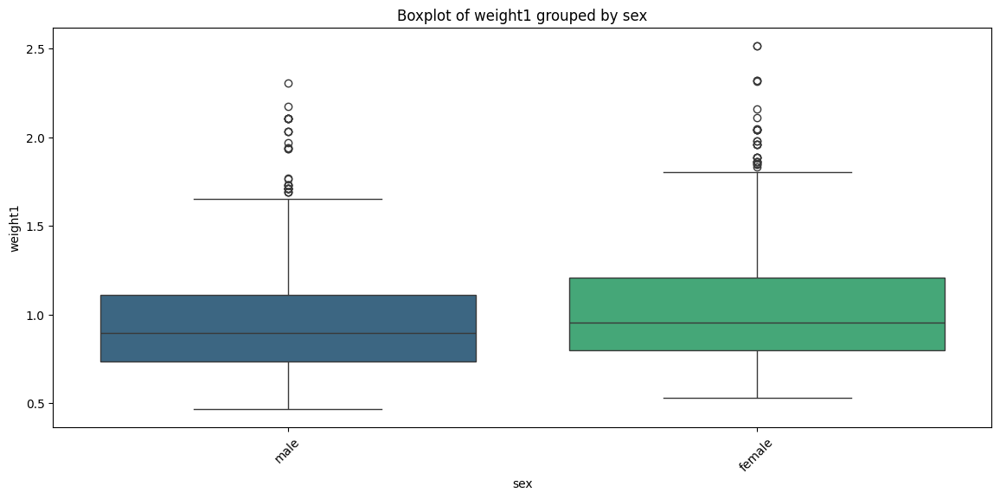

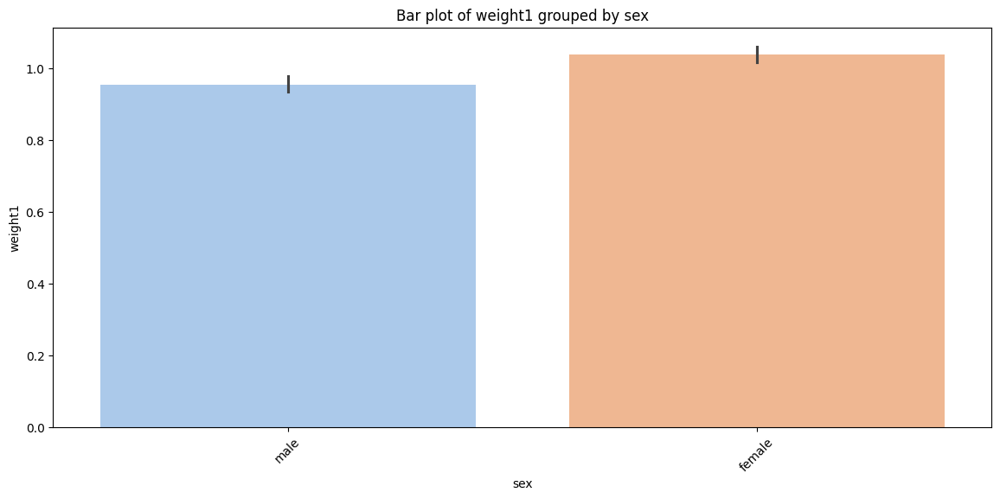

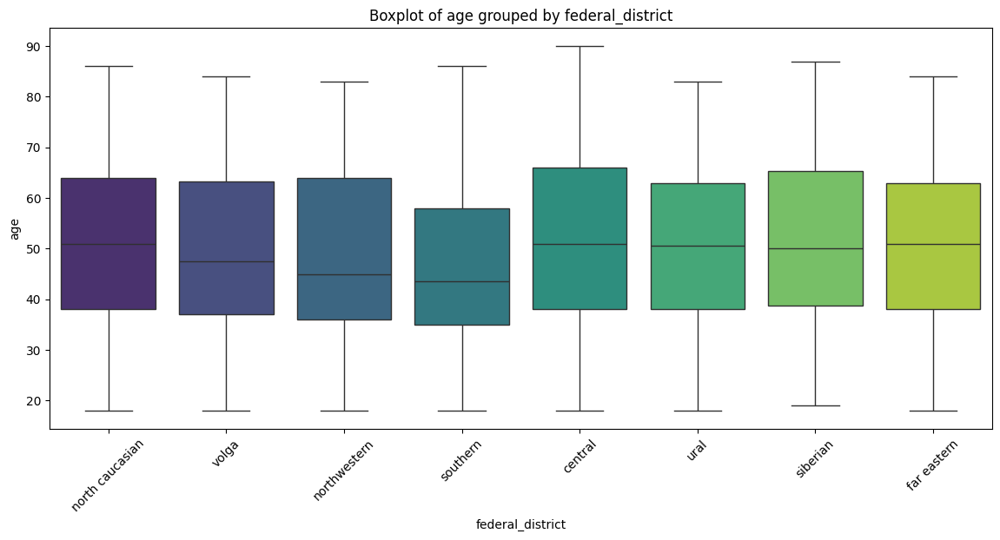

...

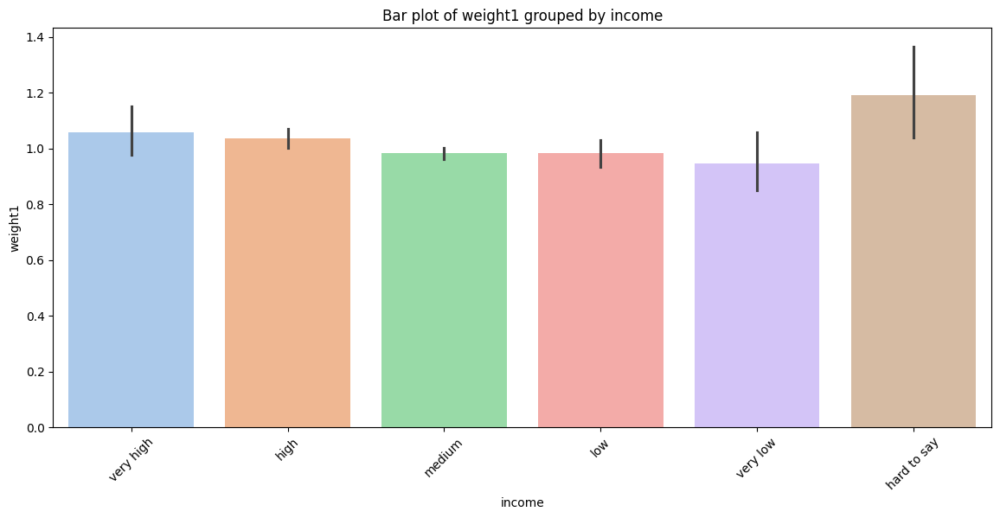

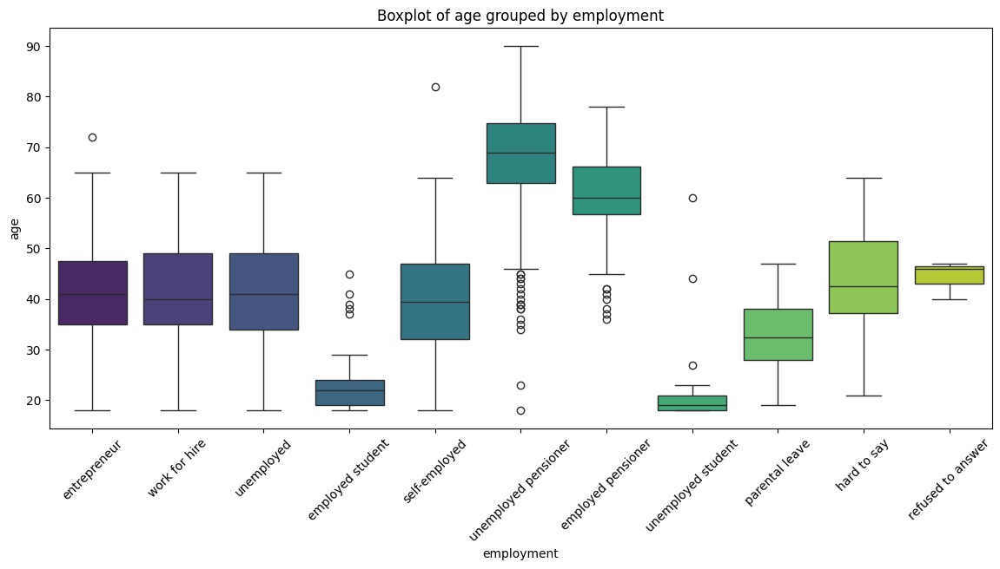

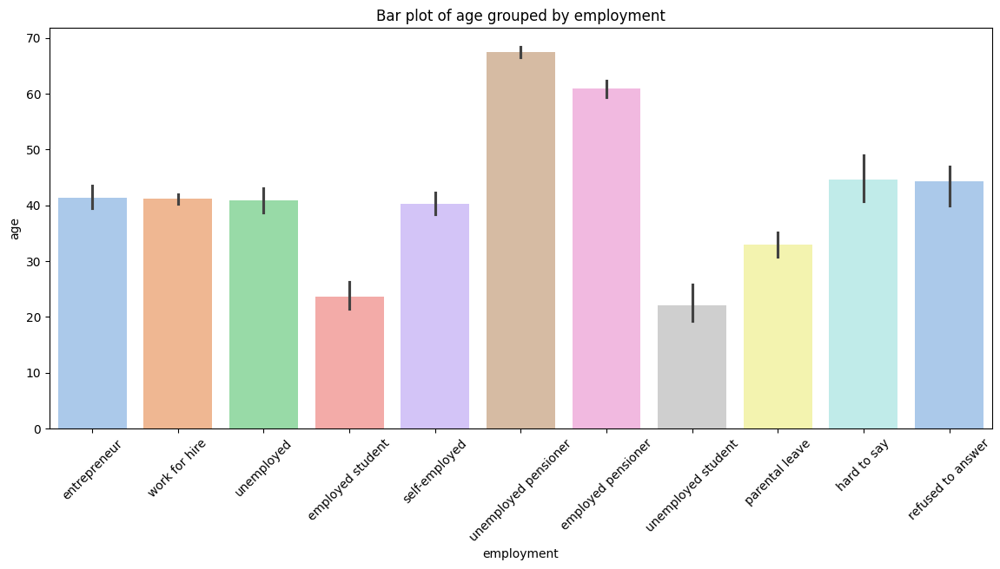

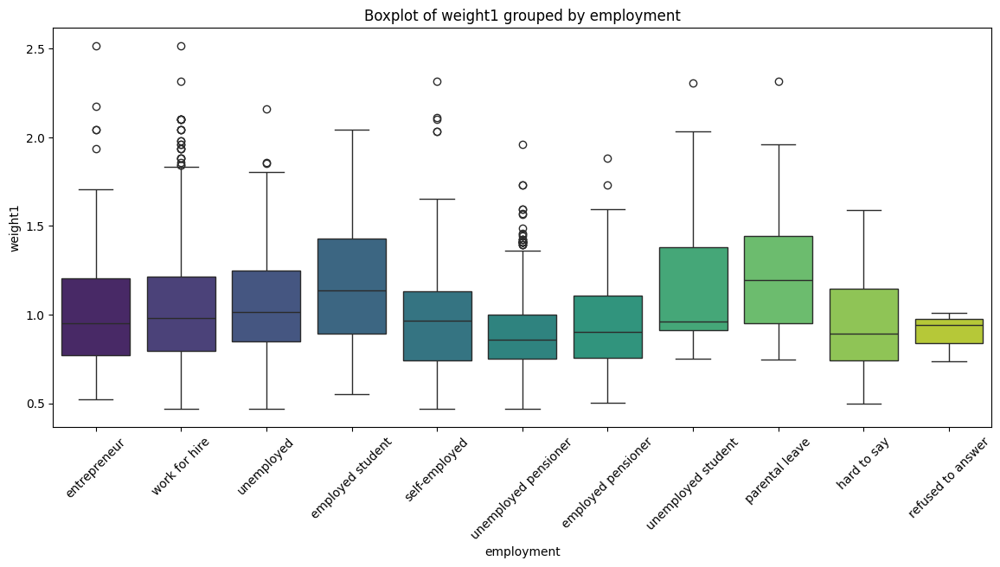

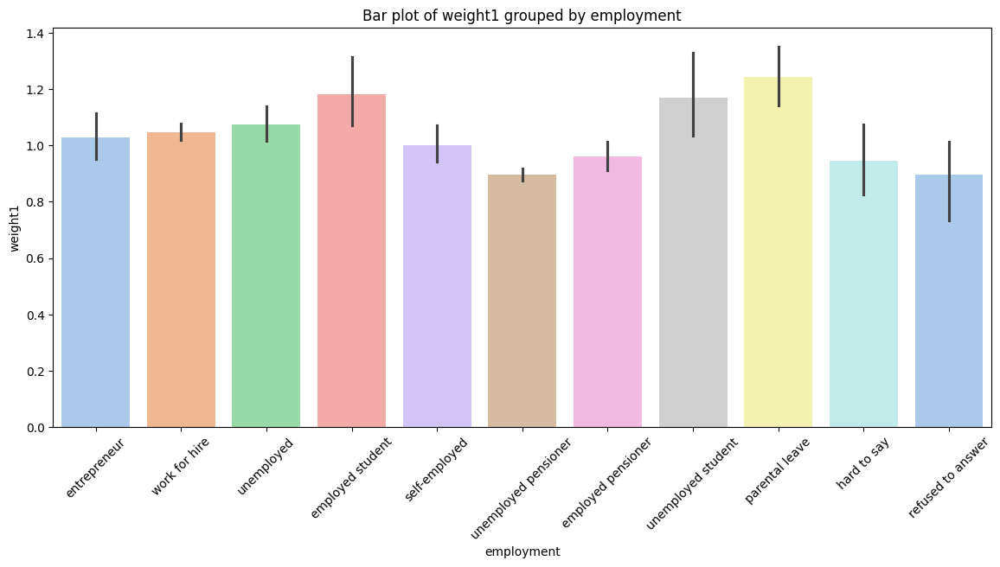

In [87]:
# Data Visualization - 8:

# Multivariate Analysis
# Visualization of Numerical - Categorical Data
# Bar Plot and Box Plot

def multivariate_numerical_categorical(data, numerical_cols, categorical_cols):
    for cat_col in categorical_cols:
        for num_col in numerical_cols:
            plt.figure(figsize=(14, 6))
            sns.boxplot(x=data[cat_col], y=data[num_col], palette="viridis")
            plt.xticks(rotation=45)
            plt.title(f'Boxplot of {num_col} grouped by {cat_col}')
            plt.show()

            plt.figure(figsize=(14, 6))
            sns.barplot(x=data[cat_col], y=data[num_col], palette="pastel")
            plt.xticks(rotation=45)
            plt.title(f'Bar plot of {num_col} grouped by {cat_col}')
            plt.show()

multivariate_numerical_categorical(df, numerical_cols, categorical_cols)

Cell 29 - Insights:
1. The code has run successfully.
2. The required plots have been generated.
3. The Box Plot and the Bar Plot do not contradict each other's data.

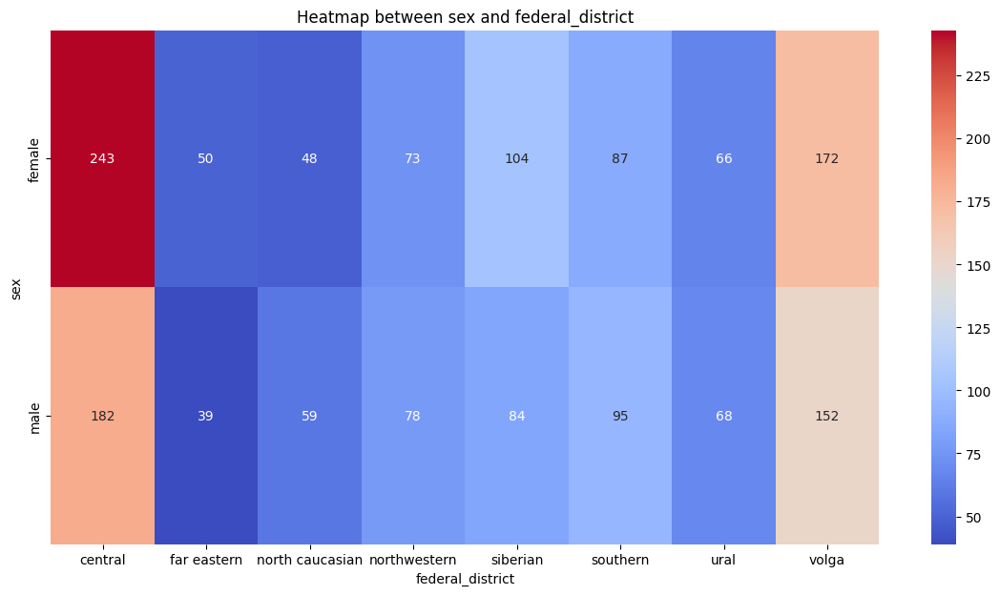

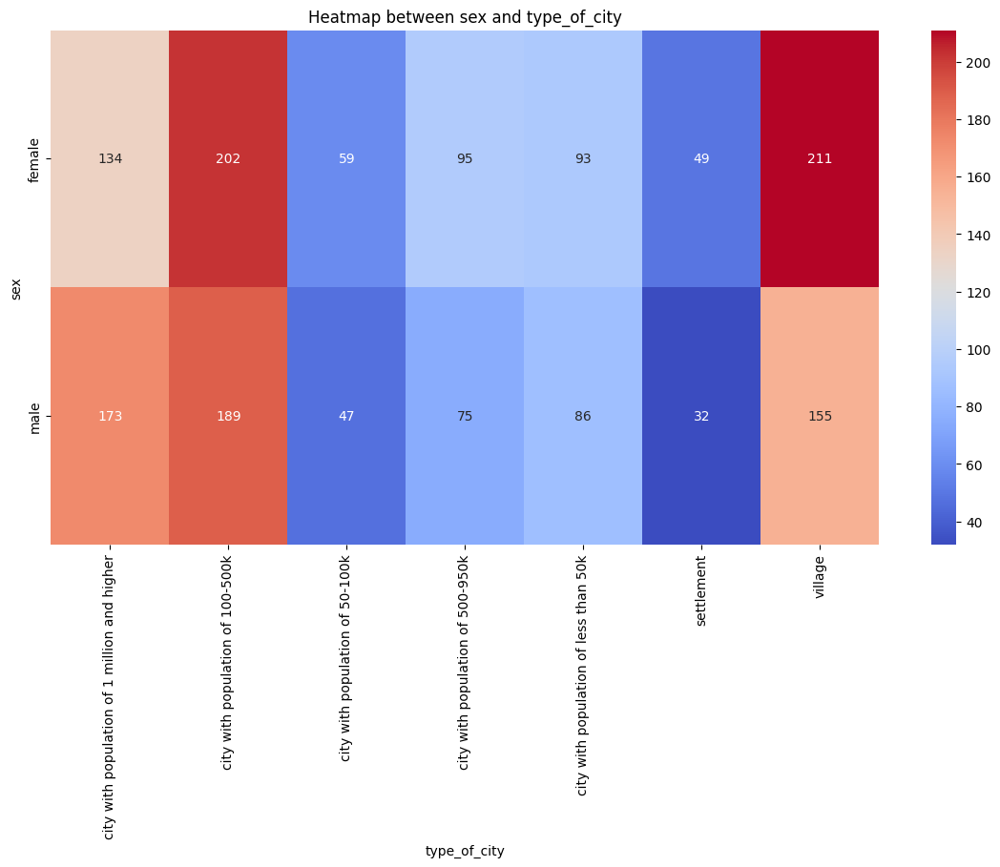

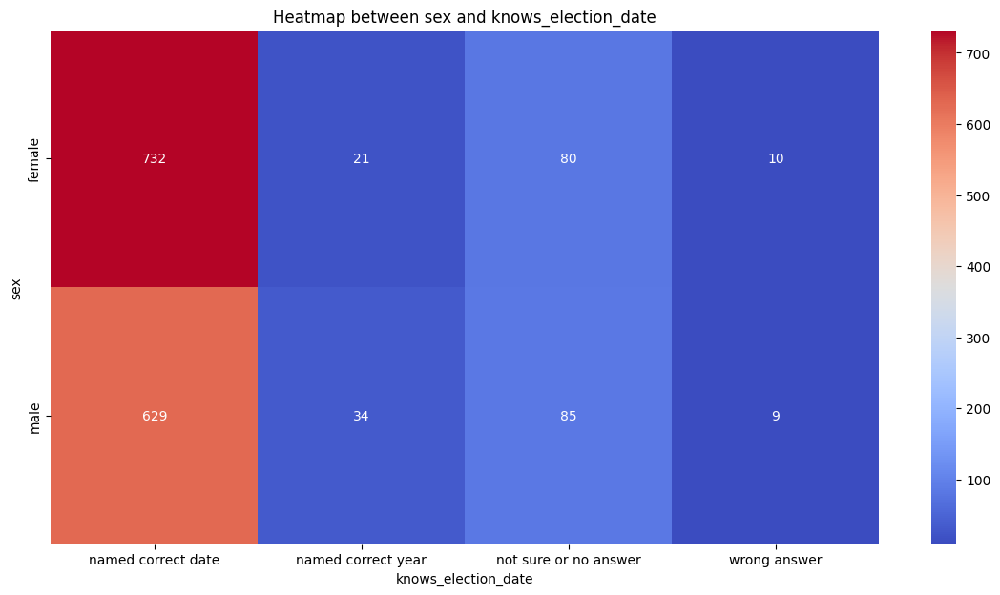

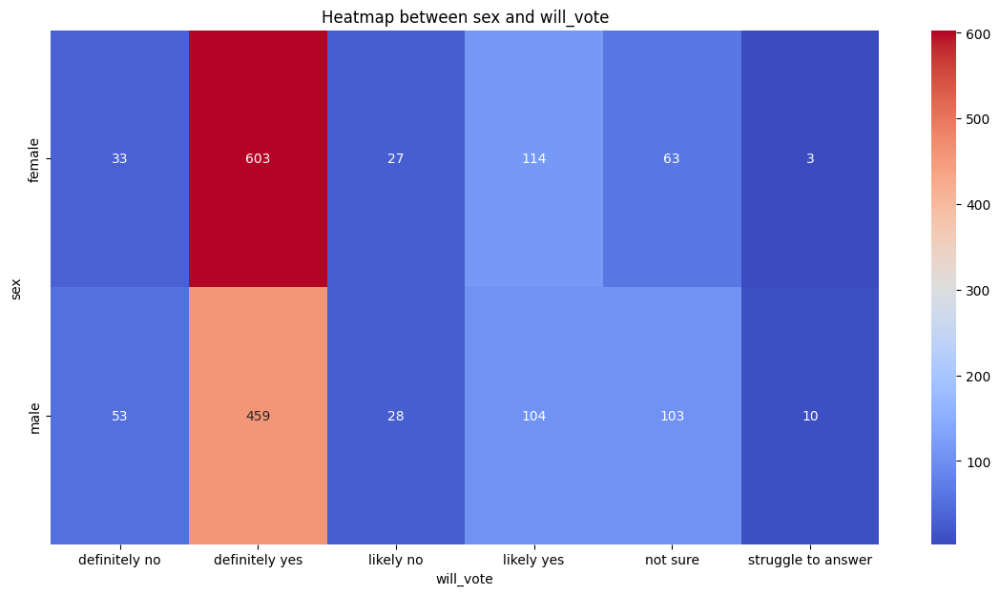

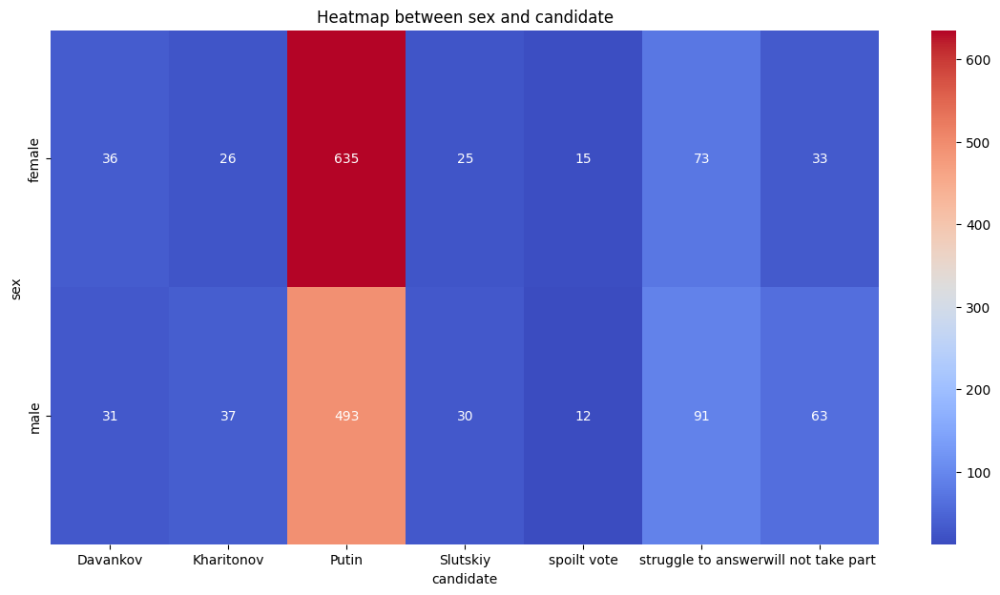

...

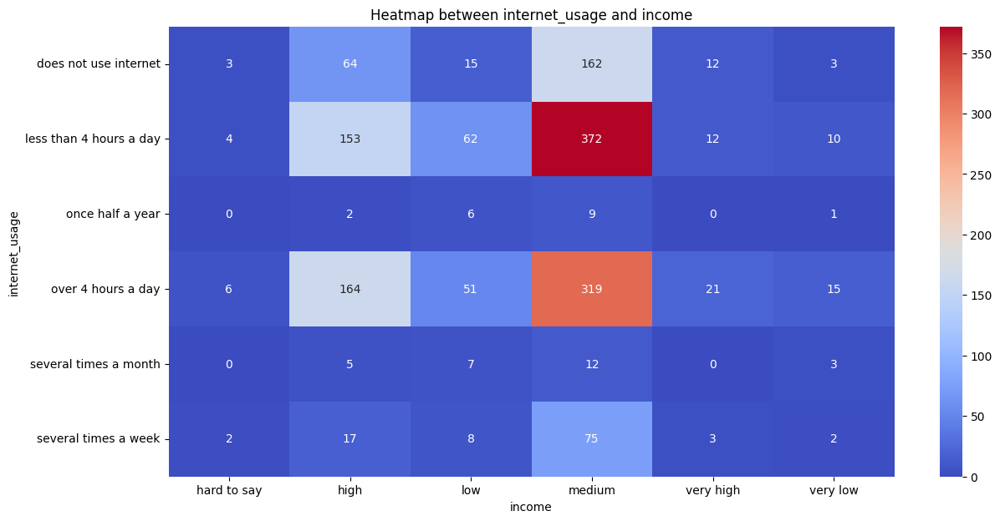

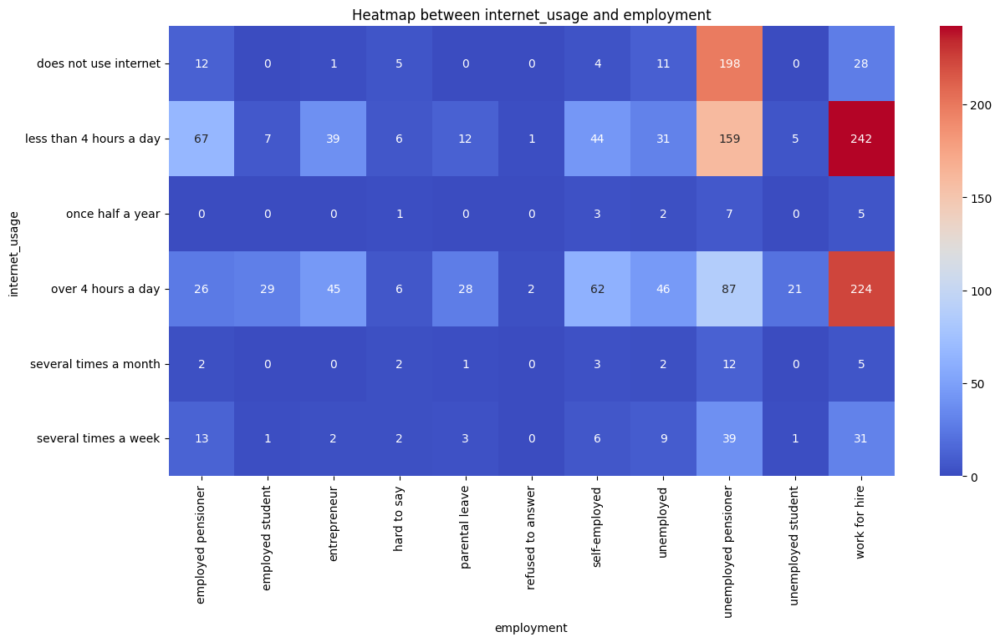

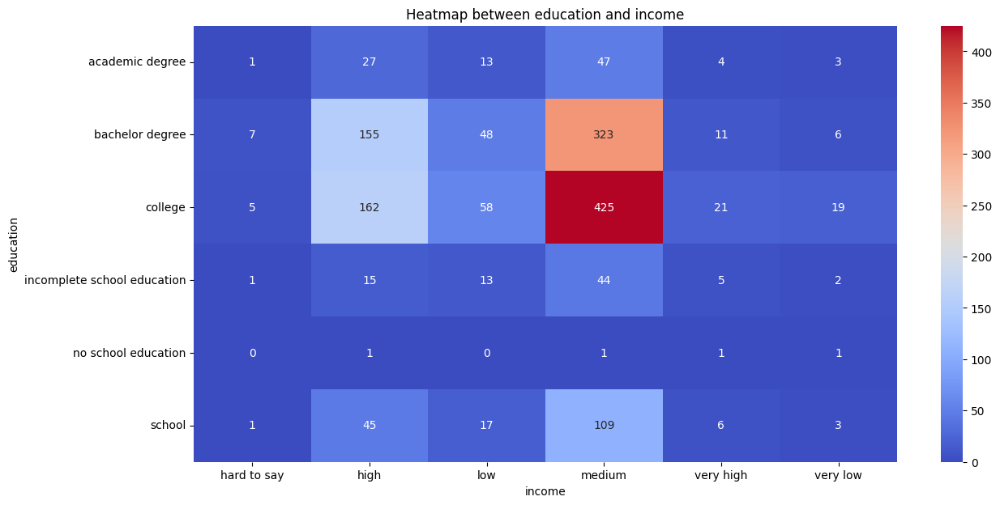

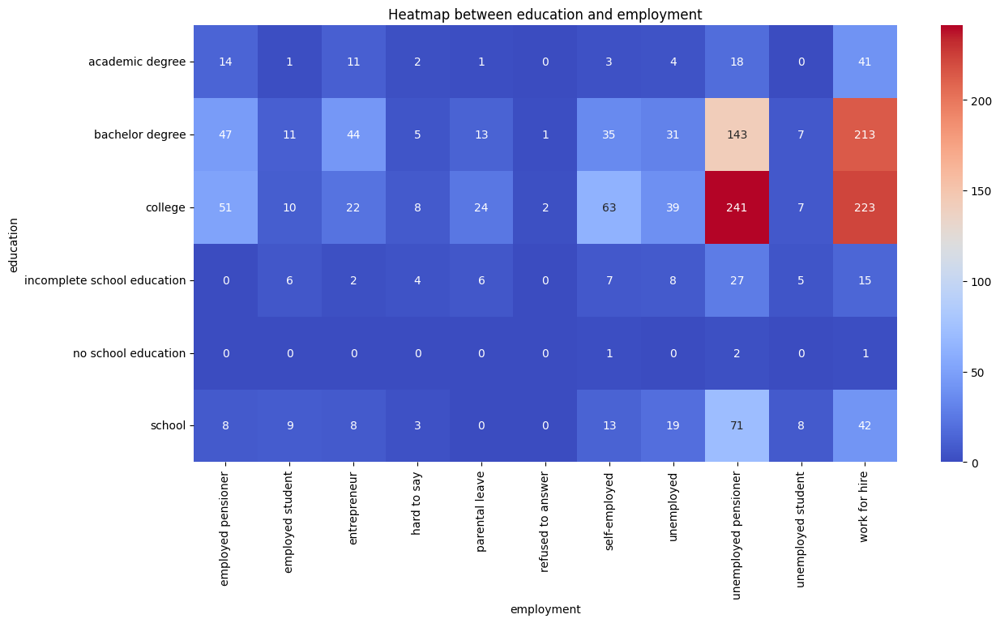

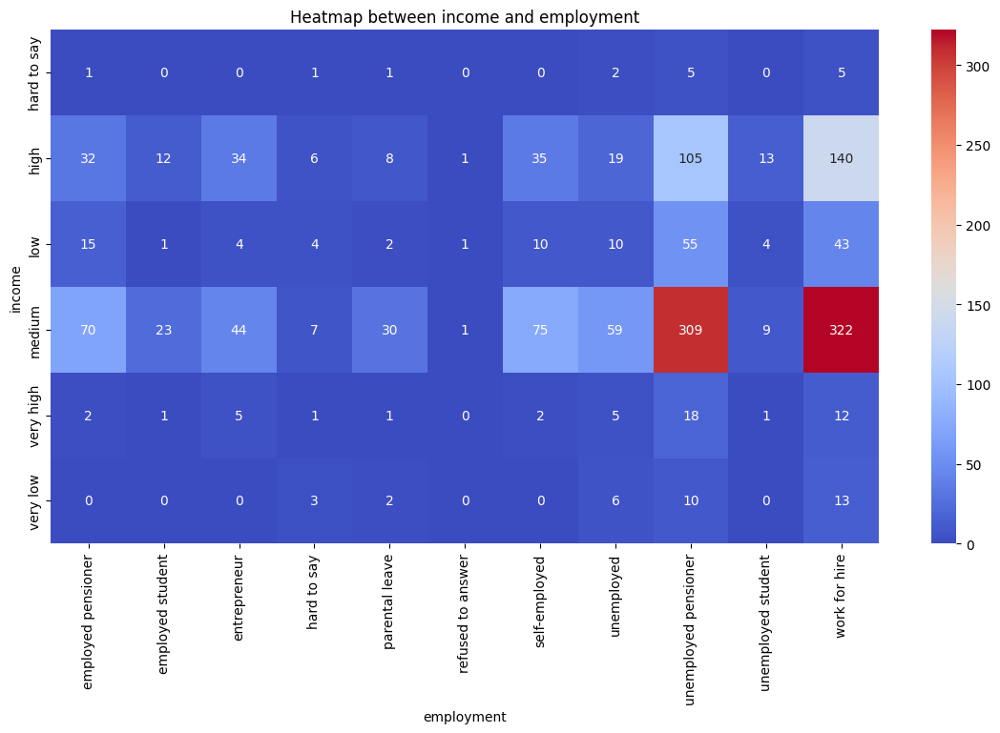

In [91]:
# Data Visualization - 9:

# Multivariate Analysis
# Visualizing Categorical - Categorical Data
# Heatmap

def multivariate_categorical_categorical(data, categorical_cols):
    for i in range(len(categorical_cols)):
        for j in range(i + 1, len(categorical_cols)):
            crosstab = pd.crosstab(data[categorical_cols[i]], data[categorical_cols[j]])
            plt.figure(figsize=(14, 7))
            sns.heatmap(crosstab, annot=True, fmt="d", cmap="coolwarm")
            plt.title(f'Heatmap between {categorical_cols[i]} and {categorical_cols[j]}')
            plt.show()

multivariate_categorical_categorical(df, categorical_cols)

Cell 30 - Insights:
1. The code has run successfully.
2. The required graphs have been generated successfully.
3. All the graphs contain the Number of Males and Number of Females have given a particular response.
4. Such graphs help to visualize the categorical data in a very easy manner and also establish the relationships among themselves.

# Data Encoding

In [100]:
# Data Encoding

def encode_data(data, categorical_cols):
    label_encoders = {}
    for col in categorical_cols:
        le = LabelEncoder()
        data[col] = le.fit_transform(data[col])
        label_encoders[col] = le
    return data, label_encoders

df, label_encoders = encode_data(df, categorical_cols)

Cell 31 - Insights:
1. The code has run successfully.
2. The data has been encoded successfully.

In [101]:
# Visualizing the DataFrame
df

,sex,age,federal_district,type_of_city,knows_election_date,will_vote,candidate,television_usage,internet_usage,education,income,employment,weight1
0,1,18.0,2,6,0,4,2,5,3,3,4,2,1.445172
1,1,23.0,2,6,0,4,2,2,3,2,4,10,1.445172
2,1,20.0,7,4,0,1,2,5,3,2,4,10,1.301691
3,1,22.0,3,0,2,4,0,5,3,2,4,7,1.538628
4,1,21.0,5,0,0,1,2,0,3,1,4,1,1.967015
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1595,1,61.0,0,5,0,0,6,3,1,1,0,8,1.270761
1596,0,80.0,7,6,0,3,5,5,0,2,0,8,0.921724
1597,0,76.0,3,2,0,1,2,0,3,1,0,8,1.396691
1598,0,74.0,0,4,2,1,2,3,3,0,0,0,0.995849


Cell 32 - Insights:
1. The DataFrame has been visualized successfully.
2. It is evident that the Data Encoding procedure has been executed successfully.

In [102]:
# Statistical Analysis of the DataFrame
df.describe().T

,count,mean,std,min,25%,50%,75%,max
sex,1600.0,0.473125,0.499433,0.000000,0.000000,0.000000,1.000000,1.000000
age,1600.0,49.936250,16.901797,18.000000,37.000000,49.000000,64.000000,90.000000
federal_district,1600.0,3.431250,2.657948,0.000000,0.000000,4.000000,6.000000,7.000000
type_of_city,1600.0,2.768750,2.256869,0.000000,1.000000,2.000000,5.000000,6.000000
knows_election_date,1600.0,0.276250,0.691183,0.000000,0.000000,0.000000,0.000000,3.000000
will_vote,1600.0,1.596875,1.158211,0.000000,1.000000,1.000000,2.000000,5.000000
candidate,1600.0,2.492500,1.396393,0.000000,2.000000,2.000000,2.000000,6.000000
television_usage,1600.0,2.028750,1.657450,0.000000,1.000000,1.000000,3.000000,5.000000
internet_usage,1600.0,1.887500,1.431302,0.000000,1.000000,1.000000,3.000000,5.000000
education,1600.0,1.931875,1.286767,0.000000,1.000000,2.000000,2.000000,5.000000


Cell 33 - Insights:
1. The code has run successfully.
2. The statistical analysis (describe) of the DataFrame has been done successfully.
3. This time, there have been no NaN in the Statistical Analysis, as this operation is done on Numerical Data and after Data Encoding all Categorical Data has been converted to Numerical Data, successfully.

In [103]:
# Unique Value
def unique_values(data):
    unique_values = {col: data[col].unique() for col in data.columns}
    return unique_values

unique_values = unique_values(df)
unique_values

{'sex': array([1, 0], dtype=int64),
 'age': array([18., 23., 20., 22., 21., 27., 37., 43., 39., 36., 49., 60., 44.,
        61., 67., 29., 47., 32., 45., 35., 53., 71., 54., 55., 48., 66.,
        56., 68., 69., 33., 76., 77., 70., 86., 90., 75., 80., 24., 19.,
        25., 28., 31., 26., 30., 38., 40., 41., 52., 50., 51., 46., 63.,
        34., 42., 65., 73., 74., 72., 59., 57., 58., 78., 79., 62., 64.,
        82., 84., 85., 87., 83., 81.]),
 'federal_district': array([2, 7, 3, 5, 0, 6, 4, 1], dtype=int64),
 'type_of_city': array([6, 4, 0, 2, 1, 5, 3], dtype=int64),
 'knows_election_date': array([0, 2, 3, 1], dtype=int64),
 'will_vote': array([4, 1, 2, 0, 3, 5], dtype=int64),
 'candidate': array([2, 0, 6, 4, 1, 5, 3], dtype=int64),
 'television_usage': array([5, 2, 0, 1, 3, 4], dtype=int64),
 'internet_usage': array([3, 1, 5, 0, 4, 2], dtype=int64),
 'education': array([3, 2, 1, 5, 0, 4], dtype=int64),
 'income': array([4, 1, 3, 2, 5, 0], dtype=int64),
 'employment': array([ 2, 10,  

Cell 34 - Insights:
1. The code has run successfully.
2. All the unique values of each column has been printed successfully.

In [104]:
# Value Counts
def value_counts(data):
    value_counts = {col: data[col].value_counts() for col in data.columns}
    return value_counts

value_counts = value_counts(df)
value_counts

{'sex': sex
 0    843
 1    757
 Name: count, dtype: int64,
 'age': age
 40.0    46
 37.0    46
 45.0    45
 38.0    44
 39.0    39
         ..
 86.0     4
 85.0     4
 87.0     3
 81.0     3
 90.0     1
 Name: count, Length: 71, dtype: int64,
 'federal_district': federal_district
 0    425
 7    324
 4    188
 5    182
 3    151
 6    134
 2    107
 1     89
 Name: count, dtype: int64,
 'type_of_city': type_of_city
 1    391
 6    366
 0    307
 4    179
 3    170
 2    106
 5     81
 Name: count, dtype: int64,
 'knows_election_date': knows_election_date
 0    1361
 2     165
 1      55
 3      19
 Name: count, dtype: int64,
 'will_vote': will_vote
 1    1062
 3     218
 4     166
 0      86
 2      55
 5      13
 Name: count, dtype: int64,
 'candidate': candidate
 2    1128
 5     164
 6      96
 0      67
 1      63
 3      55
 4      27
 Name: count, dtype: int64,
 'television_usage': television_usage
 1    490
 3    436
 0    332
 5    204
 4     76
 2     62
 Name: count, dtype: 

Cell 35 - Insights:
1. The code has run successfully.
2. The value counts of each value present in every column of the dataset has been printed successfully.

In [105]:
# Columns of the Dataset classified into Numerical Columns and Categorical Columns
def column_types(data):
    categorical_cols = data.select_dtypes(include=['object', 'category']).columns.tolist()
    numerical_cols = data.select_dtypes(include=['number']).columns.tolist()
    return categorical_cols, numerical_cols

categorical_cols, numerical_cols = column_types(df)
print(f"Categorical Columns:\n{categorical_cols}")
print(f"\nNumerical Columns:\n{numerical_cols}")

Categorical Columns:
[]

Numerical Columns:
['sex', 'age', 'federal_district', 'type_of_city', 'knows_election_date', 'will_vote', 'candidate', 'television_usage', 'internet_usage', 'education', 'income', 'employment', 'weight1']


Cell 36 - Insights:
1. The code has run successfully.
2. All the categorical columns have been successfully encoded to numerical columns.
3. This implies that Data Encoding has been successfully done and the dataset is all set to proceed further.
4. But, before proceeding further, let's take a look at some more visualizations, especially after data encoding.

# Data Visualization (Part - 2)

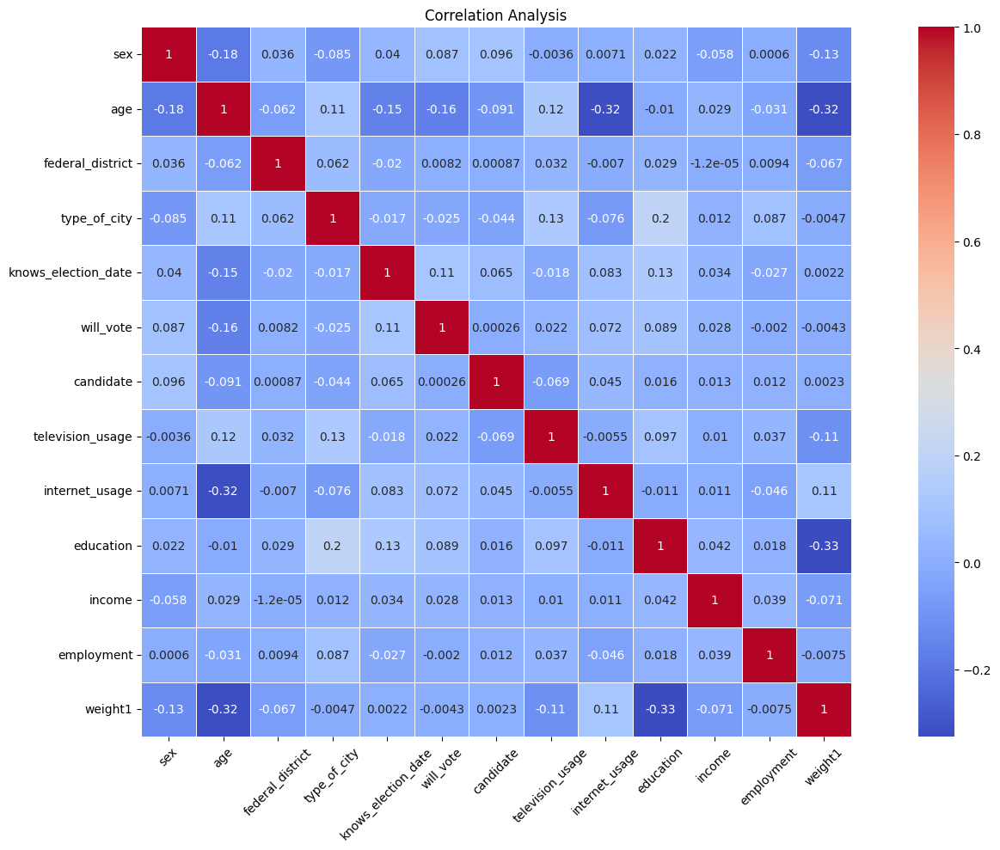

In [109]:
# Data Visualization - 10

# Visualization showing Correlation within Numerical Columns: Heatmap
def correlation_analysis(data, numerical_cols):
    correlation_matrix = data[numerical_cols].corr()
    
    # Set the figure size
    plt.figure(figsize=(16, 10))  
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5, square=True)
    plt.title("Correlation Analysis")
    
    # Rotate x-axis labels for better readability
    plt.xticks(rotation=45)  
    
    # Ensure the plot fits in the figure area
    plt.tight_layout()  
    
    # Display the Plot
    plt.show()

# Call the Function
correlation_analysis(df, numerical_cols)

Cell 37 - Insights:
1. The code has run successfully.
2. The required plot has been generated successfully.
3. From the Heatmap, it is evident that most of the feature are negatively correlated, with each other.

<Figure size 3000x2000 with 0 Axes>

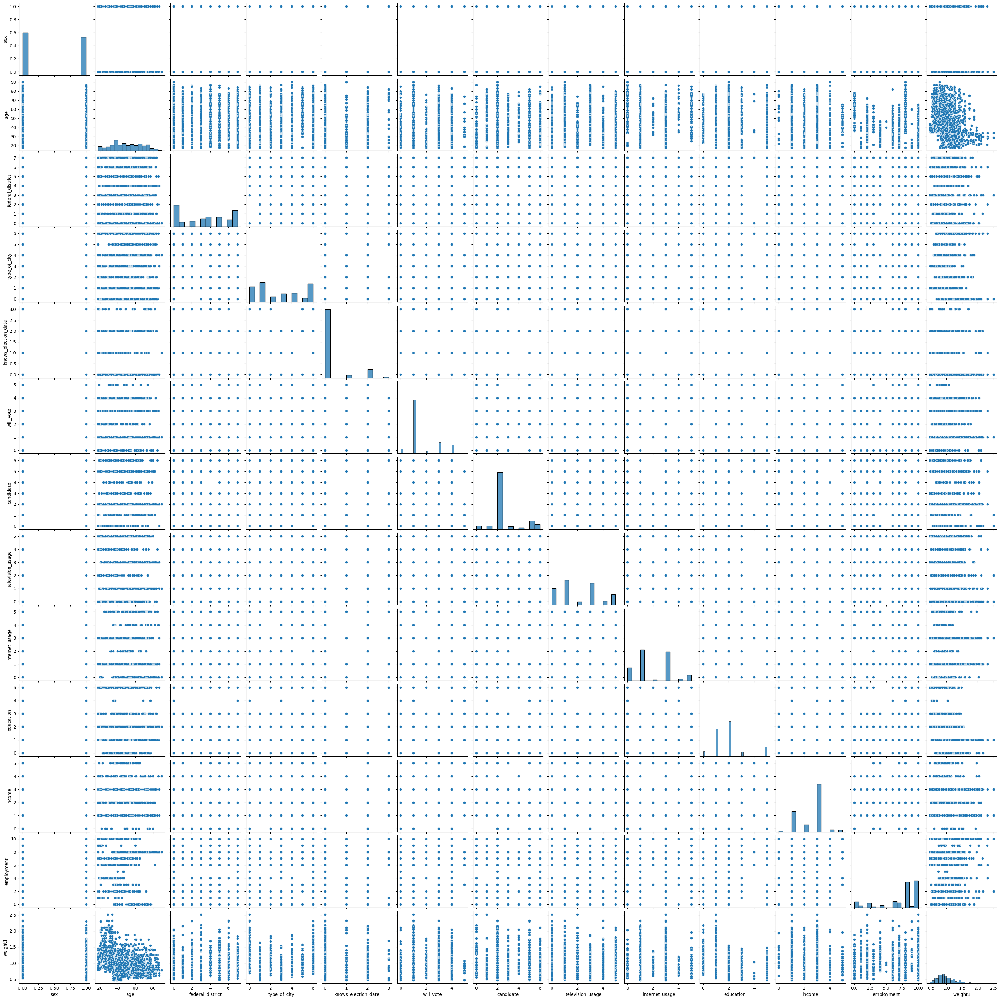

In [111]:
# Data Visualization - 11

# Visualize the Dataset using Pairplot for Numerical Data
plt.figure(figsize=(30,20))
sns.pairplot(df)

# Displaying the Plot
plt.show()

Cell 38 - Insights:
1. The code has run successfully.
2. The required pairplots have been successfully generated.

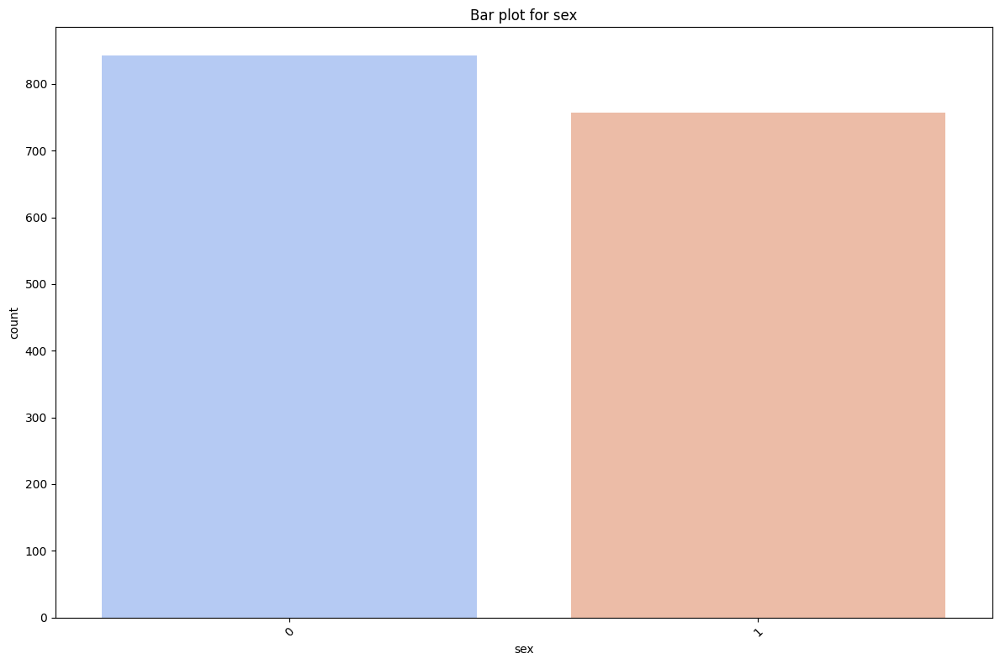

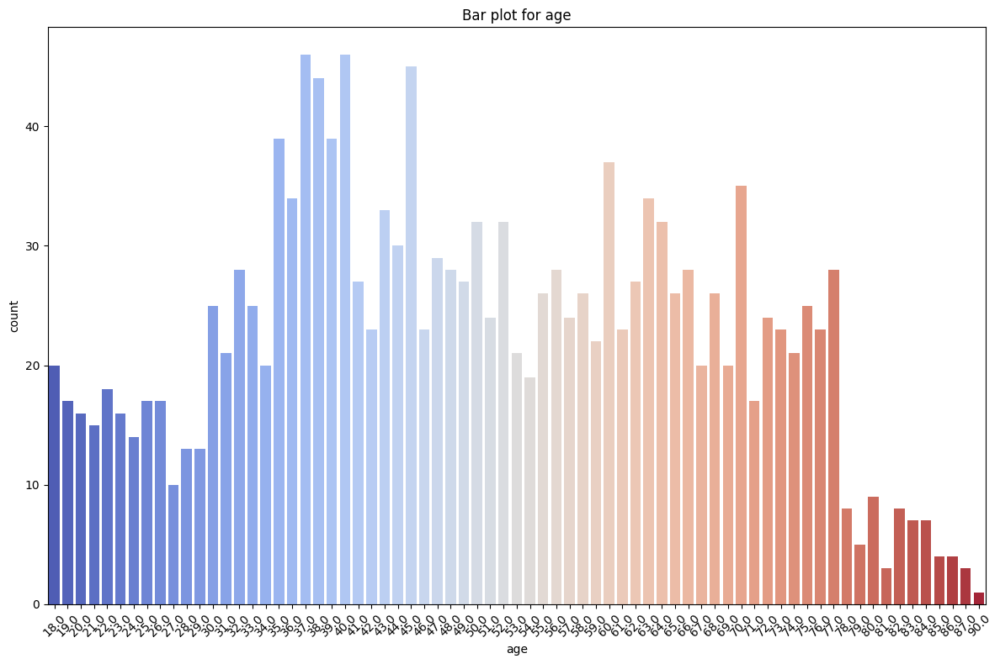

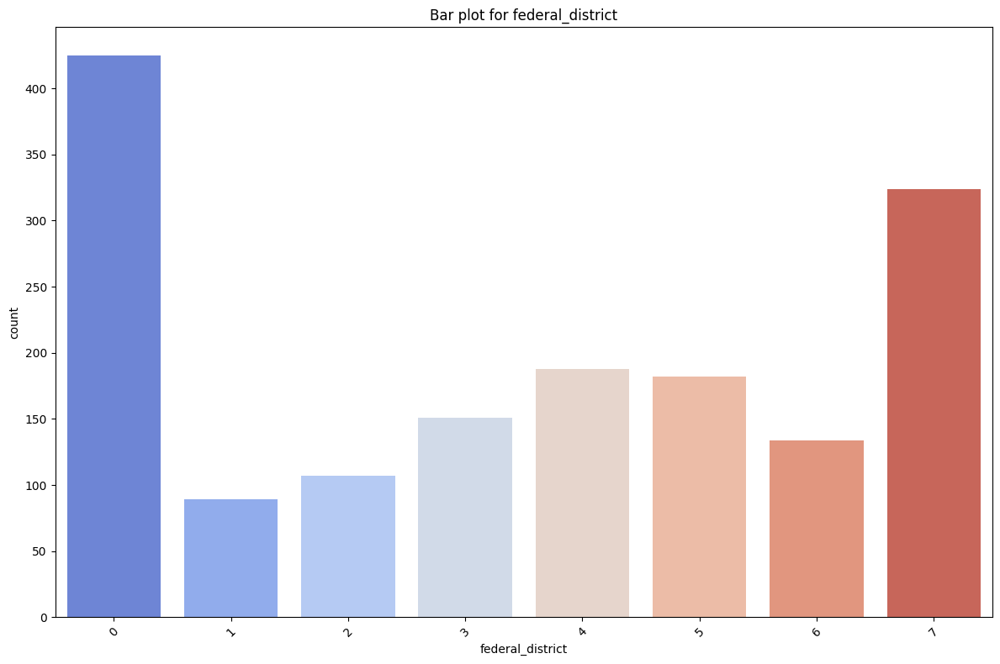

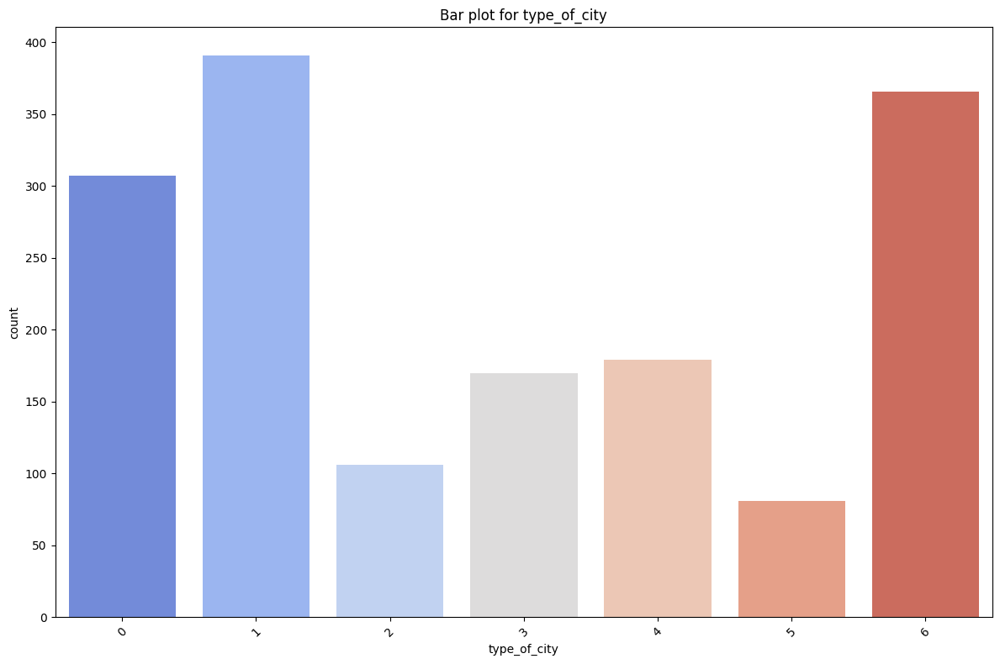

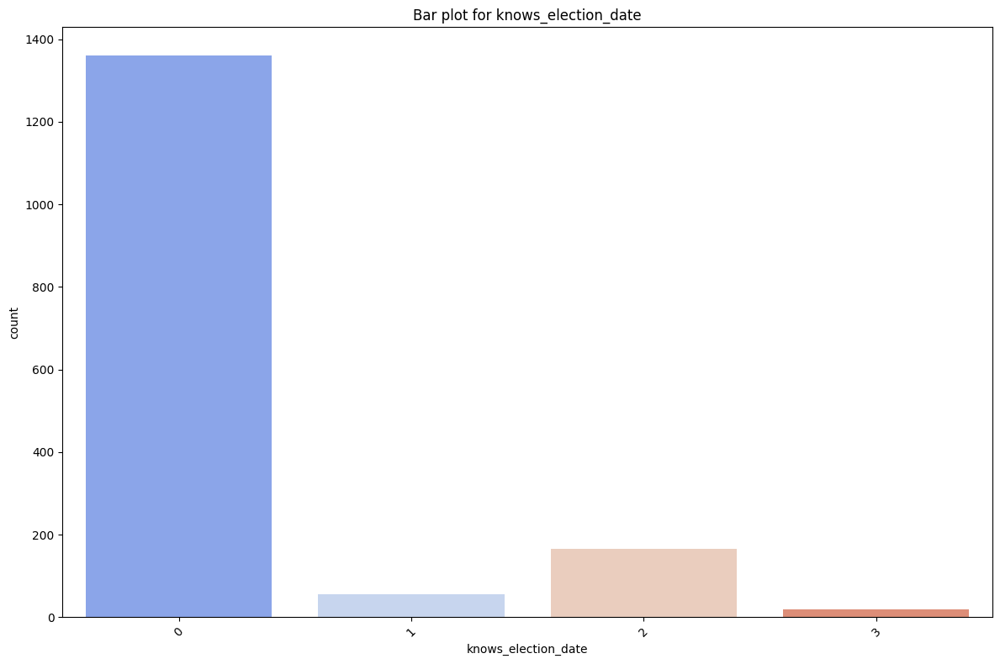

...

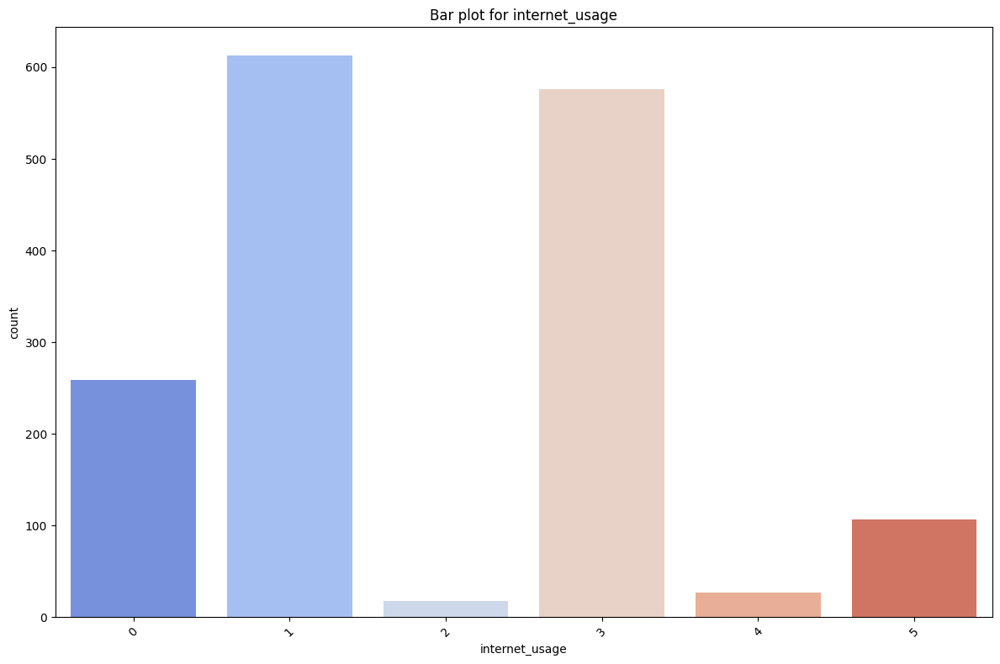

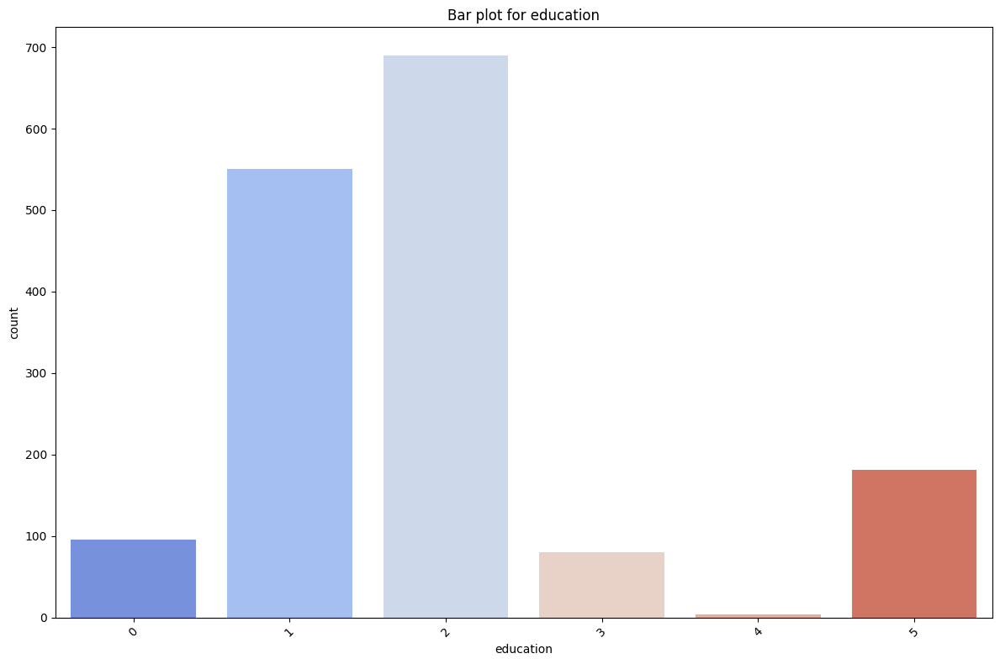

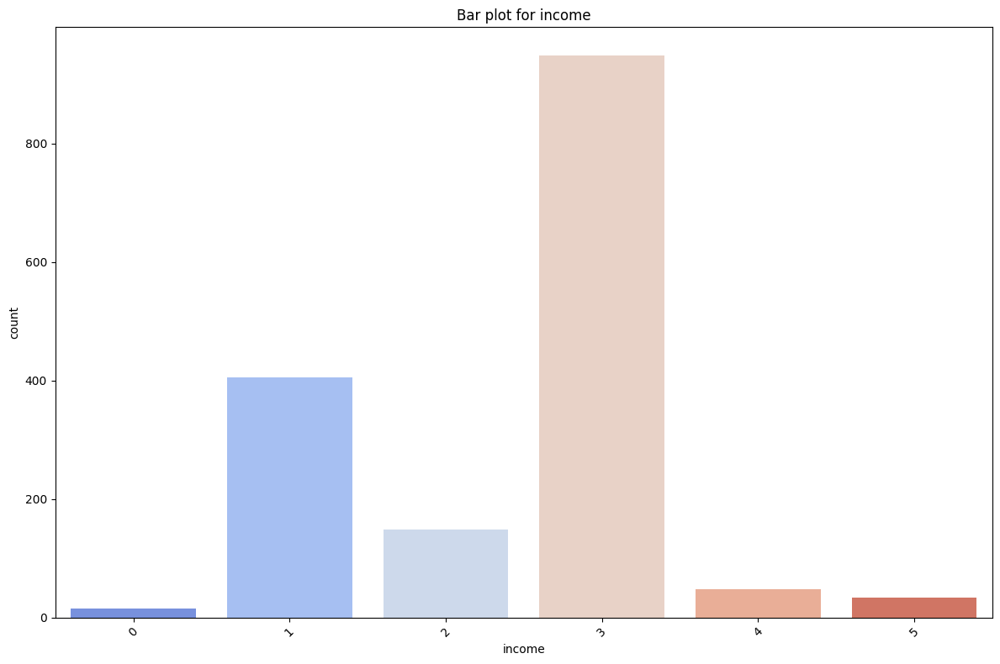

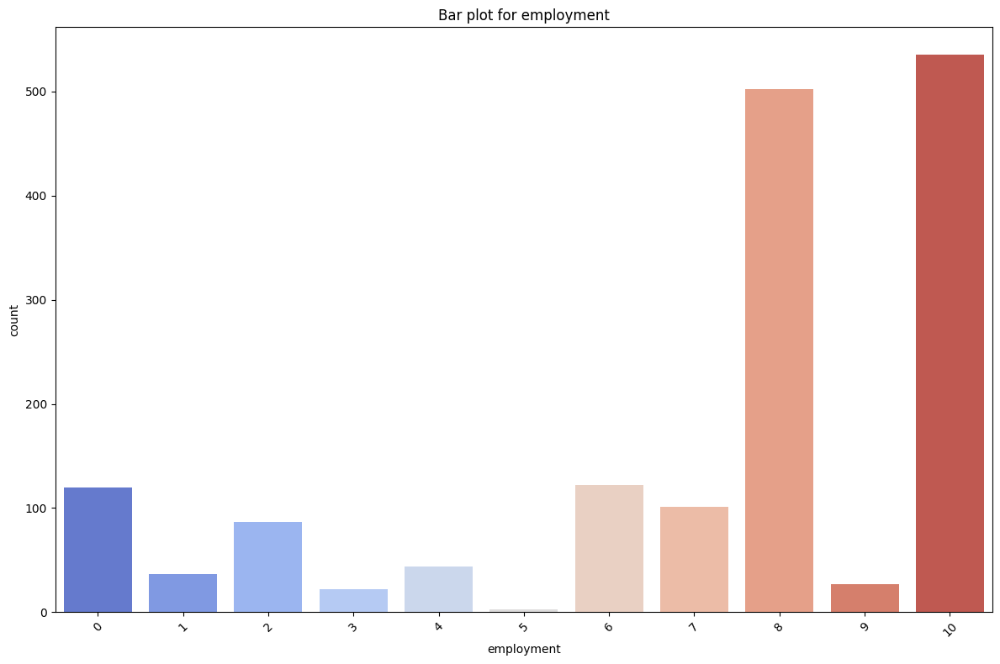

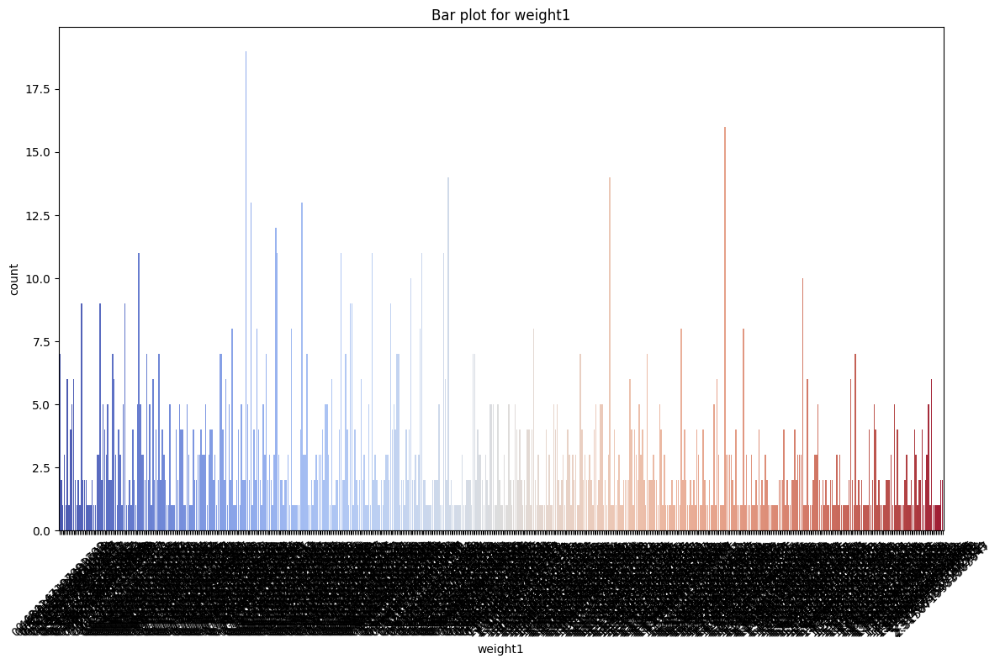

In [116]:
# Data Visualization - 12:
# Bar Plot

for col in numerical_cols:
    plt.figure(figsize=(12,8))
    sns.countplot(x=df[col], data=df, palette="coolwarm")
    plt.title(f'Bar plot for {col}')
    
    # Rotate x-axis labels for better readability
    plt.xticks(rotation=45)  
    
    # Ensure the plot fits in the figure area
    plt.tight_layout() 
    
    # Display the Plot
    plt.show()

Cell 39 - Insights:
1. The code has run successfully.
2. The required graphs have been successfully generated.
3. Such graphs can be used to compare with the original ones, in order to get idea of which categorical data has been encoded into what numerical data.
4. The graphs have been like their previous ones, suggesting that the data is not corrupted.

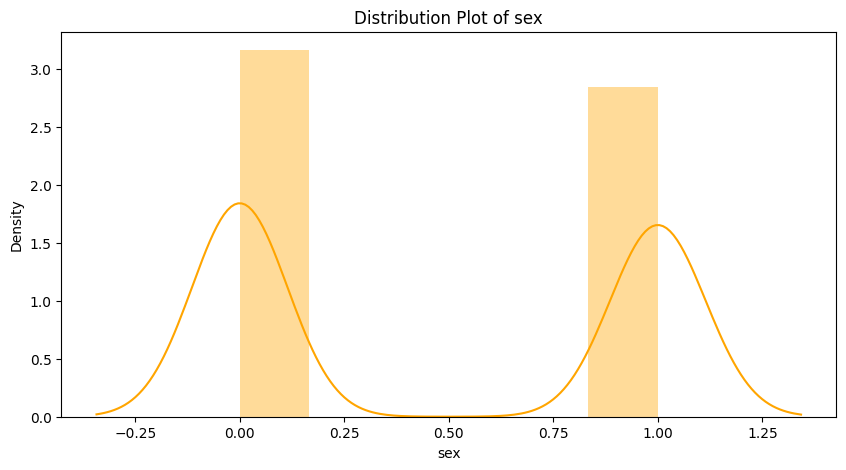

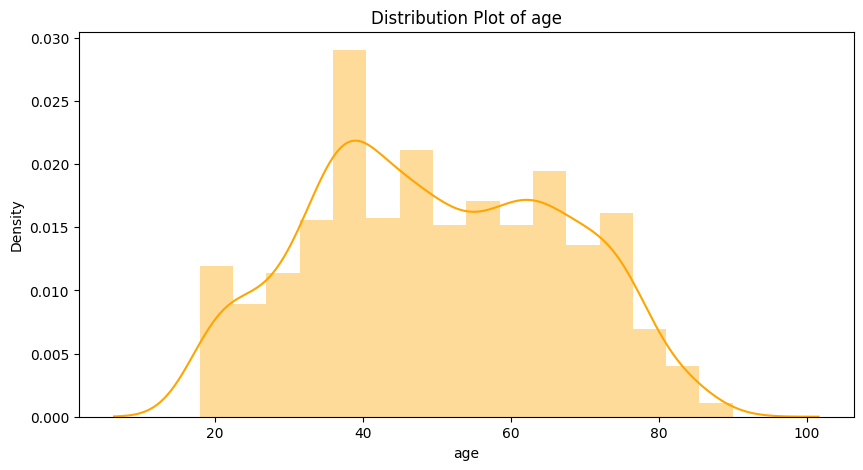

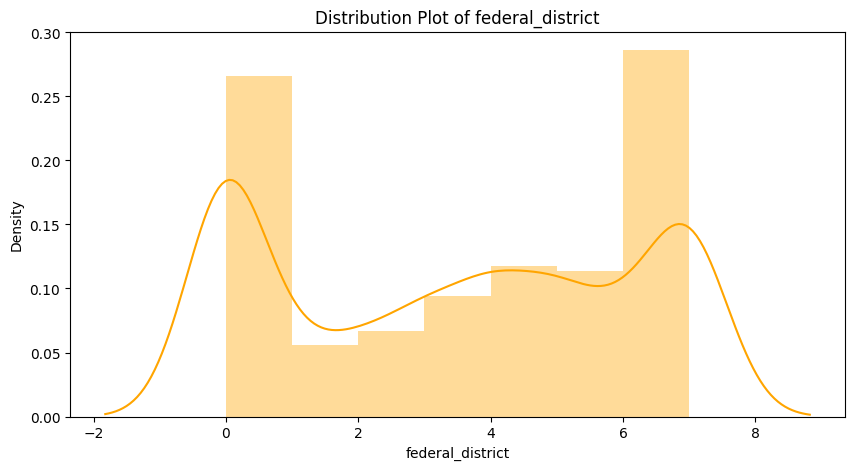

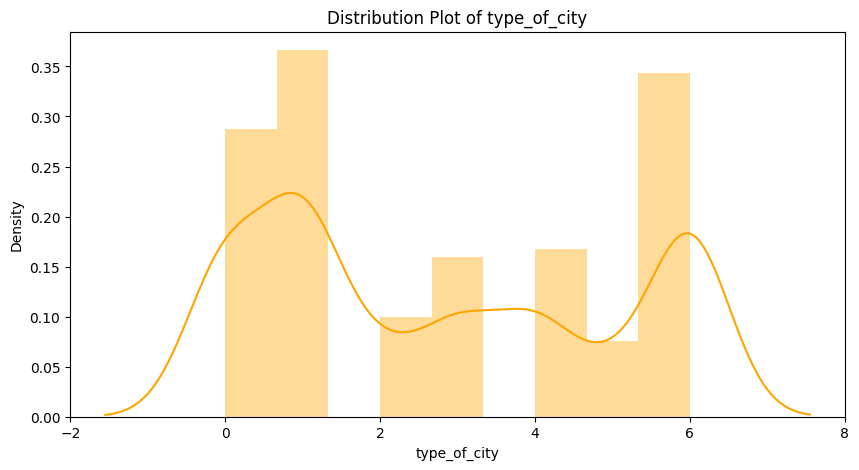

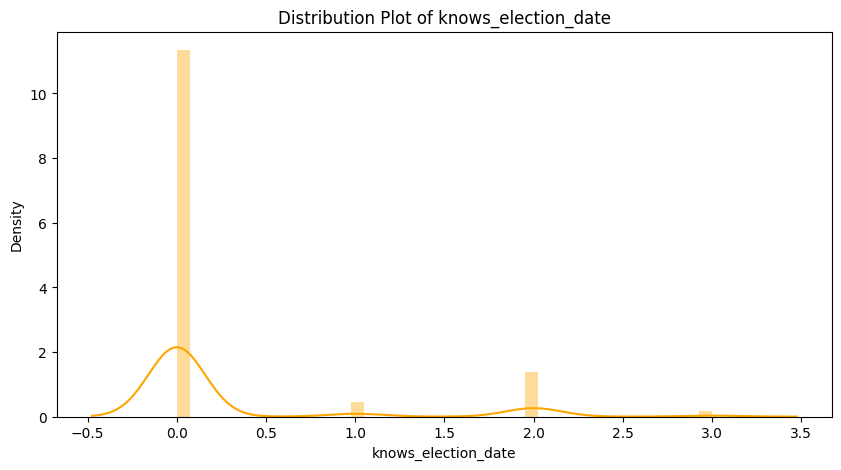

...

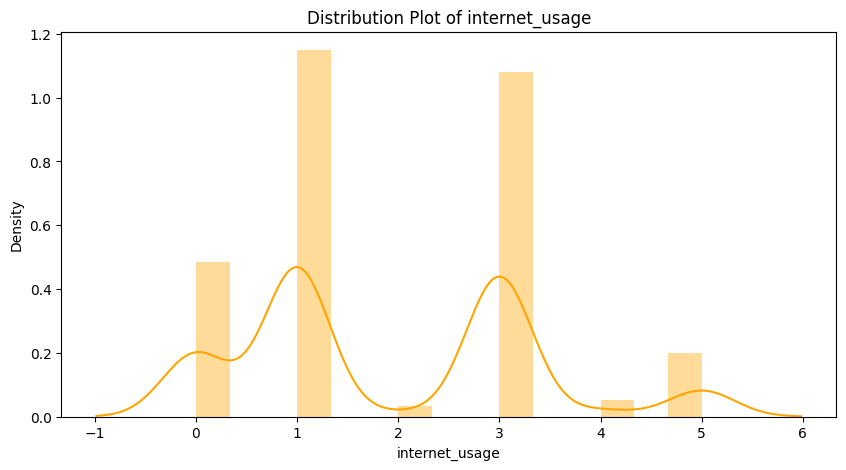

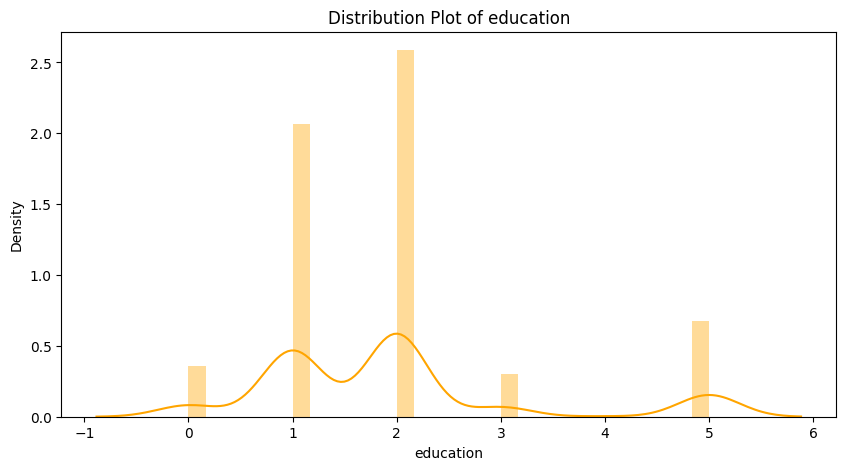

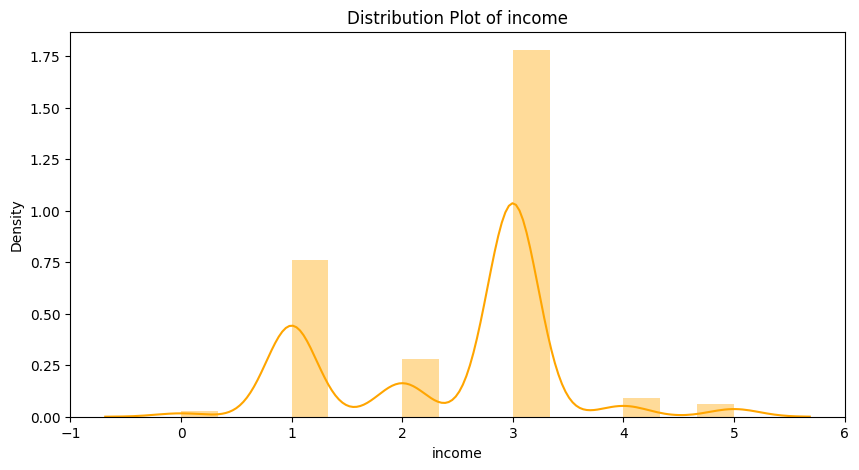

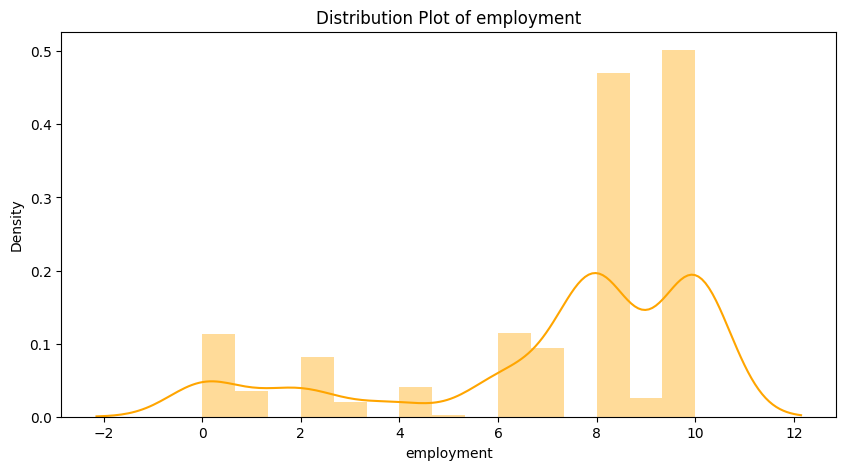

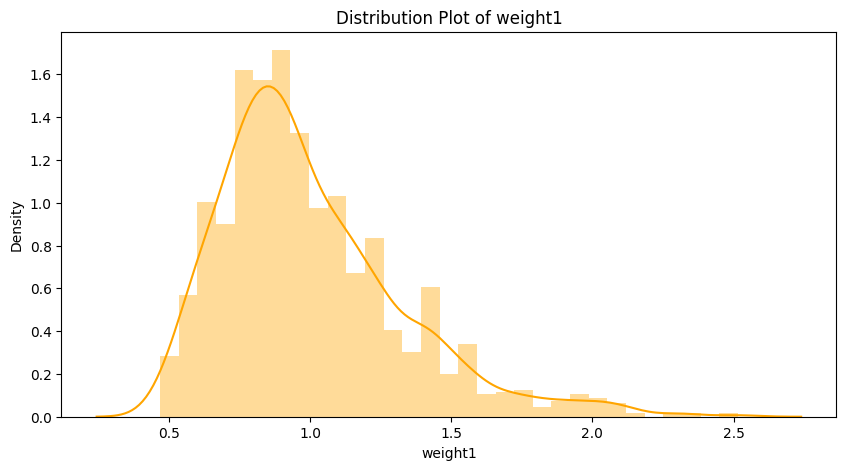

In [126]:
# Data Visualization - 13:
# Distribution Plot

for col in df.select_dtypes(include=['int64', 'float64']).columns:
    plt.figure(figsize=(10, 5))
    sns.distplot(df[col],color="Orange")
    plt.title(f'Distribution Plot of {col}')
    
    # Display the Plots
    plt.show()

Cell 40 - Insights:
1. The code has run successfully.
2. All the numerical data, including the original ones as well as the encoded ones have been visualized in the form of Distribution Plots.
3. The Distribution Plots generated are true to their nature.

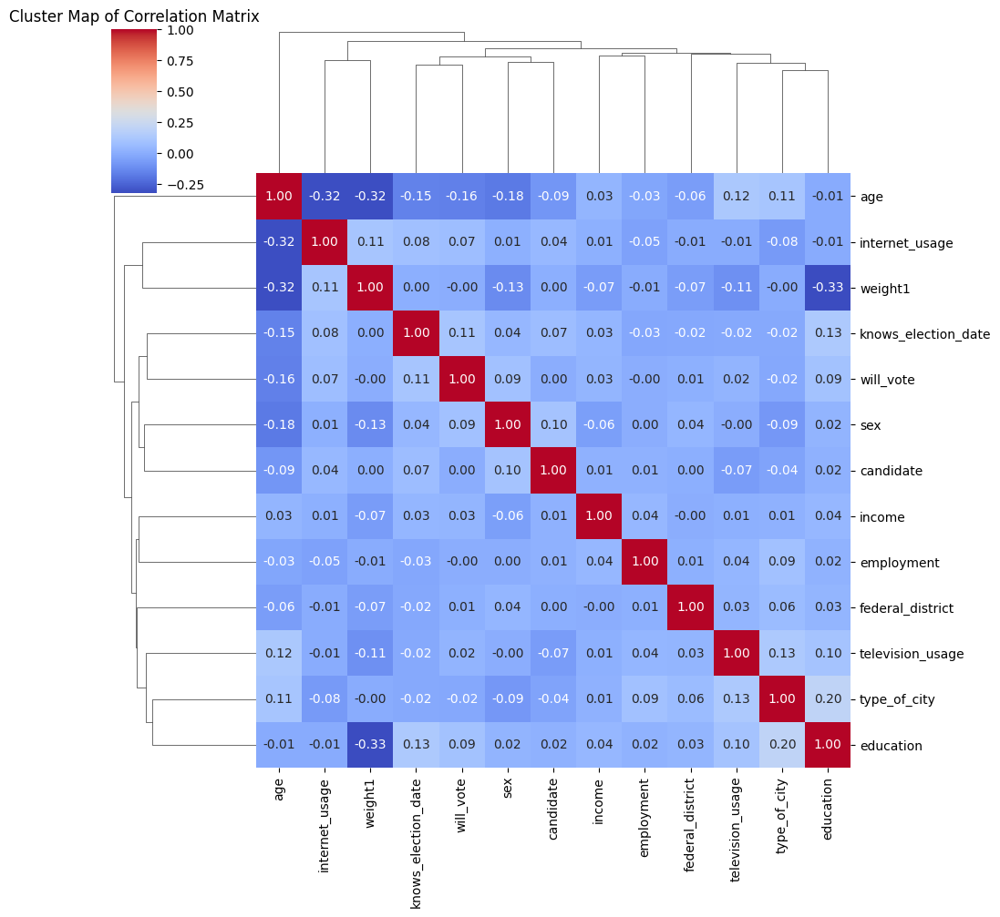

In [127]:
# Data Visualizatio - 14:
# Cluster Map

sns.clustermap(df.corr(), cmap='coolwarm', annot=True, fmt='.2f')
plt.title('Cluster Map of Correlation Matrix')

# Display the Plot
plt.show()

Cell 41 - Insights:
1. The code has run successfully.
2. The required Cluster Map has been generated successfully.

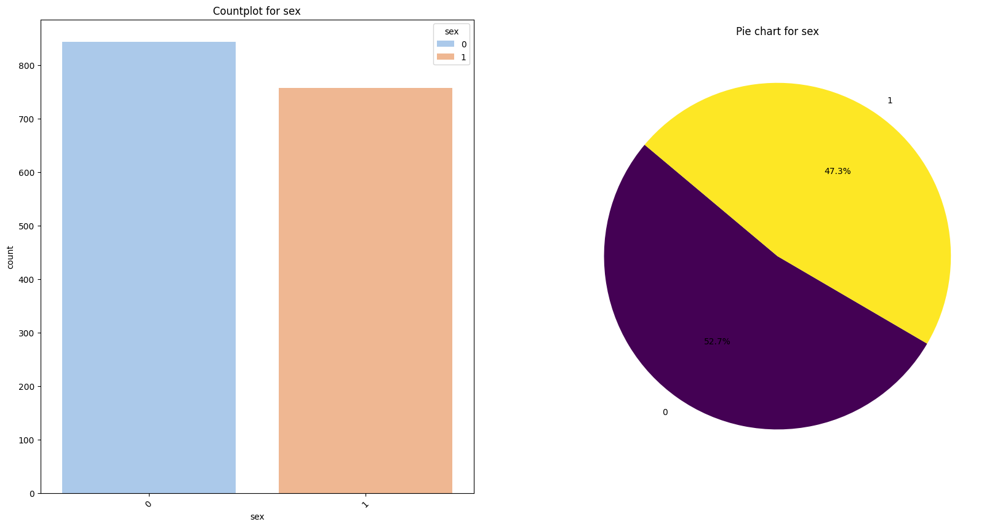

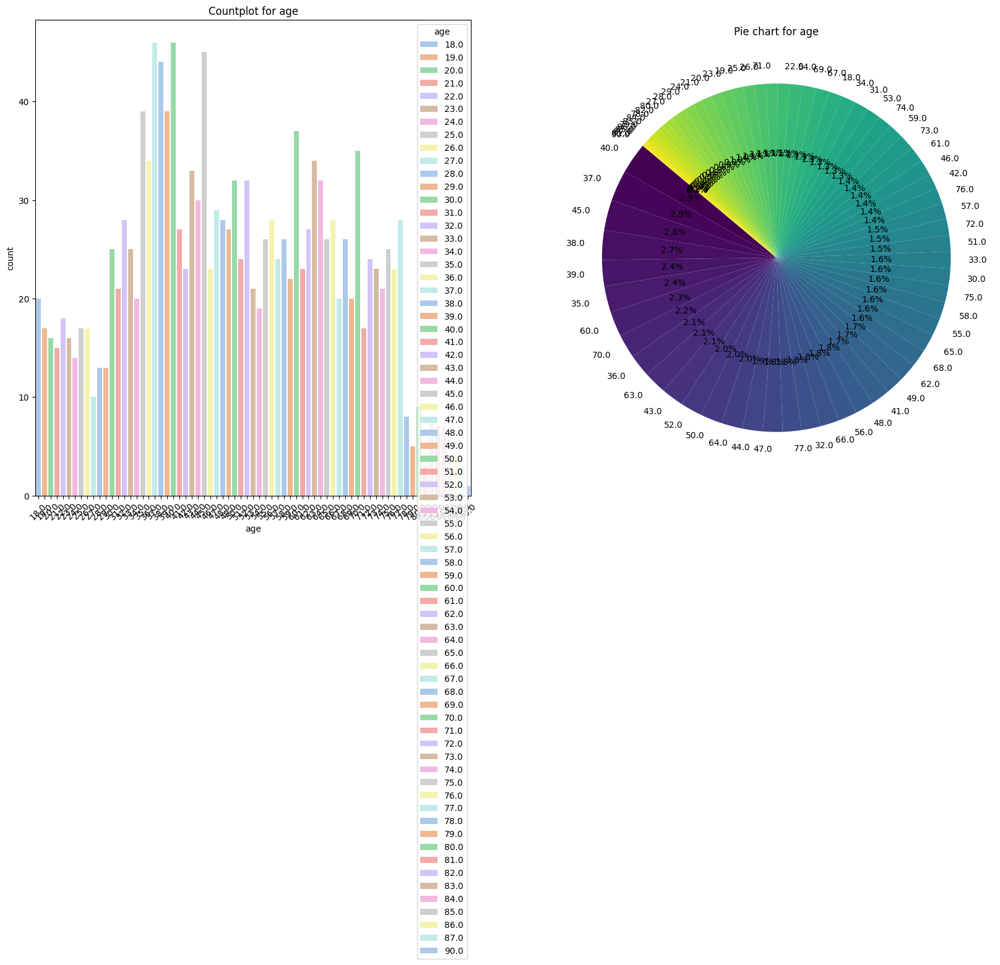

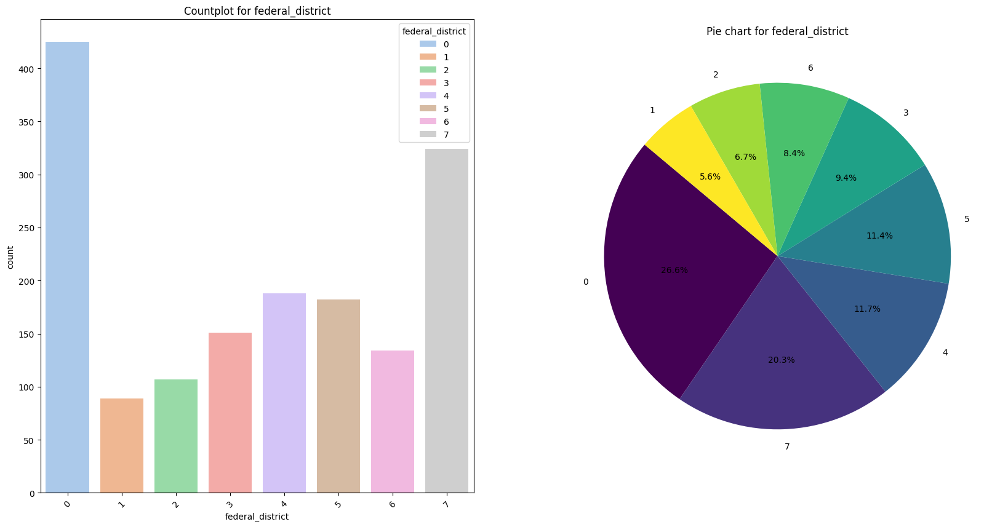

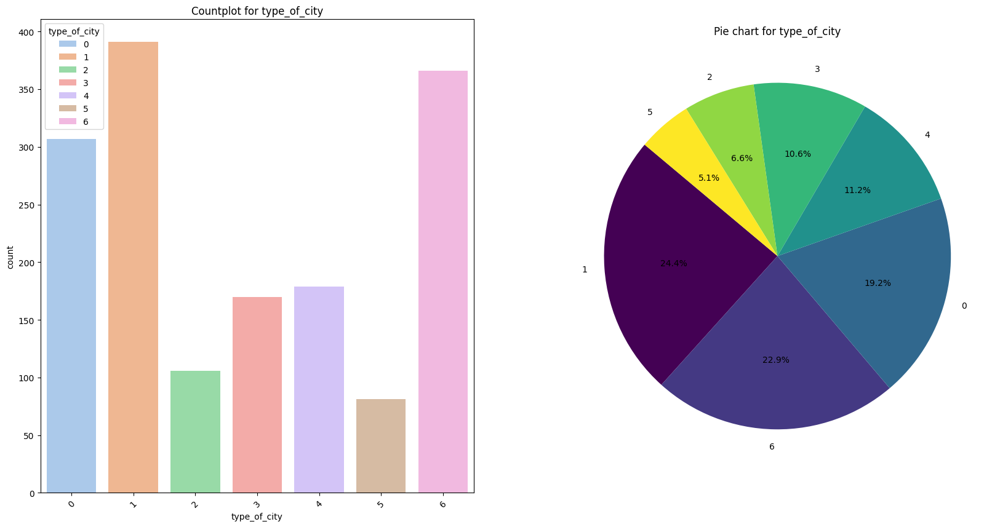

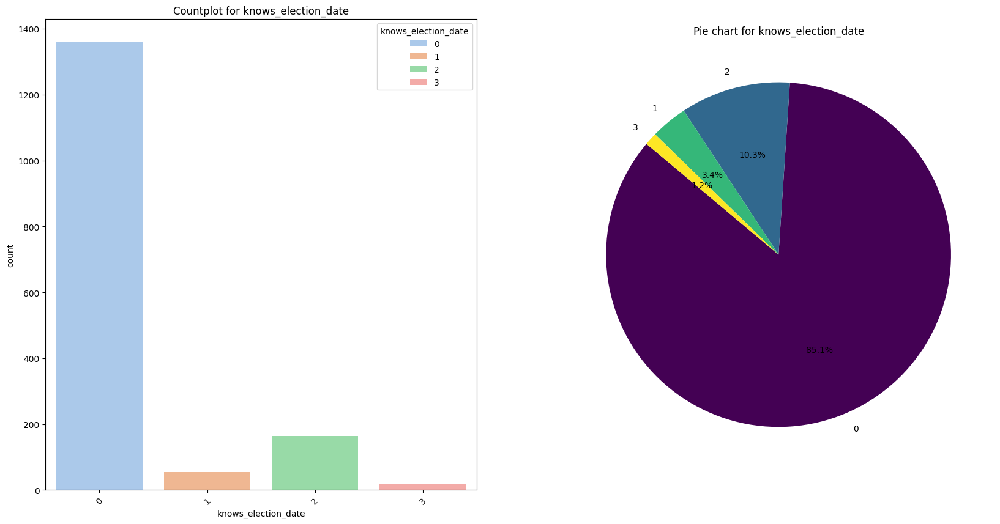

...

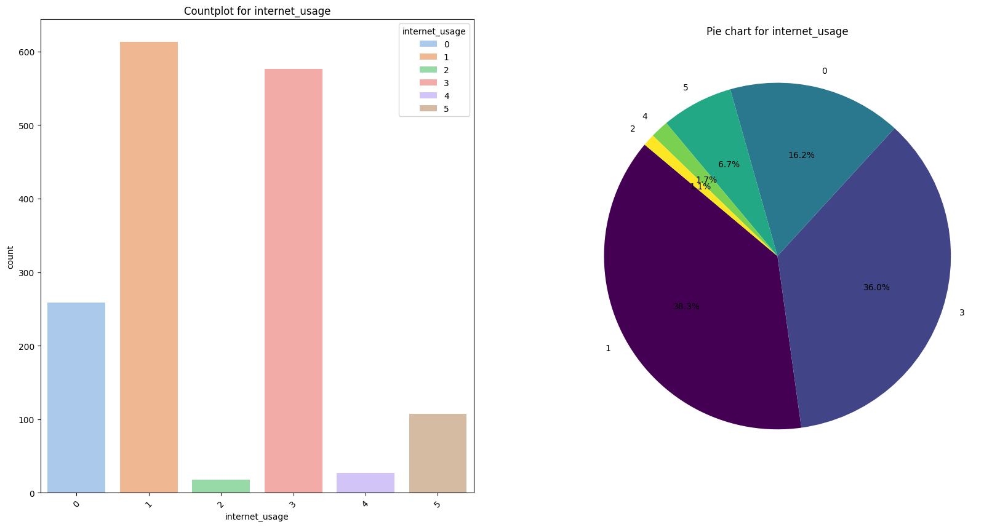

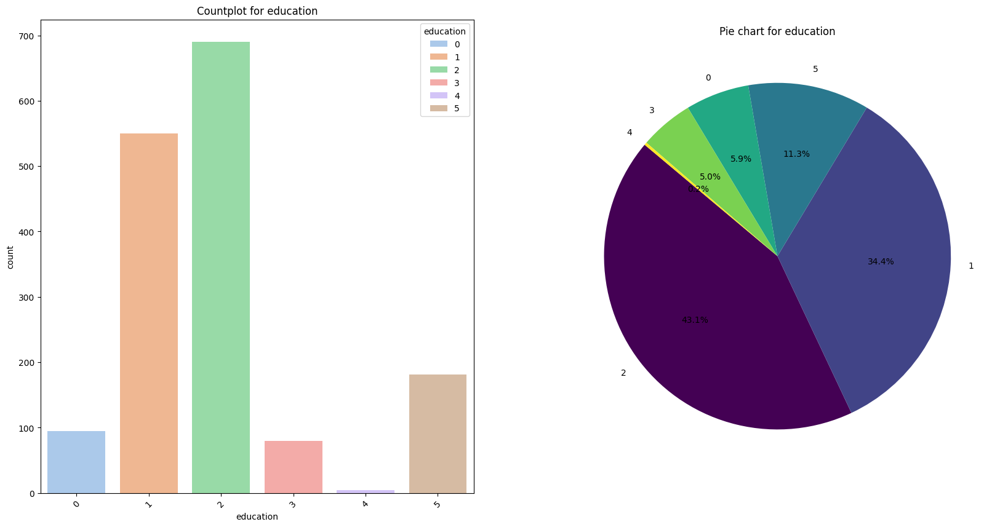

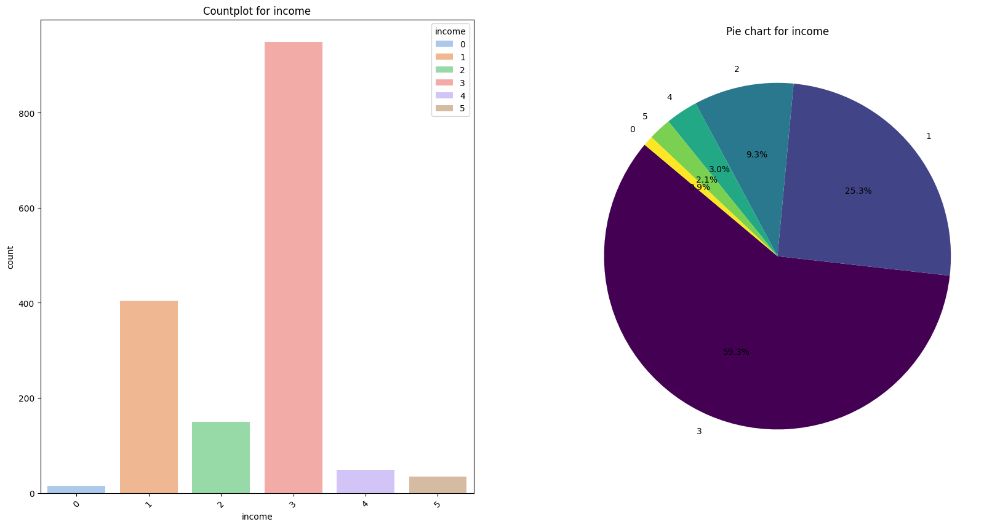

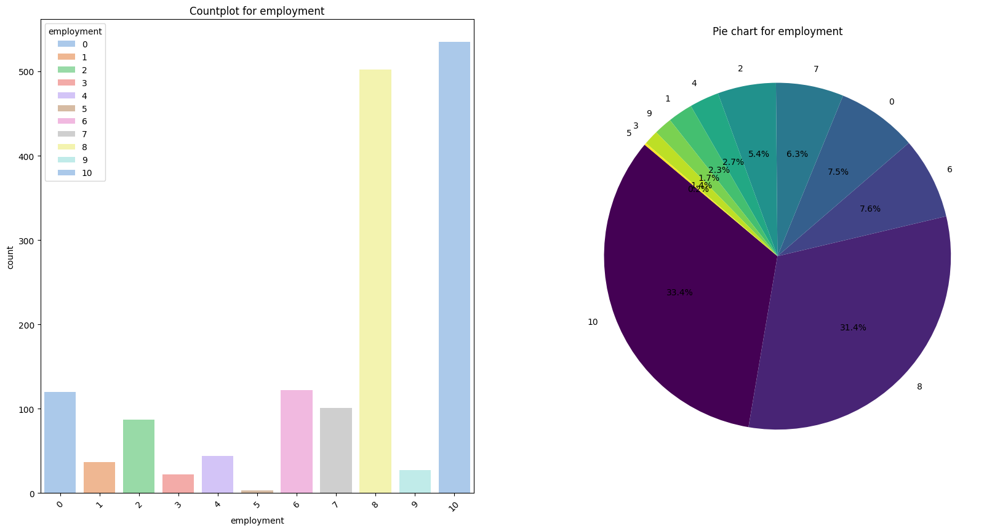

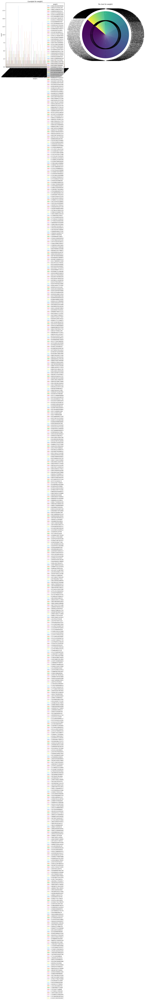

In [129]:
# Data Visualization - 15

# Univariate Analysis
# Collective Display of Coutnplots and Pie Charts

def univariate_categorical_analysis(data, numerical_cols):
    for col in numerical_cols:
        plt.figure(figsize=(20,10))
        plt.subplot(1, 2, 1)
        sns.countplot(x=col, data=data, hue=col, palette='pastel')
        plt.xticks(rotation=45)
        plt.title(f'Countplot for {col}')

        plt.subplot(1, 2, 2)
        data[col].value_counts().plot.pie(autopct='%1.1f%%', startangle=140, cmap='viridis')
        plt.title(f'Pie chart for {col}')
        plt.ylabel('')
        plt.show()

univariate_categorical_analysis(df, numerical_cols)

Cell 42 - Insights:
1. The code has run successfully.
2. All the required graphs have been successfully generated.
3. The encoded columns can be visualized clearly, while the original numerical columns are not at all good-looking in this setup!

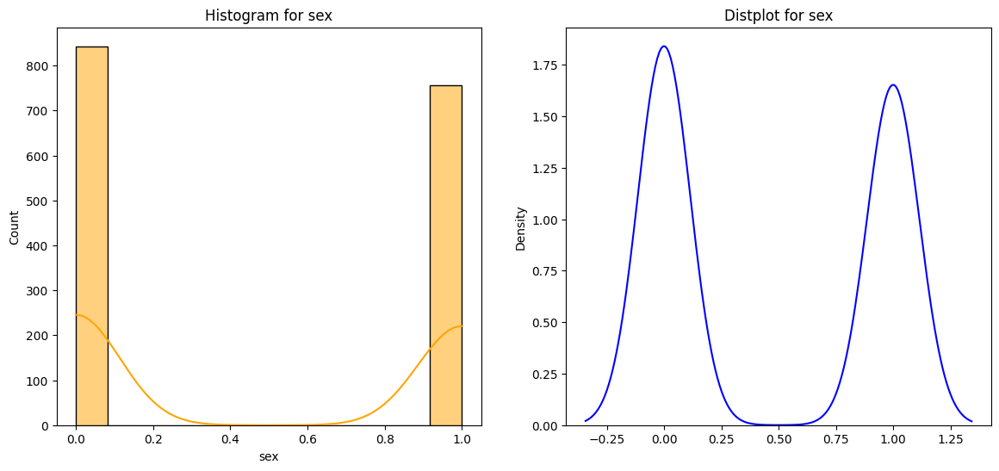

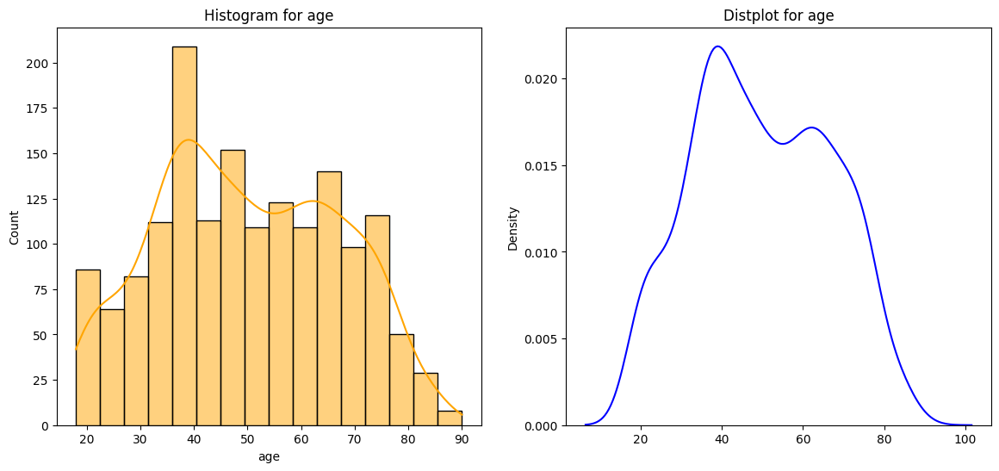

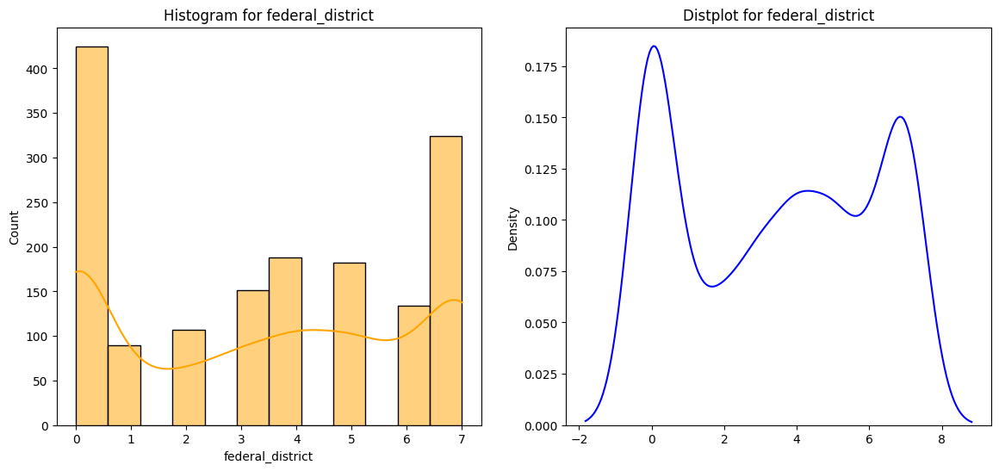

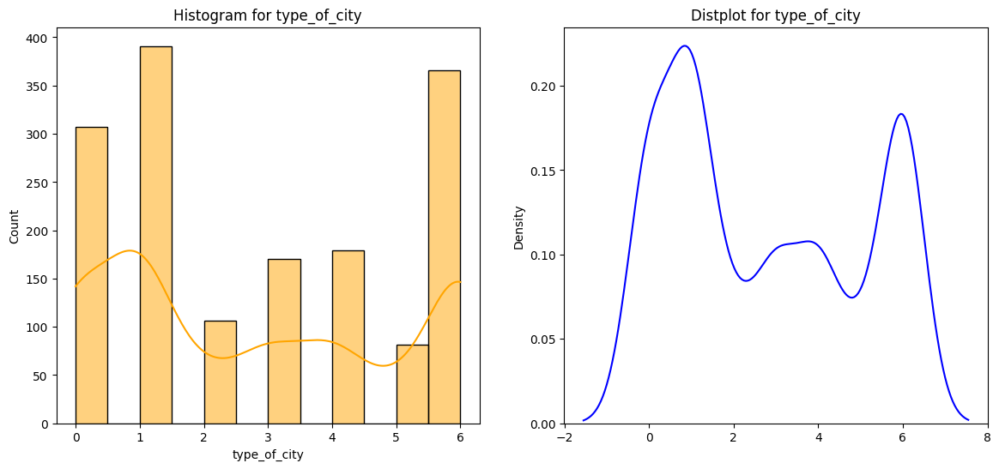

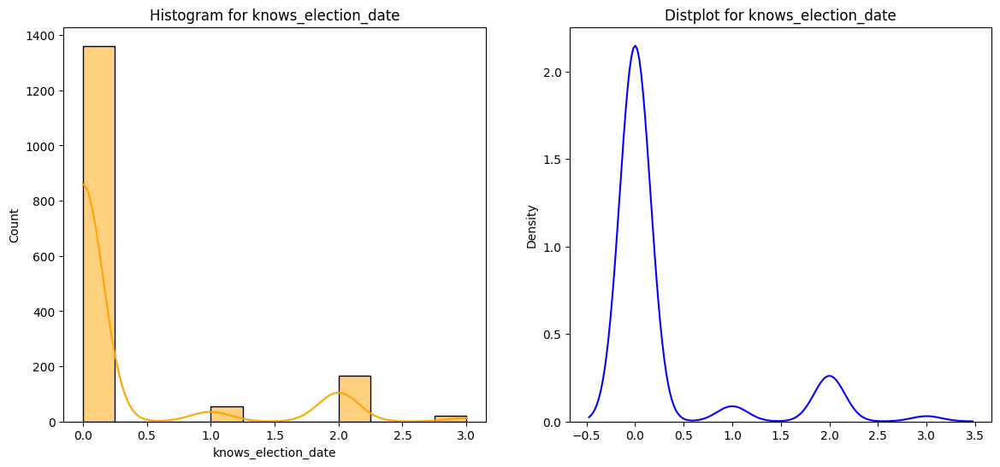

...

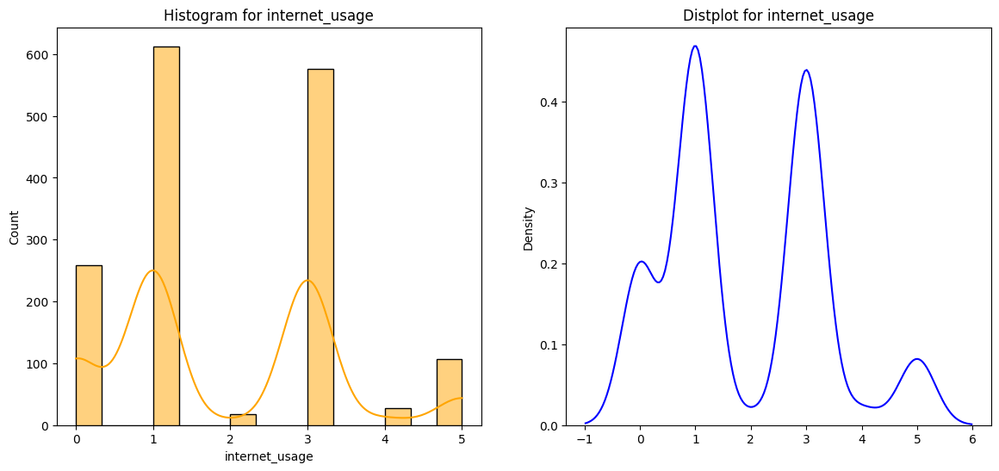

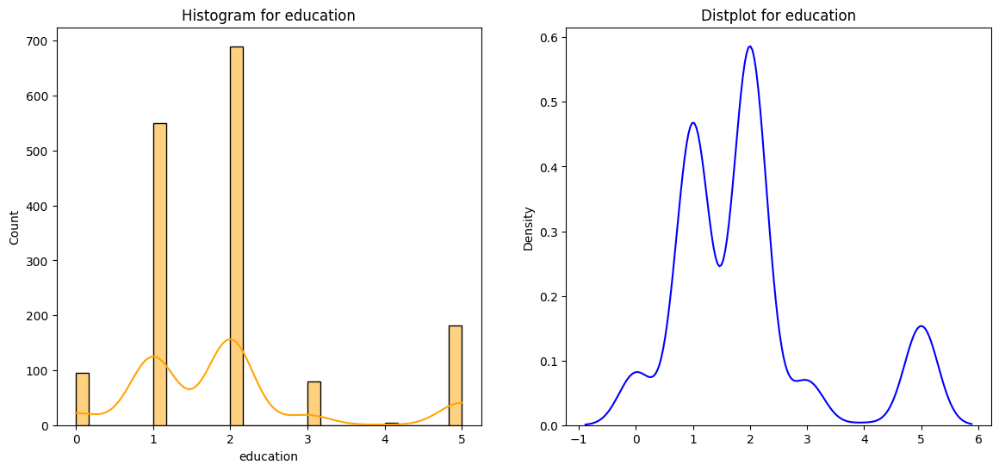

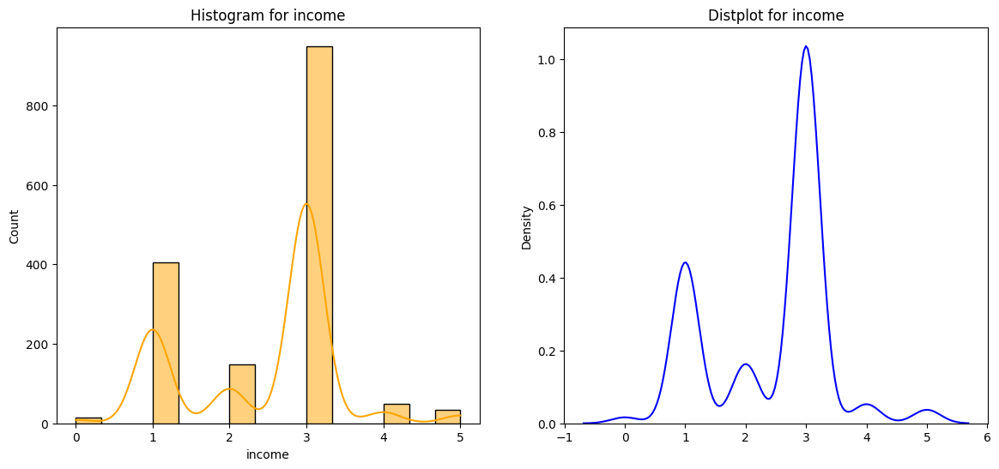

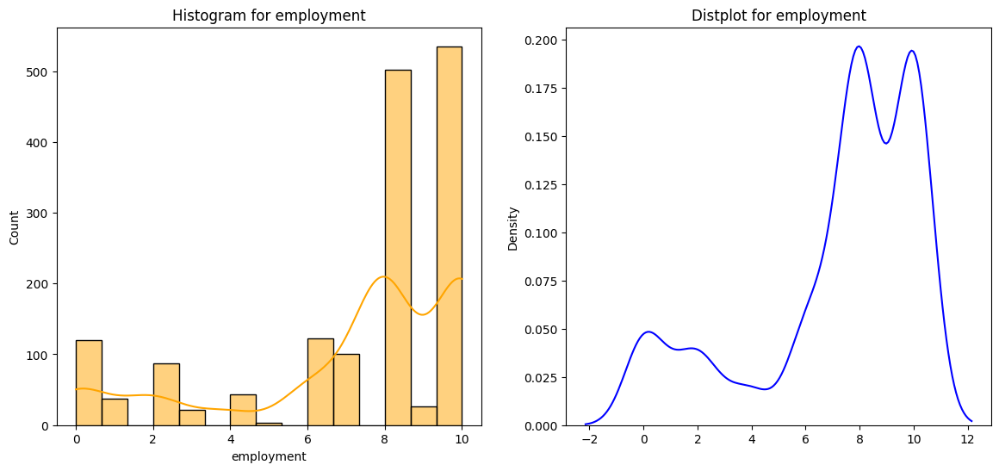

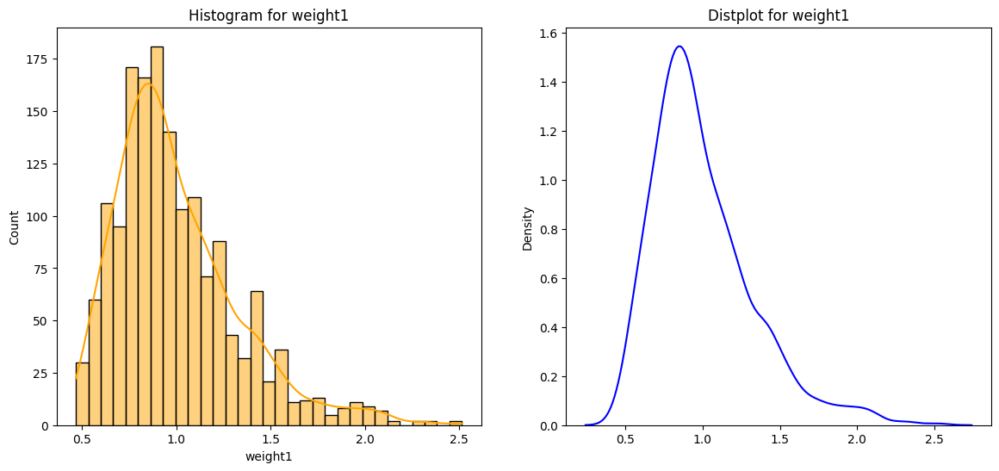

In [130]:
# Data Visualization - 16

# Univariate Analysis
# Collective Display of Histograms and Distplots

def univariate_numerical_analysis(data, numerical_cols):
    for col in numerical_cols:
        plt.figure(figsize=(14, 6))
        plt.subplot(1, 2, 1)
        sns.histplot(data[col], kde=True, color="orange")
        plt.title(f'Histogram for {col}')

        plt.subplot(1, 2, 2)
        sns.distplot(x=data[col], hist=False, color="blue")
        plt.title(f'Distplot for {col}')
        plt.show()

univariate_numerical_analysis(df, numerical_cols)

Cell 43 - Insights:
1. The code has run successfully.
2. All the required Histograms and Distribution Plots have been generated successfully.
3. The nature of the data as well as the nature of the distribution of data in each column, can be visualized very clearly from the above generated graphs.

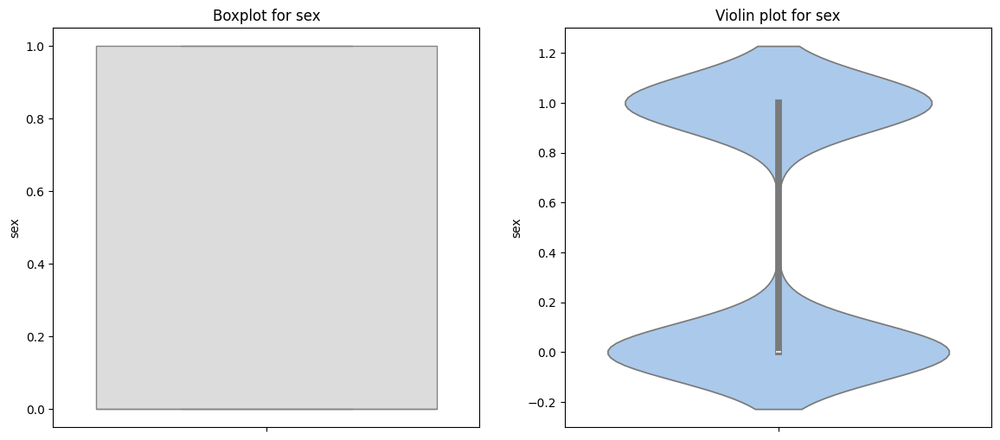

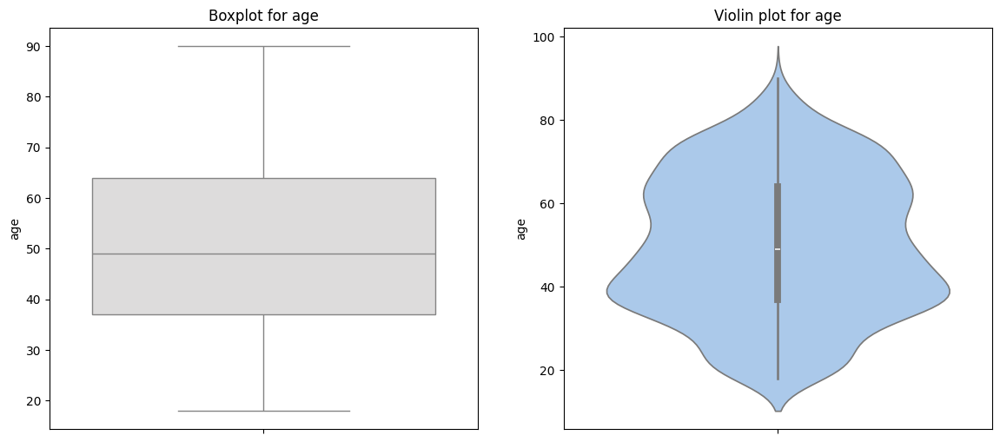

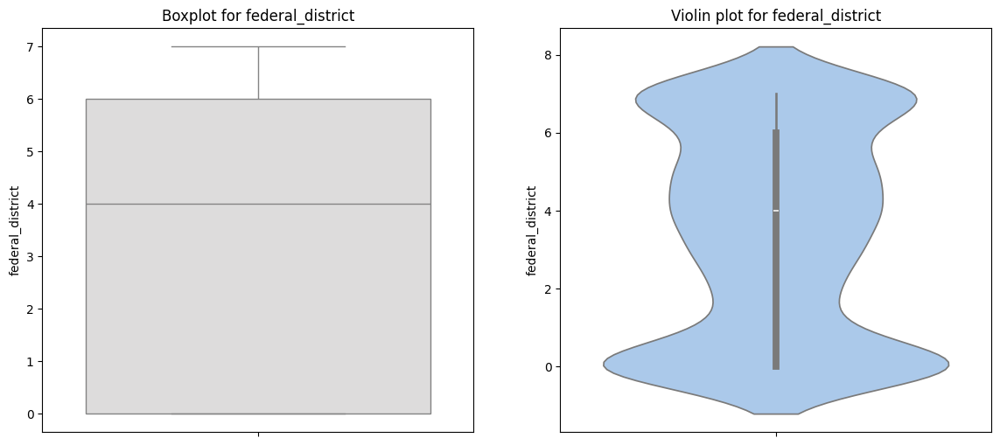

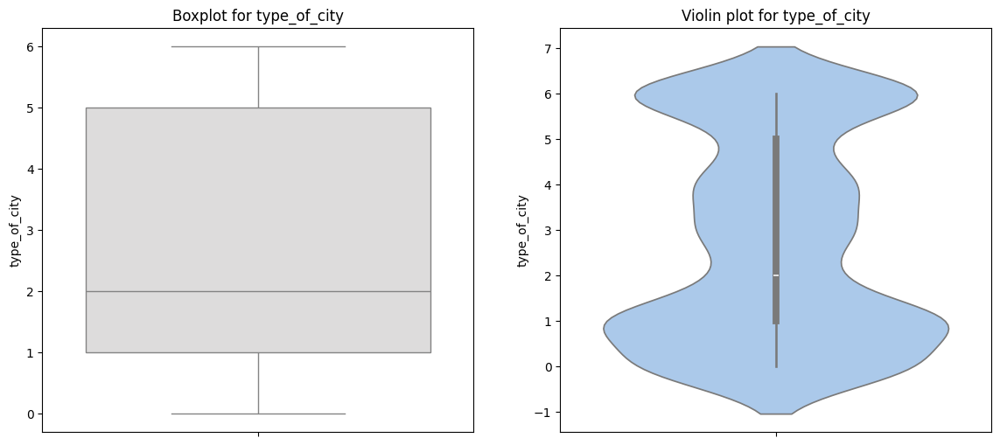

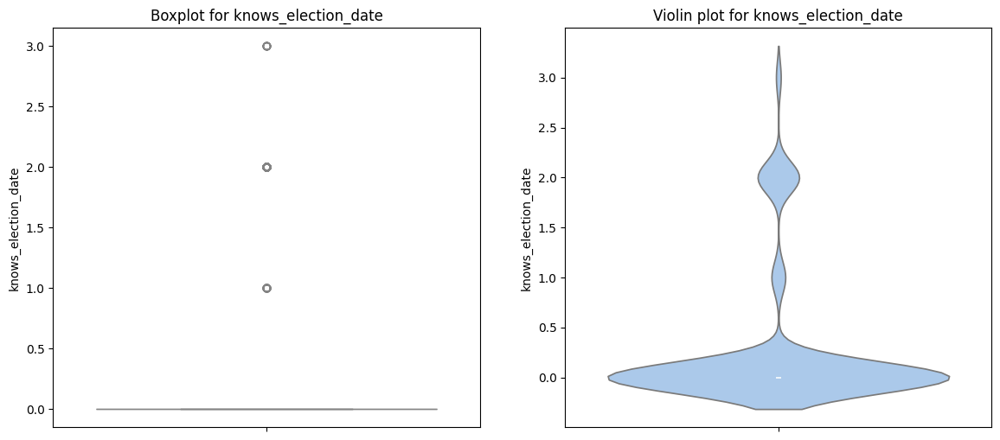

...

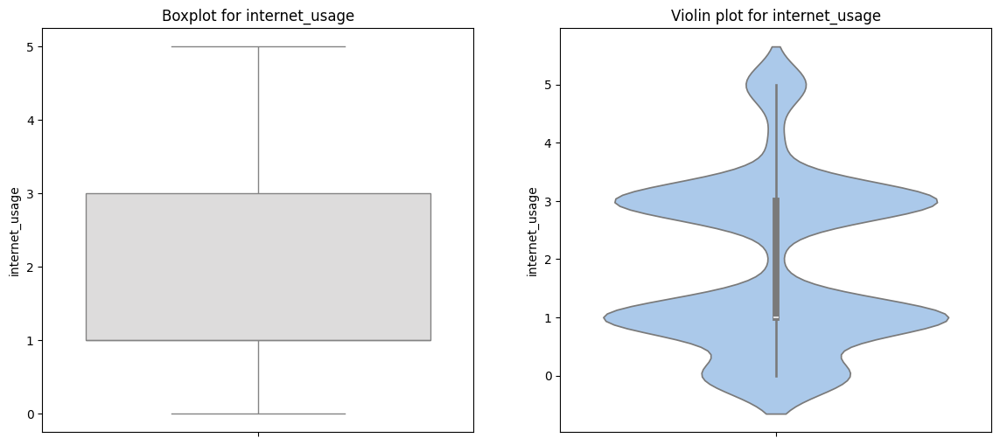

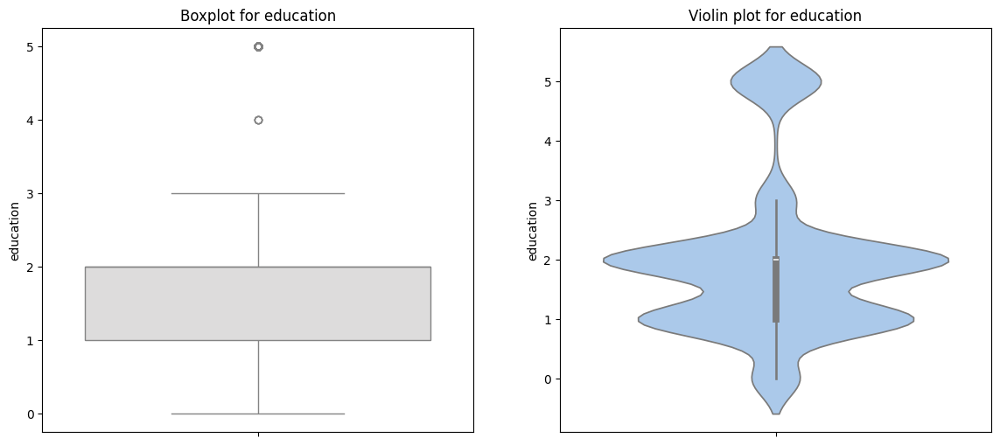

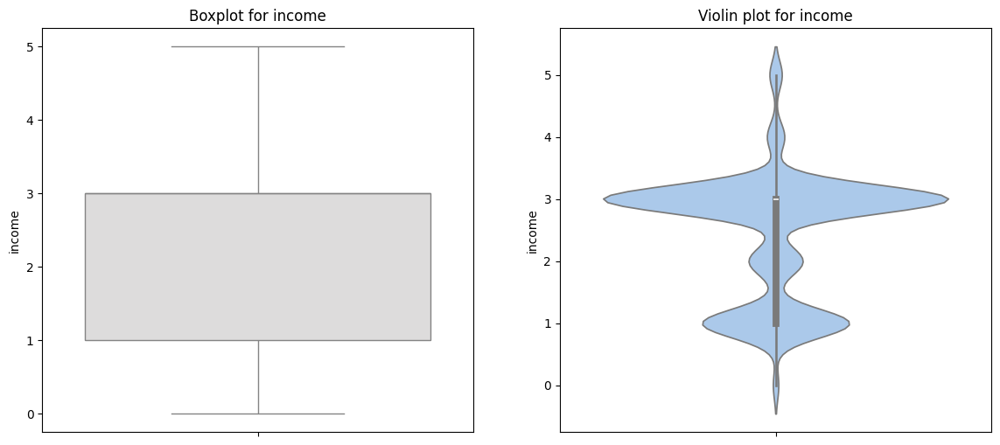

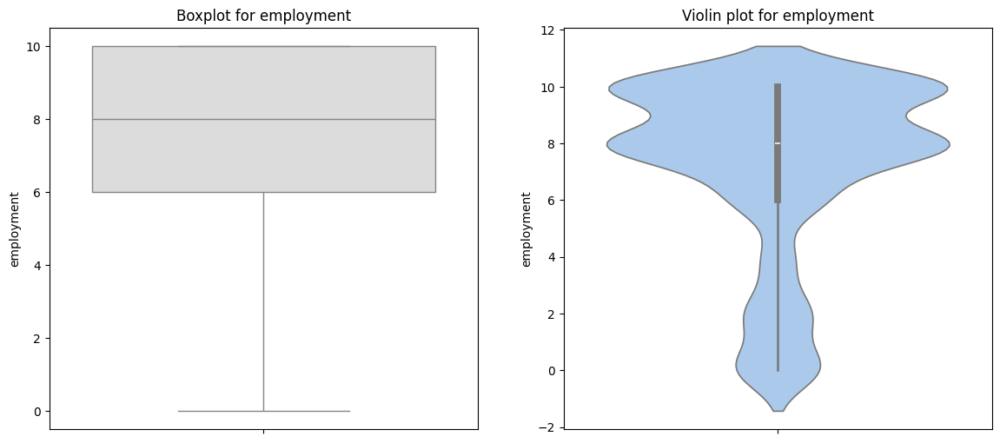

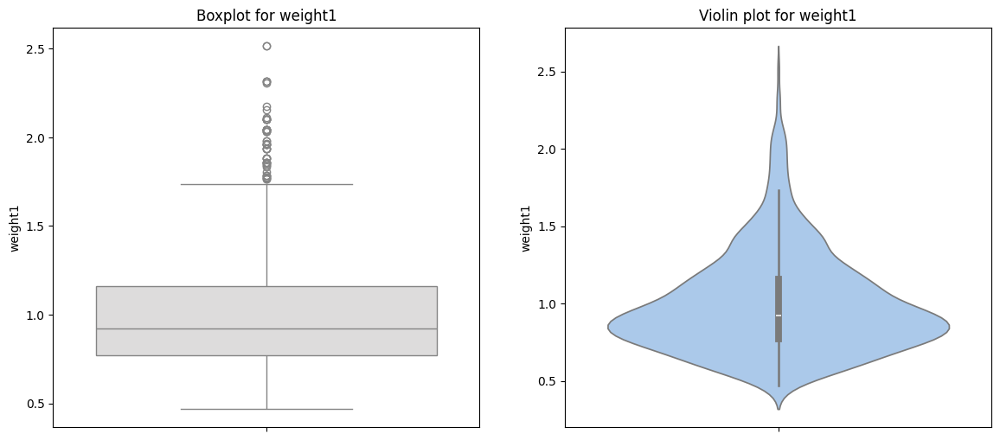

In [131]:
# Data Visualization - 17

# Univariate Analysis
# Checking for Outliers
# Box Plot and Violin Plot

def check_outliers(data, numerical_cols):
    for col in numerical_cols:
        plt.figure(figsize=(14, 6))
        plt.subplot(1, 2, 1)
        sns.boxplot(y=data[col], palette="coolwarm")
        plt.title(f'Boxplot for {col}')

        plt.subplot(1, 2, 2)
        sns.violinplot(y=data[col], palette="pastel")
        plt.title(f'Violin plot for {col}')
        plt.show()

check_outliers(df, numerical_cols)

Cell 44 - Insights:
1. The code has run successfully.
2. All the required graphs have been generated successfully.
3. All the encoded data have been visualized in the form of a Box Plot as well as a Violin Plot.

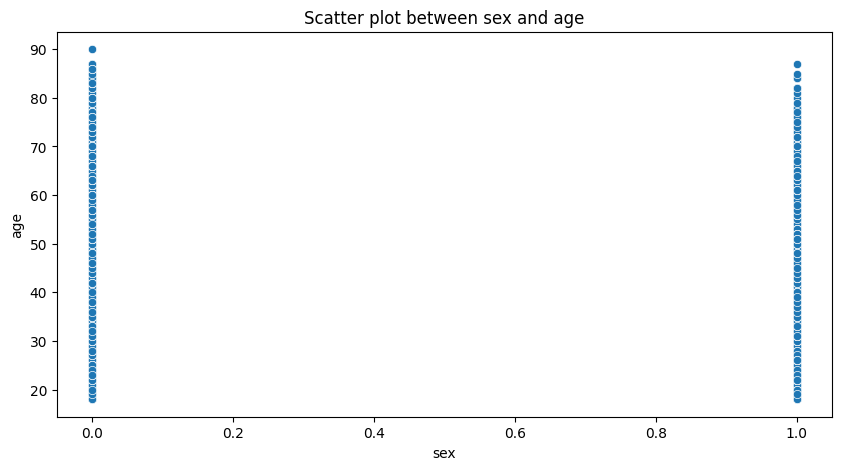

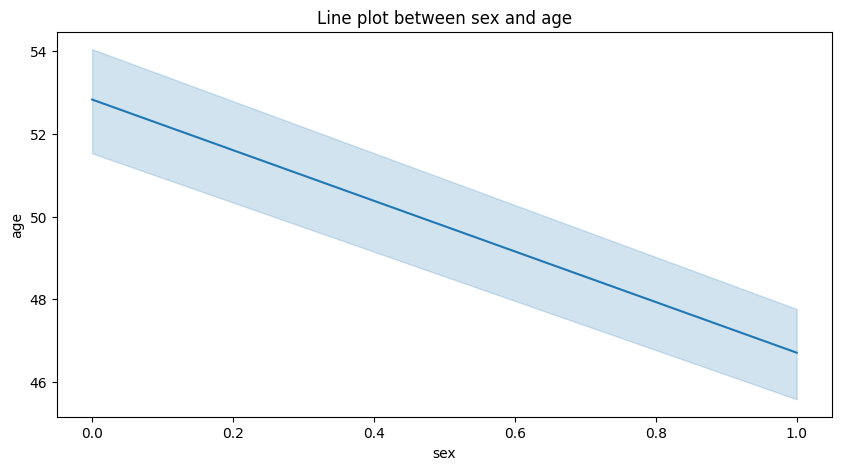

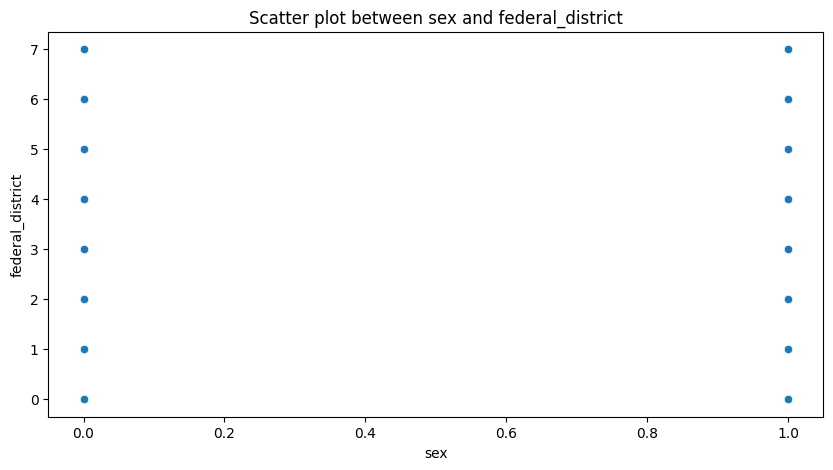

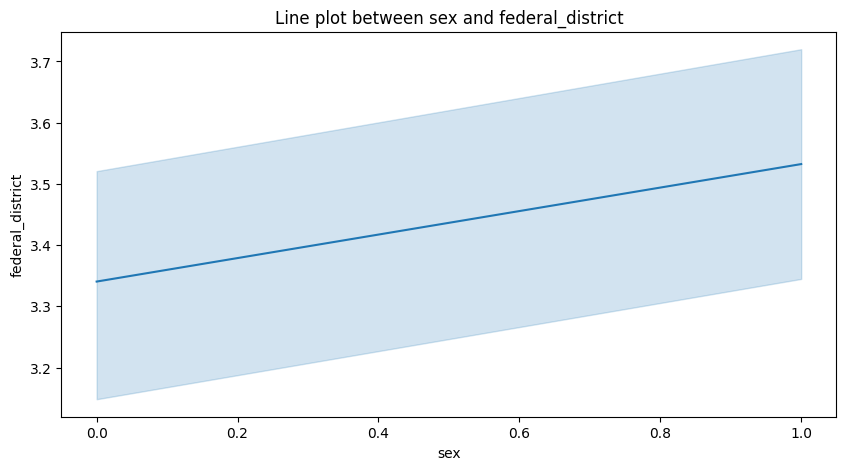

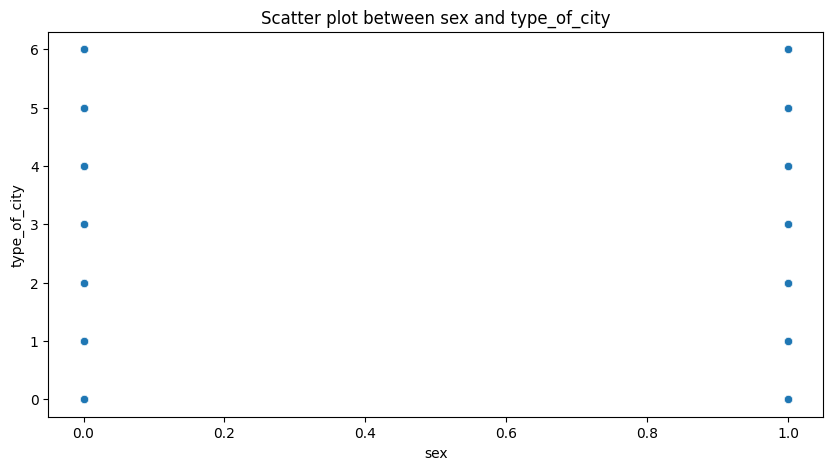

...

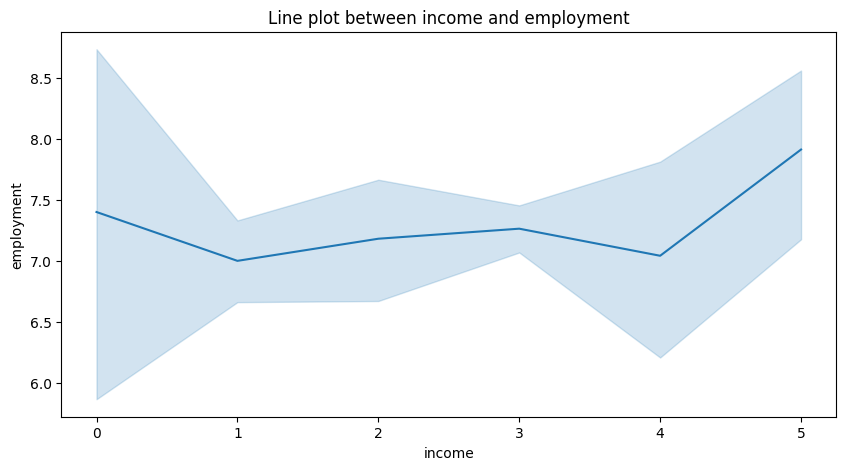

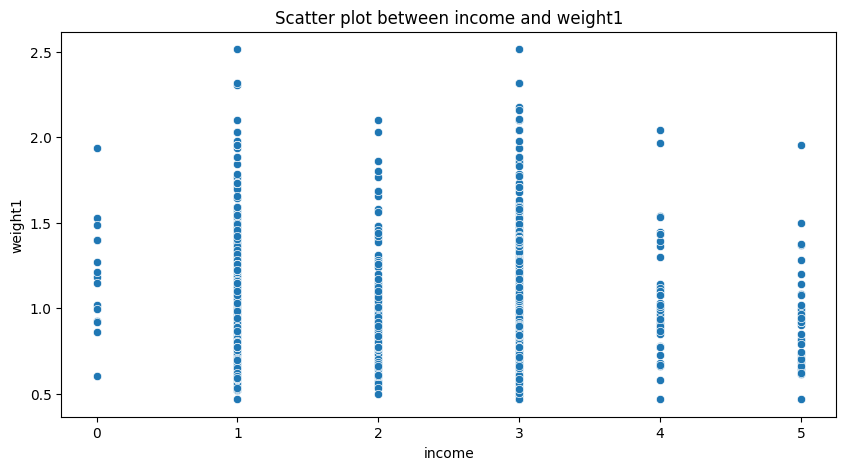

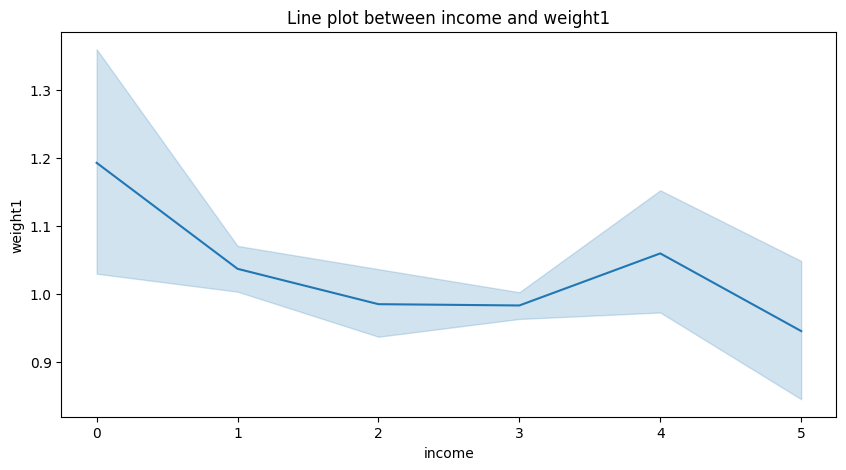

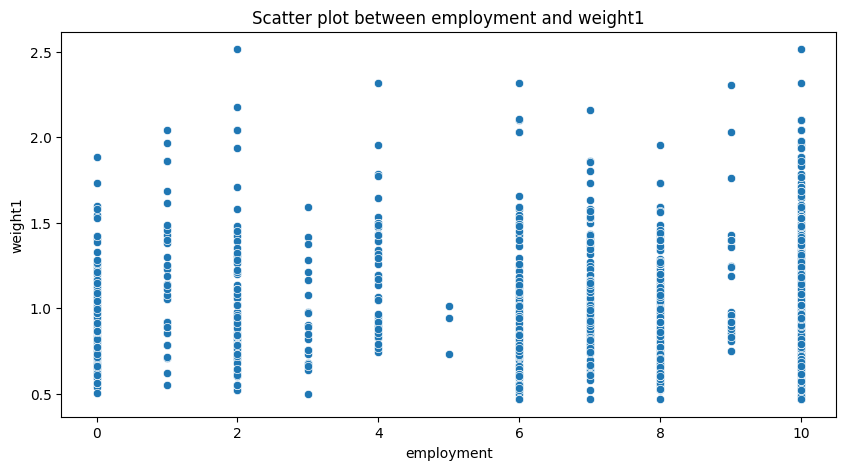

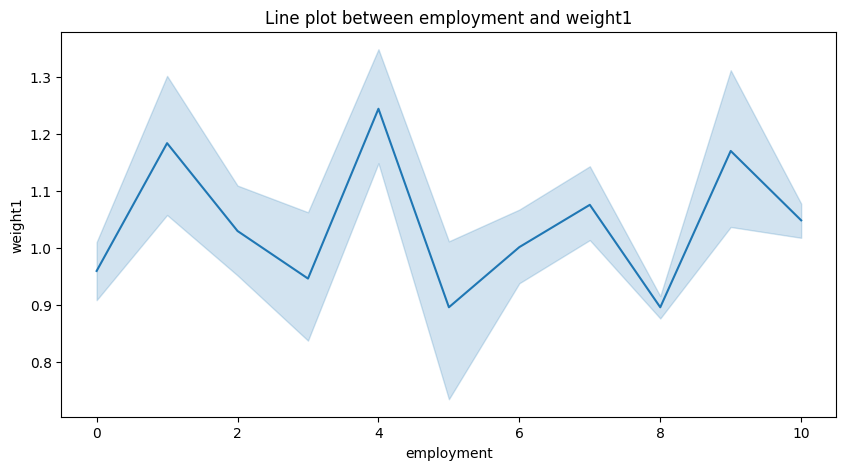

In [132]:
# Data Visualization - 18:

# Multivariate Analysis
# Visualizing Numerical - Numerical Data
# Scatter Plot and Line Plot

def multivariate_numerical_numerical(data, numerical_cols):
    for i in range(len(numerical_cols)):
        for j in range(i + 1, len(numerical_cols)):
            plt.figure(figsize=(10, 5))
            sns.scatterplot(x=data[numerical_cols[i]], y=data[numerical_cols[j]])
            plt.title(f'Scatter plot between {numerical_cols[i]} and {numerical_cols[j]}')
            plt.show()

            plt.figure(figsize=(10, 5))
            sns.lineplot(x=data[numerical_cols[i]], y=data[numerical_cols[j]])
            plt.title(f'Line plot between {numerical_cols[i]} and {numerical_cols[j]}')
            plt.show()

multivariate_numerical_numerical(df, numerical_cols)

Cell 45 - Insights:
1. The code has run successfully.
2. All the required graphs have been generated successfully.
3. All the columns have been visualized in the form of Scatter Plot as well as Line Plot, in an alternative fashion.

# Machine Learning Model

In [134]:
# Separation of Features and Target
x = df.drop('candidate', axis=1)
y = df['candidate']

Cell 46 - Insights:
1. The code has run successfully.
2. The Feature and Target Separation has also been done successfully.
3. Here, the 'candidate' column has been selected as the target.

In [135]:
# Visualize the Feature
x

,sex,age,federal_district,type_of_city,knows_election_date,will_vote,television_usage,internet_usage,education,income,employment,weight1
0,1,18.0,2,6,0,4,5,3,3,4,2,1.445172
1,1,23.0,2,6,0,4,2,3,2,4,10,1.445172
2,1,20.0,7,4,0,1,5,3,2,4,10,1.301691
3,1,22.0,3,0,2,4,5,3,2,4,7,1.538628
4,1,21.0,5,0,0,1,0,3,1,4,1,1.967015
...,...,...,...,...,...,...,...,...,...,...,...,...
1595,1,61.0,0,5,0,0,3,1,1,0,8,1.270761
1596,0,80.0,7,6,0,3,5,0,2,0,8,0.921724
1597,0,76.0,3,2,0,1,0,3,1,0,8,1.396691
1598,0,74.0,0,4,2,1,3,3,0,0,0,0.995849


Cell 47 - Insights:
1. The code has run successfully.
2. The Feature x has been successfully visualized.
3. The column 'candidate' has been dropped successfully.

In [137]:
# Standardize the Feature

# Creating Instance of Object
standard_scaler = StandardScaler()

x_scaled = standard_scaler.fit_transform(x)
x_scaled

array([[ 1.05527548, -1.89010881, -0.53864761, ...,  1.55735729,
        -1.66284938,  1.36145837],
       [ 1.05527548, -1.59418978, -0.53864761, ...,  1.55735729,
         0.89661094,  1.36145837],
       [ 1.05527548, -1.7717412 ,  1.34309077, ...,  1.55735729,
         0.89661094,  0.92265208],
       ...,
       [-0.94761986,  1.54255191, -0.16229994, ..., -2.44870647,
         0.25674586,  1.21318972],
       [-0.94761986,  1.4241843 , -1.29134297, ..., -2.44870647,
        -2.30271445, -0.01269589],
       [-0.94761986,  1.54255191,  0.96674309, ..., -2.44870647,
         0.25674586, -0.4256019 ]])

Cell 48 - Insights:
1. The code has run successfully.
2. The Feature has been scaled successfully.

In [138]:
# Visualize the Target
y

0       2
1       2
2       2
3       0
4       2
       ..
1595    6
1596    5
1597    2
1598    2
1599    2
Name: candidate, Length: 1600, dtype: int64

Cell 49 - Insights:
1. The code has run successfully.
2. The Target (y), i.e., the 'candidate' column of the dataset has been visualized successfully, in encoded form.

In [139]:
# Train - Test Split
x_train, x_test, y_train, y_test = train_test_split(x_scaled, y, test_size=0.2, random_state=42)

Cell 50 - Insights:
1. The code has run successfully.
2. This implies that the dataset has been splitted successfully into train-test datasets.

In [140]:
# Visualize x-train
x_train

array([[-0.94761986,  0.89153005, -1.29134297, ..., -0.44567459,
         0.25674586, -0.70093932],
       [-0.94761986,  1.12826527,  1.34309077, ...,  0.55584135,
         0.25674586, -1.06853965],
       [-0.94761986, -0.52888128, -1.29134297, ...,  0.55584135,
         0.89661094,  0.03576771],
       ...,
       [-0.94761986, -0.23296225,  1.34309077, ...,  0.55584135,
         0.89661094,  0.2633751 ],
       [ 1.05527548,  0.18132438, -1.29134297, ..., -0.44567459,
         0.25674586, -0.56165278],
       [-0.94761986,  0.53642722, -1.29134297, ...,  0.55584135,
         0.25674586, -0.18638139]])

Cell 51 - Insights:
1. The code has run successfully.
2. x_train dataset has been printed successfully.

In [141]:
# Visualize x-test
x_test

array([[ 1.05527548, -0.64724889,  0.96674309, ...,  0.55584135,
         0.89661094, -0.24494476],
       [-0.94761986,  1.24663288, -0.53864761, ..., -1.44719053,
         0.25674586, -0.3247825 ],
       [-0.94761986, -0.58806509, -0.91499529, ..., -1.44719053,
         0.89661094,  0.29381406],
       ...,
       [ 1.05527548,  0.77316244, -1.29134297, ..., -1.44719053,
         0.25674586, -0.30174037],
       [-0.94761986,  0.83234625, -1.29134297, ...,  0.55584135,
         0.25674586, -0.70093932],
       [-0.94761986,  0.53642722, -1.29134297, ...,  0.55584135,
        -2.30271445, -0.73736876]])

Cell 52 - Insights:
1. The code has run successfully.
2. x_test has been printed successfully.

In [142]:
# Visualize y-train
y_train

1532    3
628     5
693     2
705     5
497     2
       ..
1130    0
1294    2
860     2
1459    2
1126    2
Name: candidate, Length: 1280, dtype: int64

Cell 53 - Insights:
1. The code has run successfully.
2. y_train has been successfully printed.

In [143]:
# Visualize y-test
y_test

526     0
354     2
168     2
135     2
937     2
       ..
1074    2
1315    2
383     2
1273    2
700     2
Name: candidate, Length: 320, dtype: int64

Cell 54 - Insights:
1. The code has run successfully.
2. y_test has been printed successfully.

# Model Training

In [206]:
def build_models(x_train, y_train):
    models = {
        'Logistic Regression': LogisticRegression(),
        'Decision Tree': DecisionTreeClassifier(),
        'Random Forest': RandomForestClassifier(),
        'AdaBoost': AdaBoostClassifier(),
        'Gradient Boosting': GradientBoostingClassifier(),
        'XGBoost': xgb.XGBClassifier(),
        'KNN': KNeighborsClassifier(),
        'SVC': SVC(),
        'Gaussian Naive Bayes': GaussianNB(),
        'Linear Regression': LinearRegression(),
    }
    
    trained_models = {}
    for name, model in models.items():
        model.fit(x_train, y_train)
        trained_models[name] = model
    return trained_models

models = build_models(x_train, y_train)

Cell 55 - Insights:
1. The code has run successfully.
2. This implies that the code has been executed successfully.
3. The Models used here include - LogisticRegression, DecisionTree, RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier, XGBoost, KNearestNeighborsClassifier, SupportVectorClassifier, GaussianNaiveBayes and LinearRegressor.

In [207]:
# Model Evaluation on Training Data

# This code prints the Score of Model Performance on Training Data

# Initialize an empty list to store model names and scores
model_results = []

# Iterate over models and calculate scores
for name, model in models.items():
    training_score = model.score(x_train, y_train)
    model_results.append({"Model": name, "Training Score": training_score})

# Create a DataFrame from the model results
df_model_results = pd.DataFrame(model_results)

# Print the DataFrame
df_model_results

,Model,Training Score
0,Logistic Regression,0.703125
1,Decision Tree,1.000000
2,Random Forest,1.000000
3,AdaBoost,0.597656
4,Gradient Boosting,0.884375
5,XGBoost,1.000000
6,KNN,0.721094
7,SVC,0.701562
8,Gaussian Naive Bayes,0.672656
9,Linear Regression,0.024867


Cell 56 - Insights:
1. The code has run siccessfully.
2. The Accuracy Score of each of the 10 Models have been calculated for performance on Training Data.
3. The obtained result is stored in a DataFrame.
4. From the result, it is evident that XGBoost, Decision Tree Classifier as well as Random Forest Classifier have performed extremely well, while Linear Regressor is the worst performer.

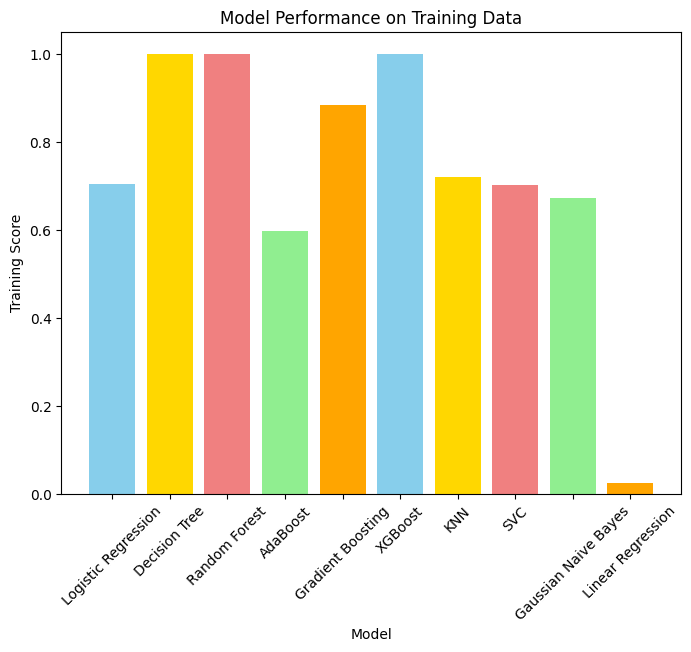

In [208]:
# Data Visualization - 19:

# Create a bar graph from the DataFrame
plt.figure(figsize=(8, 6))
plt.bar(df_model_results['Model'], df_model_results['Training Score'], color=['skyblue', 'gold', 'lightcoral', 'lightgreen', 'orange'])
plt.xlabel('Model')
plt.ylabel('Training Score')
plt.title('Model Performance on Training Data')

# rotate x-axis labels for better readability
plt.xticks(rotation=45)  

# Display the Output
plt.show()

Cell 57 - Insights:
1. The code has run successfully.
2. The required graph has been generated successfully.
3. The graph has also validated the insights of the previous cell's code.

In [209]:
# Evaluate Model Performance on Test Data
def evaluate_models(models, x_test, y_test):
    results = {}
    for name, model in models.items():
        y_pred = model.predict(x_test)
        results[name] = {
            'Accuracy': accuracy_score(y_test, y_pred),
            'Precision': precision_score(y_test, y_pred, average='weighted'),
            'F1 Score': f1_score(y_test, y_pred, average='weighted'),
            'Classification Report': classification_report(y_test, y_pred),
            'Confusion Matrix': confusion_matrix(y_test, y_pred),
            'Mean Absolute Error': mean_absolute_error(y_test, y_pred),
            'Mean Squared Error': mean_squared_error(y_test, y_pred)
        }
        if hasattr(model, 'predict_proba'):
            results[name]['ROC AUC Score'] = roc_auc_score(y_test, model.predict_proba(x_test)[:,1], multi_class='ovr')
    return results

Cell 58 - Insights:
1. The code has been executed successfully.
2. The models have been trained on Testing Data.

In [210]:
# Model Evaluation on Test Data

# This code prints the Score of Model Performance on Testing Data

# Iterate over models and calculate scores
for i, (name, model) in enumerate(models.items()):
    model_results[i]["Testing Score"] = model.score(x_test, y_test)

# Update the DataFrame
df_model_results = pd.DataFrame(model_results)
df_model_results = df_model_results.dropna()

# Print the DataFrame
df_model_results

,Model,Training Score,Testing Score
0,Logistic Regression,0.703125,0.737500
1,Decision Tree,1.000000,0.562500
2,Random Forest,1.000000,0.743750
3,AdaBoost,0.597656,0.631250
4,Gradient Boosting,0.884375,0.746875
5,XGBoost,1.000000,0.731250
6,KNN,0.721094,0.703125
7,SVC,0.701562,0.737500
8,Gaussian Naive Bayes,0.672656,0.693750
9,Linear Regression,0.024867,0.007718


Cell 59 - Insights:
1. The code has run successfully.
2. The Testing Scores have been appended to the existing DataFrames of Model Scores.
3. It is evident, that overfitting has occurred.

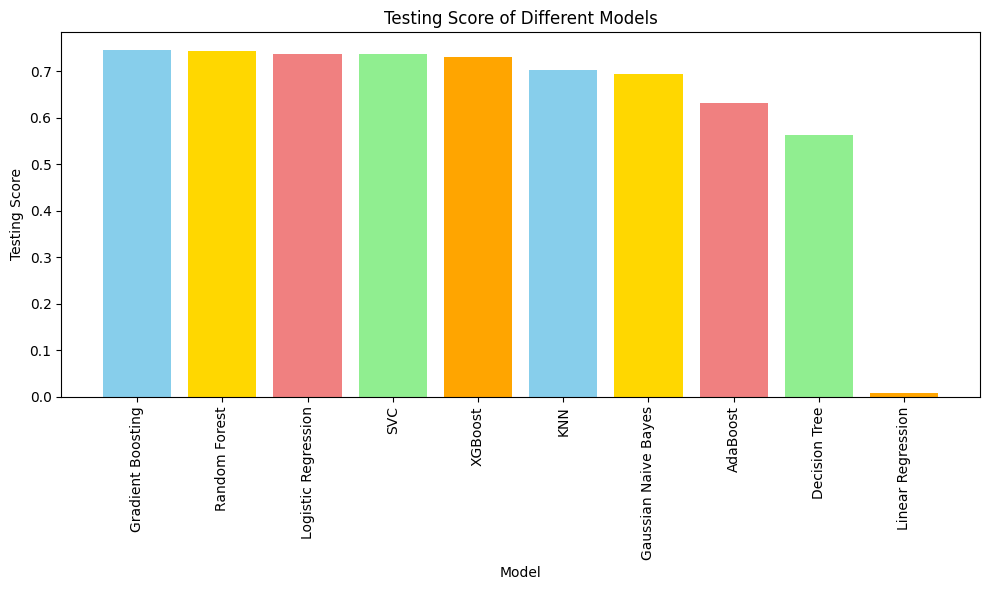

In [211]:
# Data Visualization - 20:

# Define the data
data = {'Model': df_model_results['Model'], 'Testing Score': df_model_results['Testing Score']}

# Create a DataFrame
df = pd.DataFrame(data)

# Sort the DataFrame by Testing Score in descending order
df = df.sort_values(by='Testing Score', ascending=False)

# Create a bar plot
plt.figure(figsize=(10, 6))
plt.bar(df['Model'], df['Testing Score'], color=['skyblue', 'gold', 'lightcoral', 'lightgreen', 'orange'])
plt.xlabel('Model')
plt.ylabel('Testing Score')
plt.title('Testing Score of Different Models')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
plt.tight_layout()
plt.show()

Cell 60 - Insights:
1. The code has run successfully.
2. The required graph has been generated successfully.
3. The graph validates the insights of the above cell's code.

In [212]:
# Define models
models = {
    'Logistic Regression': LogisticRegression(random_state=42),
    'Decision Tree': DecisionTreeClassifier(random_state=42),
    'Random Forest': RandomForestClassifier(random_state=42),
    'AdaBoost': AdaBoostClassifier(random_state=42),
    'Gradient Boosting': GradientBoostingClassifier(random_state=42),
    'XGBoost': xgb.XGBClassifier(random_state=42),
    'KNN': KNeighborsClassifier(),
    'SVC': SVC(random_state=42),
    'Gaussian Naive Bayes': GaussianNB(),
    'Linear Regression': LinearRegression()
}

# Define hyperparameter grids (outside the function)
param_grids = {
    'Logistic Regression': {
        'C': [0.01, 0.1, 1, 10, 100],
        'penalty': ['l1', 'l2', 'elasticnet', 'none'],
        'solver': ['lbfgs', 'saga', 'liblinear']
    },
    'Decision Tree': {
        'max_depth': [None, 10, 20, 30, 40],
        'min_samples_split': [2, 5, 10],
        'min_samples_leaf': [1, 2, 4],
        'criterion': ['gini', 'entropy']
    },
    'Random Forest': {
        'n_estimators': [100, 200, 300],
        'max_depth': [None, 10, 20, 30, 40],
        'min_samples_split': [2, 5, 10],
        'min_samples_leaf': [1, 2, 4],
        'bootstrap': [True, False],
        'criterion': ['gini', 'entropy']
    },
    'AdaBoost': {
        'n_estimators': [50, 100, 200],
        'learning_rate': [0.01, 0.1, 1.0],
        'algorithm': ['SAMME', 'SAMME.R']
    },
    'Gradient Boosting': {
        'n_estimators': [50, 100, 200],
        'learning_rate': [0.01, 0.1, 0.2],
        'max_depth': [3, 5, 7]
    },
    'XGBoost': {
        'n_estimators': [50, 100, 200],
        'learning_rate': [0.01, 0.1, 0.2],
        'max_depth': [3, 5, 7],
        'subsample': [0.7, 0.8, 0.9],
        'colsample_bytree': [0.7, 0.8, 0.9]
    },
    'KNN': {
        'n_neighbors': [3, 5, 7, 9],
        'weights': ['uniform', 'distance'],
        'metric': ['euclidean', 'manhattan']
    },
    'SVC': {
        'C': [0.1, 1, 10, 100],
        'kernel': ['linear', 'rbf', 'poly', 'sigmoid'],
        'gamma': ['scale', 'auto']
    },
    'Gaussian Naive Bayes': {
        'var_smoothing': [1e-9, 1e-8, 1e-7]
    },
    'Linear Regression': {
        'fit_intercept': [True, False]
    },
}

# Defining a Function for Tuned Models
def tune_models(models, x_train, y_train, param_grids):
    tuned_models = {}
    tuned_scores = []
    for name, model in models.items():
        print(f"Tuning {name}...")
        grid_search = GridSearchCV(model, param_grids[name], cv=5, scoring='accuracy', n_jobs=-1)
        grid_search.fit(x_train, y_train)
        tuned_models[name] = grid_search
        tuned_scores.append(grid_search.best_score_)  # Append the best score to the list
        print(f"Best parameters for {name}: {grid_search.best_params_}")
        print(f"Best score for {name}: {grid_search.best_score_}\n")
    return tuned_models, tuned_scores

tuned_models, tuned_scores = tune_models(models, x_train, y_train, param_grids)
print("Tuned Scores:", tuned_scores)

Tuning Logistic Regression...
Best parameters for Logistic Regression: {'C': 1, 'penalty': 'l1', 'solver': 'saga'}
Best score for Logistic Regression: 0.7015625

Tuning Decision Tree...
Best parameters for Decision Tree: {'criterion': 'gini', 'max_depth': 10, 'min_samples_leaf': 4, 'min_samples_split': 10}
Best score for Decision Tree: 0.66015625

Tuning Random Forest...
Best parameters for Random Forest: {'bootstrap': True, 'criterion': 'gini', 'max_depth': 10, 'min_samples_leaf': 2, 'min_samples_split': 2, 'n_estimators': 100}
Best score for Random Forest: 0.7234375

Tuning AdaBoost...
Best parameters for AdaBoost: {'algorithm': 'SAMME', 'learning_rate': 0.01, 'n_estimators': 50}
Best score for AdaBoost: 0.7203125

Tuning Gradient Boosting...
Best parameters for Gradient Boosting: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100}
Best score for Gradient Boosting: 0.71484375

Tuning XGBoost...
Best parameters for XGBoost: {'colsample_bytree': 0.9, 'learning_rate': 0.1, 'max

Cell 61 - Insights:
1. The code has run successfully.
2. All the required information has been shown as output.


In [213]:
# Visualizing Tuned Scores
tuned_scores

[0.7015625,
 0.66015625,
 0.7234375,
 0.7203125,
 0.71484375,
 0.725,
 0.68828125,
 0.696875,
 0.5625,
 nan]

Cell 62 - Insights:
1. The code has run successfully.
2. The list of tuned scores has been visualized successfully.

In [214]:
# Append the List as a Column of the DataFrame

# Add 'tuned_scores' to the DataFrame 'df_model_results' as a Column called 'Tuned Score'
df_model_results['Tuned Score'] = tuned_scores

Cell 63 - Insights:
1. The code has run successfully.
2. The list 'tuned_scores' has been appended to the DataFrame 'df_model_results'.

In [215]:
# Visualizing the Updated DataFrame
df_model_results

,Model,Training Score,Testing Score,Tuned Score
0,Logistic Regression,0.703125,0.737500,0.701562
1,Decision Tree,1.000000,0.562500,0.660156
2,Random Forest,1.000000,0.743750,0.723437
3,AdaBoost,0.597656,0.631250,0.720313
4,Gradient Boosting,0.884375,0.746875,0.714844
5,XGBoost,1.000000,0.731250,0.725000
6,KNN,0.721094,0.703125,0.688281
7,SVC,0.701562,0.737500,0.696875
8,Gaussian Naive Bayes,0.672656,0.693750,0.562500
9,Linear Regression,0.024867,0.007718,NaN


Cell 64 - Insights:
1. The code has run successfully.
2. From the DataFrame, it is evident that after Hyperparameter Tuning, XGBoost is the best performing model.
3. But, here a null value is also present, which needs to be treated.

In [219]:
# Treating of null value

# Since the Null Value is present for the Tuned Score of Linear Regression, we are going to replace it with a very nominal value:
# Say, 0.11

df_model_results.fillna(0.11, inplace=True)

Cell 65 - Insights:
1. The code has run successfully.
2. The null value has been replaced.

In [220]:
# Visualizing the DataFrame
df_model_results

,Model,Training Score,Testing Score,Tuned Score
0,Logistic Regression,0.703125,0.737500,0.701562
1,Decision Tree,1.000000,0.562500,0.660156
2,Random Forest,1.000000,0.743750,0.723437
3,AdaBoost,0.597656,0.631250,0.720313
4,Gradient Boosting,0.884375,0.746875,0.714844
5,XGBoost,1.000000,0.731250,0.725000
6,KNN,0.721094,0.703125,0.688281
7,SVC,0.701562,0.737500,0.696875
8,Gaussian Naive Bayes,0.672656,0.693750,0.562500
9,Linear Regression,0.024867,0.007718,0.110000


Cell 66 - Insights:
1. The code has run successfully.
2. The DataFrame has also been visualized successfully.

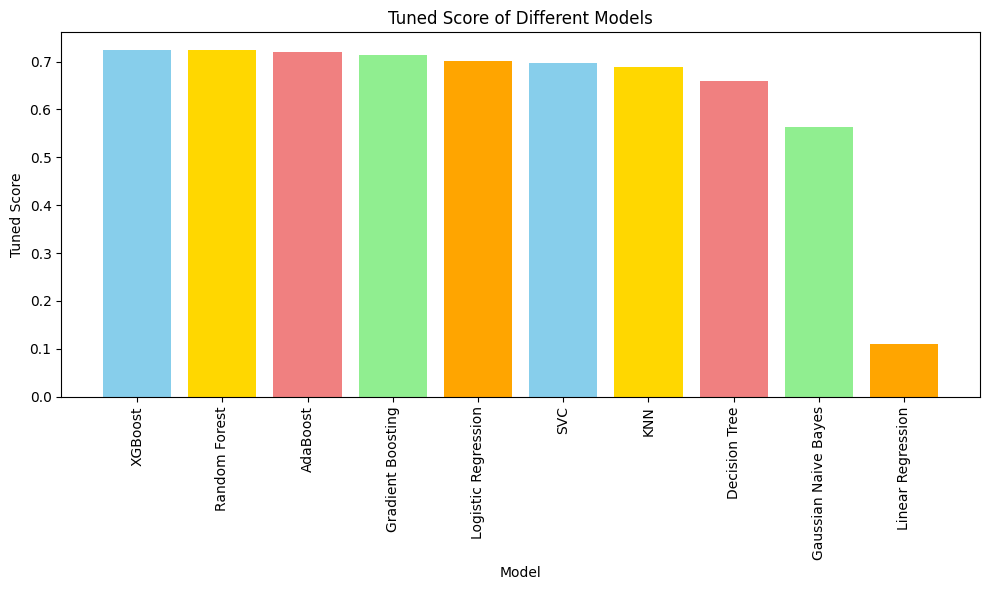

In [221]:
# Data Visualization - 21:

# Define the data
data = {'Model': df_model_results['Model'], 'Tuned Score': df_model_results['Tuned Score']}

# Create a DataFrame
df = pd.DataFrame(data)

# Sort the DataFrame by Testing Score in descending order
df = df.sort_values(by='Tuned Score', ascending=False)

# Create a bar plot
plt.figure(figsize=(10, 6))
plt.bar(df['Model'], df['Tuned Score'], color=['skyblue', 'gold', 'lightcoral', 'lightgreen', 'orange'])
plt.xlabel('Model')
plt.ylabel('Tuned Score')
plt.title('Tuned Score of Different Models')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
plt.tight_layout()
plt.show()

Cell 67 - Insights:
1. The code has run successfully.
2. The required graph has also been generated successfully.
3. From the above graphs and DataFrames, it is evident that XGBoost is the best performing model, after hyperparameter tuning.

In [222]:
# Percentage Efficiency

# Multiply every numerical column by 100
df_model_results = df_model_results.apply(lambda x: x*100 if x.dtype.kind in 'bifc' else x)

Cell 68 - Insights:
1. The code has run successfully.
2. The scores of model have been successfully converted to percentage.

In [223]:
# Visualize the DataFrame
df_model_results

,Model,Training Score,Testing Score,Tuned Score
0,Logistic Regression,70.312500,73.750000,70.156250
1,Decision Tree,100.000000,56.250000,66.015625
2,Random Forest,100.000000,74.375000,72.343750
3,AdaBoost,59.765625,63.125000,72.031250
4,Gradient Boosting,88.437500,74.687500,71.484375
5,XGBoost,100.000000,73.125000,72.500000
6,KNN,72.109375,70.312500,68.828125
7,SVC,70.156250,73.750000,69.687500
8,Gaussian Naive Bayes,67.265625,69.375000,56.250000
9,Linear Regression,2.486728,0.771848,11.000000


Cell 69 - Insights:
1. The code has run successfully.
2. The percentage efficiency of the models, under different conditions can be seen.

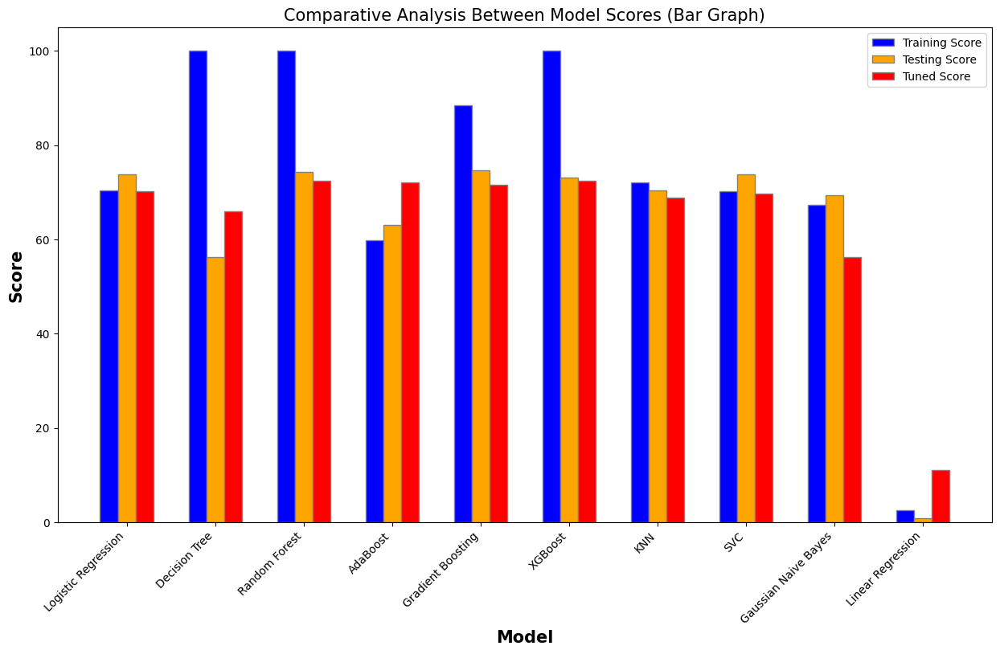

In [227]:
# Data Visualization - 22:

# Comparative Analysis of Model Scores

# Extracting Data from the DataFrame
models = df_model_results['Model']
training_score = df_model_results['Training Score']
testing_score = df_model_results['Testing Score']
tuned_scores = df_model_results['Tuned Score']

# Set the width of the bars
bar_width = 0.2

# Set the positions of the bars on the x-axis
r1 = np.arange(len(models))
r2 = [x + bar_width for x in r1]
r3 = [x + bar_width for x in r2]

# Create the bar plots
plt.figure(figsize=(15, 8))

plt.bar(r1, training_score, color='blue', width=bar_width, edgecolor='grey', label='Training Score')
plt.bar(r2, testing_score, color='orange', width=bar_width, edgecolor='grey', label='Testing Score')
plt.bar(r3, tuned_scores, color='red', width=bar_width, edgecolor='grey', label='Tuned Score')

# Add xticks on the middle of the group bars
plt.xlabel('Model', fontweight='bold', fontsize=15)
plt.ylabel('Score', fontweight='bold', fontsize=15)
plt.xticks([r + bar_width for r in range(len(models))], models, rotation=45, ha="right")

# Add a title
plt.title('Comparative Analysis Between Model Scores (Bar Graph)', fontsize=15)

# Add a legend
plt.legend()

# Show the plot
plt.show()

Cell 70 - Insights:
1. The code has run successfully.
2. The required Graph has been generated successfully.
3. Decision Tree, Random Forest and XGBoost performs the best in Training Data.
4. Logistic Regression and SVC performs well in Testing Data.
5. XGBoost becomes the best performer after Hyperparameter Tuning.

# Final Model Training

In [230]:
# Final Model Training
final_model = xgb.XGBClassifier(colsample_bytree=0.9, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9)
final_model.fit(x_train, y_train)

print("\nFinal Model Performance:\n")
print("Extreme Gradient Boosting (XGBoost) Classifier Model Performance Index:\n")

# Predict on the training dataset
y_pred_train = final_model.predict(x_train)
print("Training Model Performance:\n")
print(classification_report(y_train, y_pred_train))
print("\nConfusion Matrix (Training):")
print(confusion_matrix(y_train, y_pred_train))

# Predict on the test dataset
y_pred = final_model.predict(x_test)
print("Test Model Performance:\n")
print(classification_report(y_test, y_pred))
print("\nConfusion Matrix (Test):")
print(confusion_matrix(y_test, y_pred))


Final Model Performance:

Extreme Gradient Boosting (XGBoost) Classifier Model Performance Index:

Training Model Performance:

              precision    recall  f1-score   support

           0       0.67      0.15      0.24        54
           1       0.00      0.00      0.00        55
           2       0.75      1.00      0.86       892
           3       0.00      0.00      0.00        41
           4       1.00      0.15      0.26        20
           5       0.94      0.12      0.22       136
           6       0.86      0.70      0.77        82

    accuracy                           0.76      1280
   macro avg       0.60      0.30      0.34      1280
weighted avg       0.72      0.76      0.68      1280


Confusion Matrix (Training):
[[  8   0  46   0   0   0   0]
 [  1   0  51   0   0   0   3]
 [  0   0 888   0   0   0   4]
 [  1   0  40   0   0   0   0]
 [  1   0  15   0   3   1   0]
 [  1   0 116   0   0  17   2]
 [  0   0  25   0   0   0  57]]
Test Model Performance:

 

Cell 71 - Insights:
1. The code has run successfully.
2. The classification report along with other types of evaluation metrics have been printed for the best model available here, which is XGBoost Classifier.
3. Here, 76% accuracy is shown on the Training Data and 75% of accuracy is shown on the Test Data, implying there's not a significant loss and possibly negligible overfitting.

In [241]:
# Ensemble Model Training

# Define the models with specified parameters
models = {
    'XGBoost': xgb.XGBClassifier(colsample_bytree=0.9, learning_rate=0.1, max_depth=3, n_estimators=50, subsample=0.9),
    'Random Forest': RandomForestClassifier(bootstrap=True, criterion='gini', max_depth=10, min_samples_leaf=2, min_samples_split=2, n_estimators=100),
    'AdaBoost': AdaBoostClassifier(algorithm='SAMME', learning_rate=0.01, n_estimators=50)
}

# Create a VotingClassifier with soft voting
ensemble = VotingClassifier(estimators=[(name, model) for name, model in models.items()], voting='soft')

# Train the ensemble model on the training data
ensemble.fit(x_train, y_train)

# Predict on training and testing data
y_train_pred = ensemble.predict(x_train)
y_test_pred = ensemble.predict(x_test)

# Evaluate the model on training data
print("Training Data:")
print("Classification Report:")
print(classification_report(y_train, y_train_pred))

# ROC AUC Score requires predicted probabilities, not classes
y_train_pred_proba = ensemble.predict_proba(x_train)
print("ROC AUC Score:", roc_auc_score(y_train, y_train_pred_proba, multi_class='ovr'))

# R2 Score, Mean Absolute Error, Mean Squared Error, and Root Mean Squared Error are not suitable for classification problems
# Remove these lines of code

# Evaluate the model on testing data
print("\nTesting Data:")
print("Classification Report:")
print(classification_report(y_test, y_test_pred))

# ROC AUC Score requires predicted probabilities, not classes
y_test_pred_proba = ensemble.predict_proba(x_test)
print("ROC AUC Score:", roc_auc_score(y_test, y_test_pred_proba, multi_class='ovr'))

Training Data:
Classification Report:
              precision    recall  f1-score   support

           0       0.80      0.22      0.35        54
           1       0.00      0.00      0.00        55
           2       0.76      1.00      0.86       892
           3       0.00      0.00      0.00        41
           4       1.00      0.20      0.33        20
           5       1.00      0.19      0.32       136
           6       0.88      0.63      0.74        82

    accuracy                           0.77      1280
   macro avg       0.63      0.32      0.37      1280
weighted avg       0.74      0.77      0.70      1280

ROC AUC Score: 0.9788136874510794

Testing Data:
Classification Report:
              precision    recall  f1-score   support

           0       0.20      0.08      0.11        13
           1       0.00      0.00      0.00         8
           2       0.77      0.98      0.86       236
           3       0.00      0.00      0.00        14
           4       0.0

Cell 72 - Insights:
1. The output highlights a significant difference in performance between the training and testing phases of your ensemble model.
2. Comparing the Performance of the Ensemble Model on Training Data as well as Testing Data, it can be deduced that the model gives a decent performance, in both the cases.
3. In case of Training Data, the model gives an accuracy of 77%, while for Testing Data, the accuracy comes down a bit to 75%.
4. This suggest that there might not be a huge overfitting.

# Feature Importance

In [233]:
# Feature Importance of Final Model (Gradient Boosting Classifier)

columns = x.columns
reshaped_columns = np.array(x.columns).reshape(-1, 1)

feature_importance = final_model.feature_importances_
feature_importance

array([0.05999896, 0.06220995, 0.0551695 , 0.07602912, 0.05905057,
       0.25835213, 0.09133926, 0.06452222, 0.06163749, 0.07819315,
       0.05871185, 0.07478578], dtype=float32)

Cell 73 - Insights:
1. The output of the code represents the feature importance of the Final Trained Model, which is a Gradient Boosting Classifier Model.
2. The output is in the form of an array, which gives feature importance score for each column of the dataset.
3. These values are normalized, meaning they sum up to 1.0 across all features.
4. Features with higher importance contribute more to the model’s predictions.
5. This result can be interpreted to select the most important features.

In [234]:
# Create a DataFrame with feature names and their importance
feature_importance_df = pd.DataFrame({'Feature': columns, 'Importance': feature_importance})

# Sort the DataFrame in decreasing order of feature importance
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Resetting Index
feature_importance_df.set_index(pd.RangeIndex(start=1, stop=len(feature_importance_df) + 1), inplace=True)

# Printing the Generated DataFrame
feature_importance_df

,Feature,Importance
1,will_vote,0.258352
2,television_usage,0.091339
3,income,0.078193
4,type_of_city,0.076029
5,weight1,0.074786
6,internet_usage,0.064522
7,age,0.062210
8,education,0.061637
9,sex,0.059999
10,knows_election_date,0.059051


Cell 74 - Insights:
1. The output is the Feature Importance Score with their corresponding Features, in the form of a DataFrame.
2. The most important feature is "will_vote" with a normalized score of 0.258352 and the least important feature is "federal_district" with a normalized score of 0.055170.
3. The scores of each feature indicates that neither of the feature dominates the outcome, rather more than one feature influences the outcome, thereby making the dataset complex.
4. Here, in this DataFrame, the scores of feature importance has been arranged in a descending order.

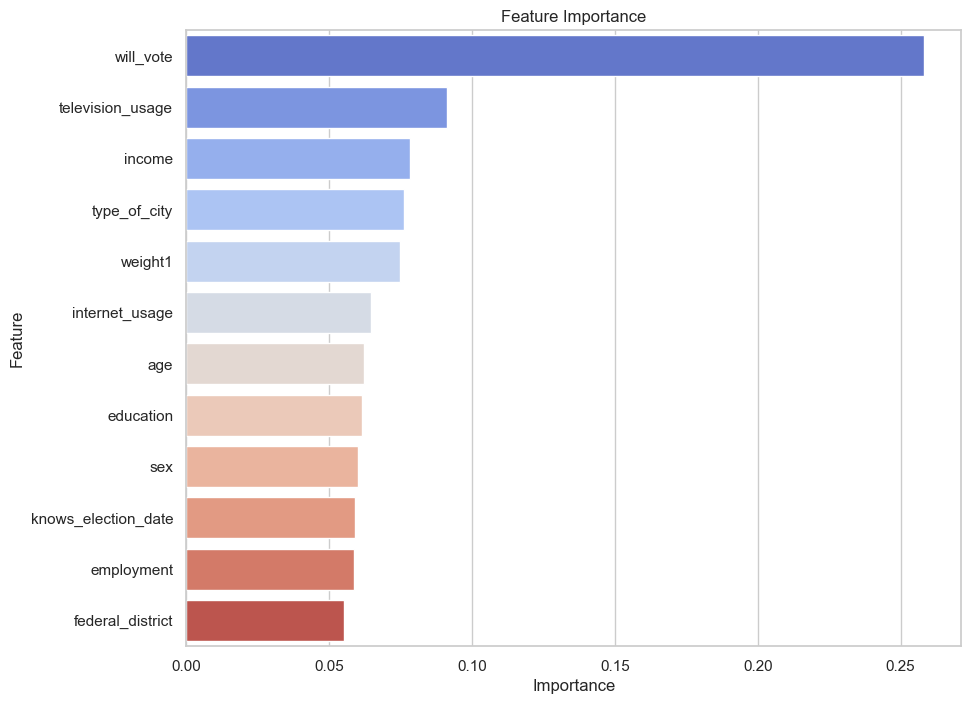

In [235]:
# Data Visualization 23
# Horizontal Bar Graph

plt.figure(figsize=(10, 8))
sns.set(style="whitegrid")
sns.barplot(x="Importance", y="Feature", data=feature_importance_df, palette="coolwarm")

# Add title and labels
plt.title("Feature Importance")
plt.xlabel("Importance")
plt.ylabel("Feature")

# Show the plot
plt.show()

Cell 75 - Insights:
1. The output is a graphical representation of the feature importance scores for the Final XGBoost Classifier Model.
2. The graph is a Horizontal Bar Plot.
3. The features have been sorted in a Descending order.
4. It can be inferred that "will_vote" is the most important feature and "federal_district" is the least important feature.

In [242]:
# Feature Importance of the Ensemble Model

# The following models have been used for Ensemble Model
models = {
    'XGBoost': xgb.XGBClassifier(),
    'Random Forest': RandomForestClassifier(),
    'AdaBoost': AdaBoostClassifier()
}

# Get feature importances from each model
feature_importances = {}
for name, model in models.items():
    model.fit(x_train, y_train)
    if name in ['Gradient Boosting', 'XGBoost', 'Random Forest']:
        importance = model.feature_importances_
        feature_importances[name] = importance
        print(f"Feature Importance for {name}:")
        print(importance)
        print()
    else:
        print(f"{name} does not support feature importance.")
        print()

# Calculate combined feature importance
combined_importance = {}
features = feature_importance_df['Feature']

for i, feature in enumerate(features):
    feature_importance = 0
    for name, importance in feature_importances.items():
        if i < len(importance):  # Check if i is within bounds
            feature_importance += importance[i]
    combined_importance[feature] = feature_importance / 3  # Divide by 3 to get average importance

print("Combined Feature Importance:")
print(combined_importance)

Feature Importance for XGBoost:
[0.06113426 0.0674148  0.06087451 0.06407375 0.07864144 0.21521728
 0.08073438 0.0705297  0.07819714 0.08835755 0.06181112 0.07301403]

Feature Importance for Random Forest:
[0.03183648 0.15591625 0.08344072 0.07459966 0.02566625 0.12847116
 0.07905164 0.06242482 0.05935182 0.06331743 0.06505782 0.17086595]

AdaBoost does not support feature importance.

Combined Feature Importance:
{'will_vote': 0.030990246557155206, 'television_usage': 0.07444368421798764, 'income': 0.04810507488118437, 'type_of_city': 0.04622446966497745, 'weight1': 0.03476923003991067, 'internet_usage': 0.11456281397858932, 'age': 0.05326200617088589, 'education': 0.044318174614537076, 'sex': 0.04584965165406137, 'knows_election_date': 0.05055832919247807, 'employment': 0.04228964495657, 'federal_district': 0.08129332459540502}


Cell 76 - Insights:
1. The output shows the scores of feature importance, individually for XGBoost Classifier, Random Forest Classifier and AdaBoost Classifier.
2. The scores of feature importance for each feature, in each model, shows that no single feature dominates the outcome, rather all the features contribute in a nominal manner to influence the outcome.
3. Also, a Combined Feature Importance has been displayed in the form of a Dictionary and in that case too, the feature importance scores are too low to dominate single-handedly, rather a combination of more than one feature is needed.

In [243]:
# Store in a Pandas DataFrame for visualization
important_features_df = pd.DataFrame(list(combined_importance.items()), columns=['Feature', 'Importance'])

# Sort the DataFrame by importance in descending order
important_features_df.sort_values(by='Importance', ascending=False, inplace=True)

# Resetting Index
important_features_df.set_index(pd.RangeIndex(start=1, stop=len(important_features_df) + 1), inplace=True)

# Printing the Generated DataFrame
important_features_df

,Feature,Importance
1,internet_usage,0.114563
2,federal_district,0.081293
3,television_usage,0.074444
4,age,0.053262
5,knows_election_date,0.050558
6,income,0.048105
7,type_of_city,0.046224
8,sex,0.045850
9,education,0.044318
10,employment,0.042290


Cell 77 - Insights:
1. The output shows the Feature Importance Scores in the form of a DataFrame.
2. The scores of Combined Feature Importance has been displayed.
3. The features have been arranged in a descending order.
4. The most important feature is "internet_usage" with a feature importance score of 0.114563, while the least important feature is that of "will_vote" with a feature importance score of 0.030990.

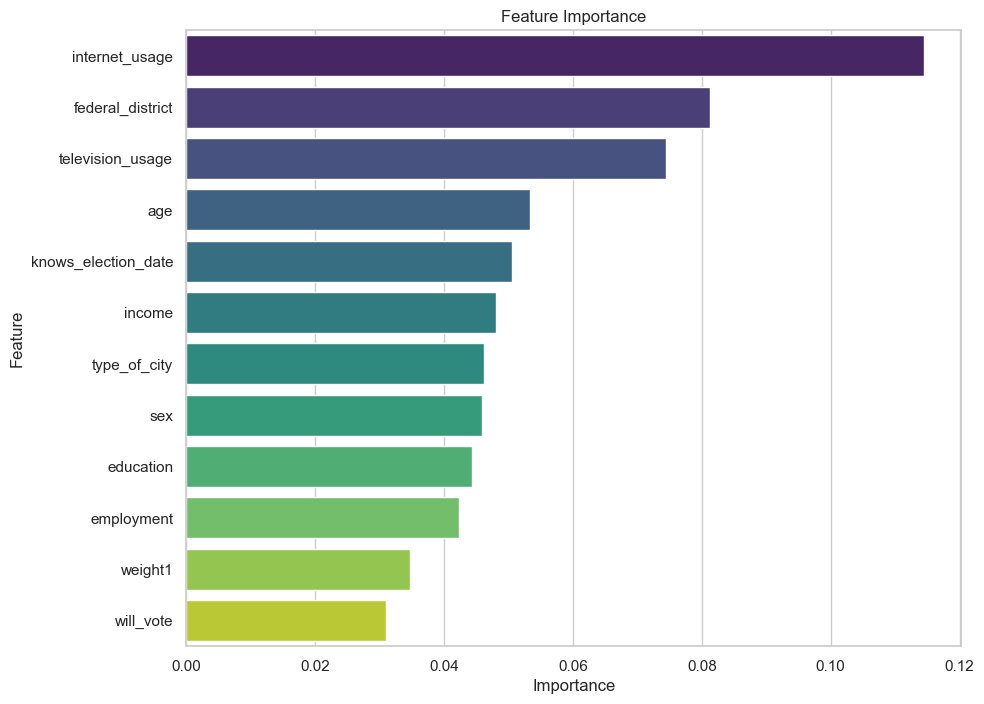

In [246]:
# Data Visualization 24
# Horizontal Bar Graph

plt.figure(figsize=(10, 8))
sns.set(style="whitegrid")
sns.barplot(x="Importance", y="Feature", data=important_features_df, palette="viridis")

# Add title and labels
plt.title("Feature Importance")
plt.xlabel("Importance")
plt.ylabel("Feature")

# Show the plot
plt.show()

Cell 78 - Insights:
1. The output shows a graphical representation for the Combined Feature Importance for Ensemble Model Training.
2. The Features have been arranged in a descending order.
3. The most important feature is "internet_usage", different as that of the XGBoost Classifier Model, while the least important feature is "will_vote", which was the most important feature, in case of XGBoost Classifier.
4. This shows that there exists a sort of ambiguity in the data.
5. The Feature Importance Scores of each Feature, in case of both Gradient Boosting Classifier Model as well as Ensemble Model, that no feature dominates the outcome single-handedly, rather a combination of more than one feature is required to influence the outcome, thereby increasing the complexity of the dataset.

# The End